In [ ]:
import torch
import torch.nn as nn
from torchvision import transforms, utils
from torch.utils.data import DataLoader, Dataset
import os
import pandas as pd
import numpy as np
from PIL import Image, ImageOps
from tqdm import tqdm
from tqdm import trange
from torch.optim import Adam
from torch.nn import DataParallel
from torch.optim.lr_scheduler import MultiStepLR as Scheduler

from pycocotools.coco import COCO
import numpy as np
import skimage.io as io
import random
import cv2

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns

from collections import Counter
from scipy.ndimage.measurements import center_of_mass as cm
from scipy.special import expit
from collections import Counter

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

def create_mask(coco, anns, height, width):
    mask = np.zeros((height, width))
    for i in range(len(anns)):
        mask = np.maximum(coco.annToMask(anns[i])*(i+1), mask) #*255.0
    # mask = np.maximum(coco.annToMask(anns[0]), mask) #*255.0
    return np.array(mask)

def create_mask_3d(coco, anns, height, width):
    mask = np.zeros((height, width))
    # for i in range(len(anns)):
        # mask = np.maximum(coco.annToMask(anns[i])*(i+1), mask) #*255.0
    mask = np.maximum(coco.annToMask(anns[0]), mask) * 255
    mask = mask.reshape((height, width,1))
    mask = np.repeat(mask,3,axis=2)
    return np.array(mask)

Mounted at /gdrive


In [ ]:
def get_tri(s, coef, ct=0, flag=0):
    approx = cv2.approxPolyDP(s, coef, True)
    edge = len(approx)
    if ct == 500:
        return approx
    if edge > 3:
        if flag == -1:
            return approx
        return get_tri(s, coef * 2, ct+1, 1)
    elif edge < 3:
        if flag == 1:
            return approx
        return get_tri(s, coef / 2, ct+1, -1)
    else:
        return approx

def get_init_dir(pt, mc):
    x1, y1 = pt
    x2, y2 = mc
    dx = np.sign(x2-x1)
    dy = np.sign(y2-y1)
    directions = [[-1,-1],[-1,0],[-1,1],[0,1],[1,1],[1,0],[1,-1],[0,-1]]
    if dx == 0 and dy == 0:
        return np.random.randint(0,8,1)[0]
    dir = directions.index([dx, dy])
    return dir

def get_init_pt(pt, mc, mask, r = 0.8, ct = 0):
    # if mask[pt[0],pt[1]] == 1:
    #     return pt
    # else:
    #     pt = r * pt + (1-r) * mc
    #     pt = pt.astype(int)
    #     return get_init_pt(pt, mc, mask, r-0.05)
    if ct == 17:
        return np.array([-1,-1]).astype(int)
    pt = r * pt + (1-r) * mc
    pt = pt.astype(int)
    if mask[pt[0],pt[1]] == 1:
        return pt
    else:     
        return get_init_pt(pt, mc, mask, r-0.05, ct+1)


def draw_random(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        size = np.sum(mask)
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            poly = get_tri(s, 10)
            # print(poly)
            length = 0
            for j in range(len(poly)):
                start_pt = np.array([poly[j][0][1],poly[j][0][0]]).astype(int)
                mc = np.array(cm(mask)).astype(int)
                # print(mc, start_pt)
                
                pt = get_init_pt(start_pt, mc, mask)
                if pt[0] == -1:
                    continue
                
                # print(mask[pt[0],pt[1]])
                
                dir = get_init_dir(pt, mc)
                # print(mc, pt, dir)
                pts, ran = go(mask, dir, pt)
                length += len(pts)
                for pt in pts:
                    x, y = pt
                    bg[x-3:x+3,y-3:y+3] = 1
                    mask[x,y] = -1
                if(length > 0.001 * size):
                    break
        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(int).flatten())
    t = t.reshape((height, width)) 
    return t

def draw_result_random(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = draw_random(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

# to show example, useless when generating annotation
def draw_sample_random(coco, img, img_pos):
    # graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = io.imread(r'{}/{}'.format(img_pos, img['file_name']))
    graph = draw_result_random(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    # graph = draw_result_tri(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

def get_distance(mask, dir, pt):
    # assert(mask[pt[0]][pt[1]] == 1)
    dis = 0
    maxx, maxy = mask.shape
    directions = np.array([[-1,-1],[-1,0],[-1,1],[0,1],[1,1],[1,0],[1,-1],[0,-1]])
    d = directions[dir]
    while 1:
        pt = pt + d
        dis += 1
        if pt[0] == 0 or pt[0] == maxx or pt[1] == 0 or pt[1] == maxy:
            break
        if mask[pt[0]][pt[1]] != 1:
            if mask[pt[0]][pt[1]] == -1:
                dis = dis / 5
            break
    return dis

def alter_8(num):
    if num > 7:
        num = num - 8
    if num < 0:
        num = num + 8
    return num

def three_distance(mask, dir, pt):
    dis = get_distance(mask, dir, pt)
    l_dis = get_distance(mask, alter_8(dir-2), pt)
    r_dis = get_distance(mask, alter_8(dir+2), pt)
    return dis, l_dis, r_dis

def get_direction(mask, dir, pt, current_dis):
    x = -5
    dis, l_dis, r_dis = three_distance(mask, dir, pt)
    if np.max([dis, l_dis, r_dis]) < np.max([0.1*current_dis,2]):
        return -1, -5
    if dis < np.max([0.1 * current_dis, 2]):
        if l_dis > r_dis:
            dir = alter_8(dir-2)
        else:
            dir = alter_8(dir+2)
    else:
        lr_ratio = np.log(l_dis / float(r_dis))
        dir = alter_8(dir - int(lr_ratio))
        x = int(lr_ratio)
    return dir, x

def go(mask, dir, pt):
    current_dis = 0
    ran = []
    directions = np.array([[-1,-1],[-1,0],[-1,1],[0,1],[1,1],[1,0],[1,-1],[0,-1]])
    pts = [pt]
    while 1:
        dir, rand = get_direction(mask, dir, pt, current_dis)
        ran.append(rand)
        if dir == -1:
            return pts, ran
        mask[pt[0]][pt[1]] = -1
        pt = pt + directions[dir]
        if mask[pt[0]][pt[1]] == 0:
            return pts, ran
        pts.append(pt)
        current_dis += 1

In [ ]:
dataDir = '/gdrive/My Drive/anno'
coco_train = COCO('{}/instances_train2017.json'.format(dataDir))
#ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
ori = np.load(r'/gdrive/My Drive/anno/scribble.npy', allow_pickle=True)

loading annotations into memory...
Done (t=40.73s)
creating index...
index created!


In [ ]:
catIDs = coco_train.getCatIds()
print(catIDs)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 67, 70, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 84, 85, 86, 87, 88, 89, 90]


In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/scribble.npy', allow_pickle=True)

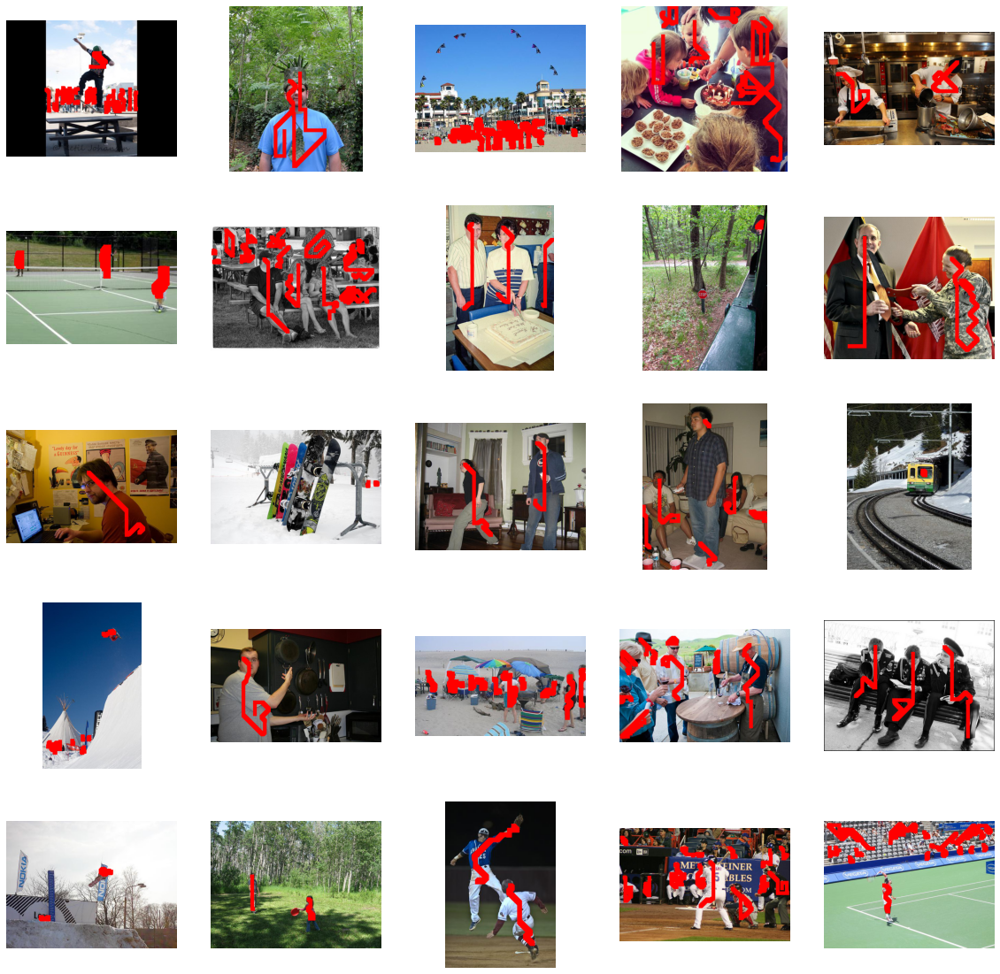

In [ ]:
plt.figure(figsize=(20,20))
for i in range(25):
    plt.subplot(5,5,i+1)
    draw_sample_random(coco_train, ori[i], r'/gdrive/My Drive/anno/scribble_sample')

In [ ]:
qq = draw_random(coco_train, anns, height, width)

000000262242.jpg


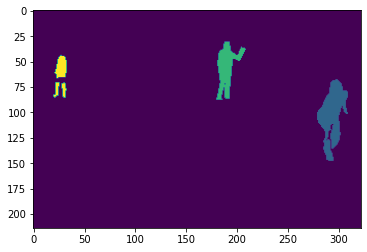

In [ ]:
img = ori[5]
print(img['file_name'])
height, width = img['height'], img['width']
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
mask = create_mask(coco_train, anns, height, width)
plt.imshow(mask)

In [ ]:
bg = np.zeros((height, width))
for i in range(3):
    mask = coco_train.annToMask(anns[i])
    print(np.sum(mask))
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    print(len(ct))

1202
3
710
2
296
3


In [ ]:
qq = draw_random(coco_train, anns, height, width)

[252  85] [ 75 101] 6
[277 385] [136 409] 6
[257 238] [ 89 220] 4


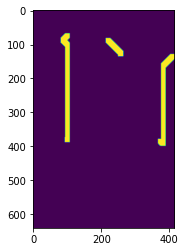

In [ ]:
plt.imshow(qq)

3


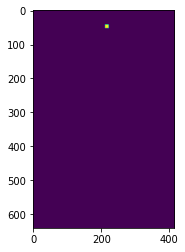

In [ ]:
i = 2
bg = np.zeros((height, width))
mask = coco_train.annToMask(anns[i])
x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
s = ct[0]
poly = get_tri(s, 10)
# print(poly)
start_pt = np.array([poly[0][0][1],poly[0][0][0]]).astype(int)
mc = np.array(cm(mask)).astype(int)
# print(mc, start_pt)

pt = get_init_pt(start_pt, mc, mask)
# print(mask[pt[0],pt[1]])

dir = get_init_dir(pt, mc)
pts, ran = go(mask, dir, pt)
print(len(pts))
for pt in pts:
    x, y = pt[0], pt[1]
    bg[x-5:x+5,y-5:y+5] = 1
# im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
plt.imshow(bg)

In [ ]:
print(dir,mc,pt)

4 [257 238] [ 48 217]


In [ ]:
print(len(pts),pts)

3 [array([ 47, 216]), array([ 48, 216]), array([ 48, 217])]


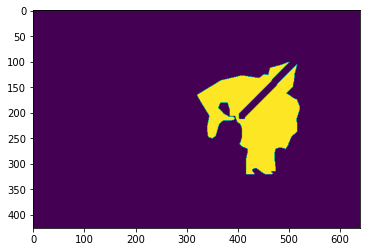

In [ ]:
mask_new = mask.copy()
c = 0
for i in pts:
    x, y = i[0], i[1]
    mask_new[x-5:x+5,y-5:y+5]=0
plt.imshow(mask_new)

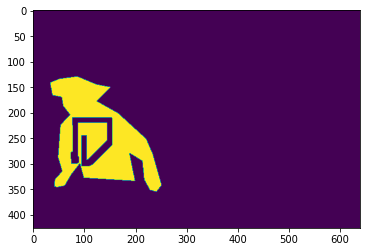

In [ ]:
mask_new = mask_ori.copy()
c = 0
for i in cur:
    x, y = i[0], i[1]
    mask_new[x-5:x+5,y-5:y+5]=0
plt.imshow(mask_new)


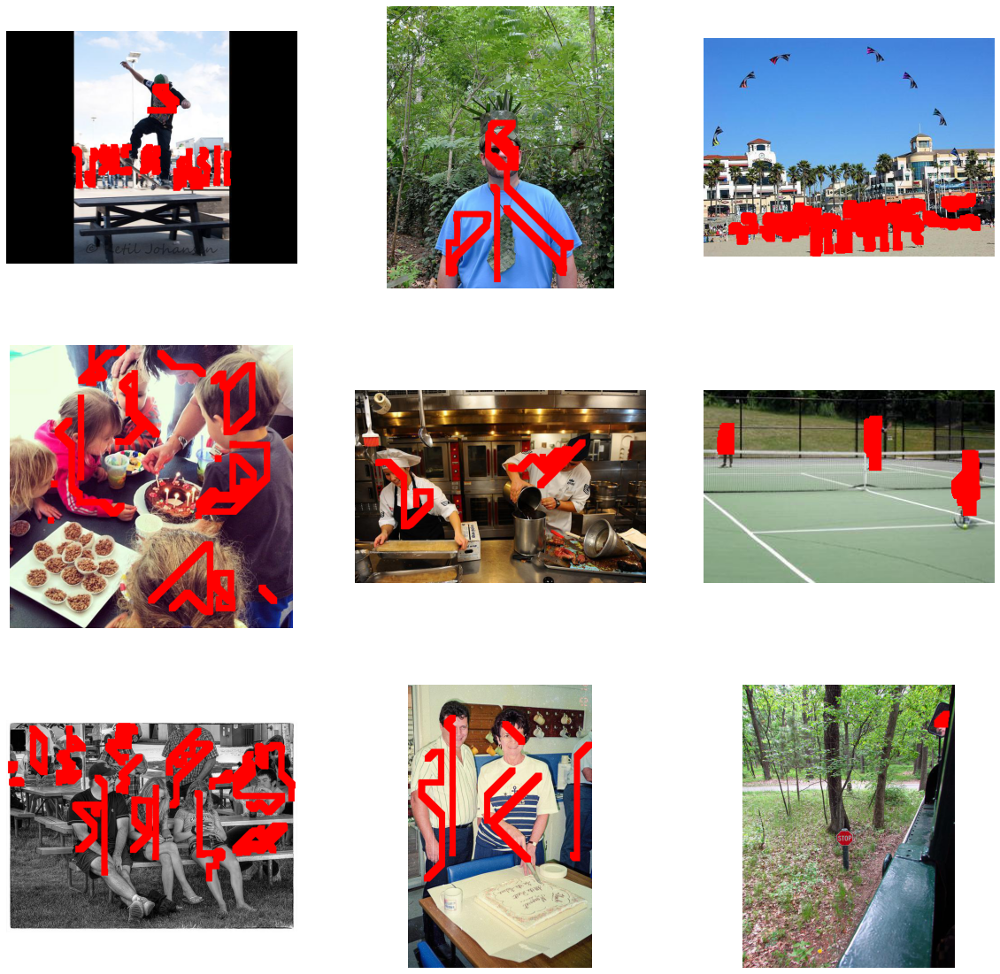

In [ ]:
#0.01
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_random(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

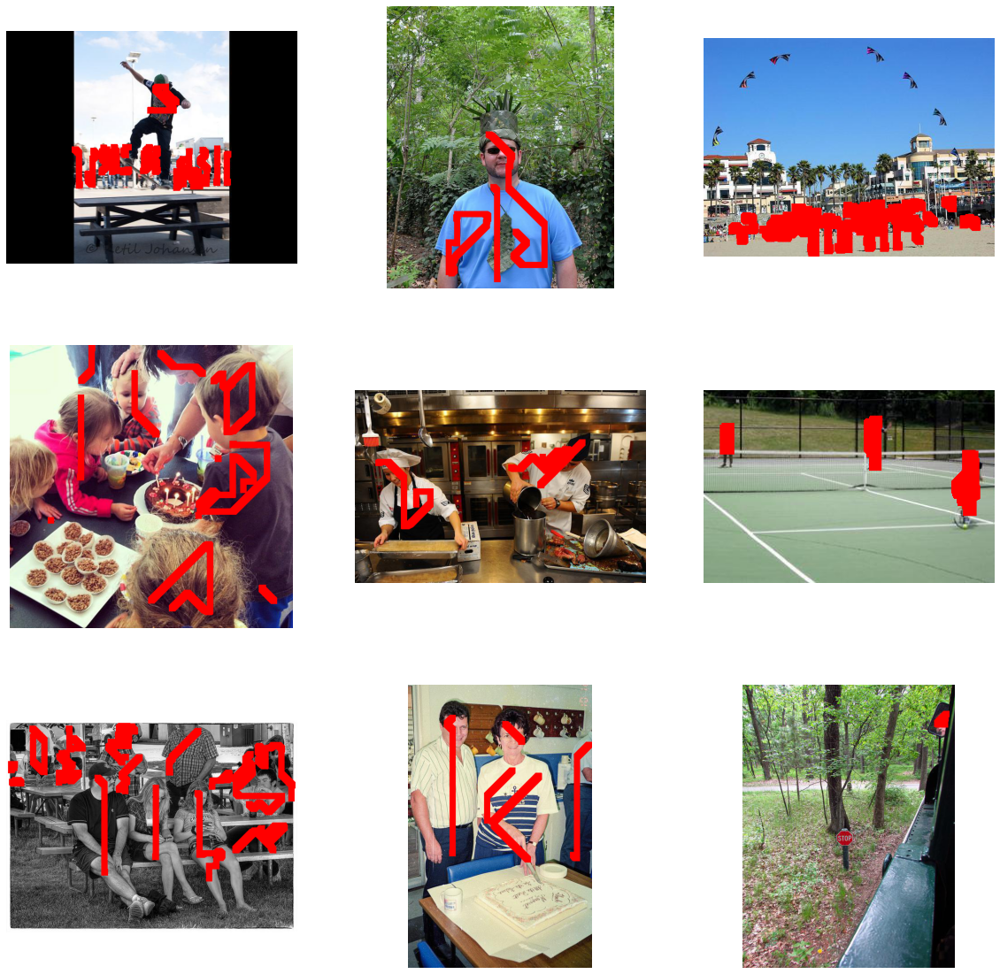

In [ ]:
#0.004
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_random(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

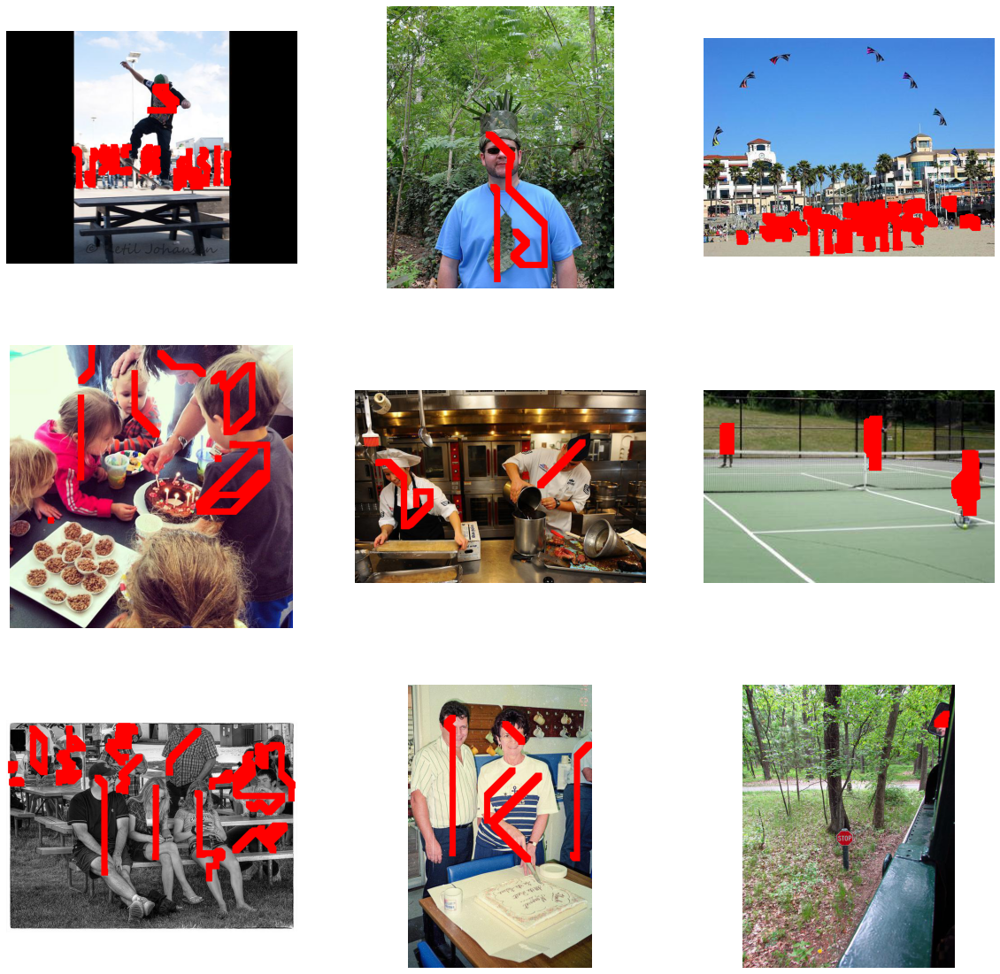

In [ ]:
#0.001
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_random(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

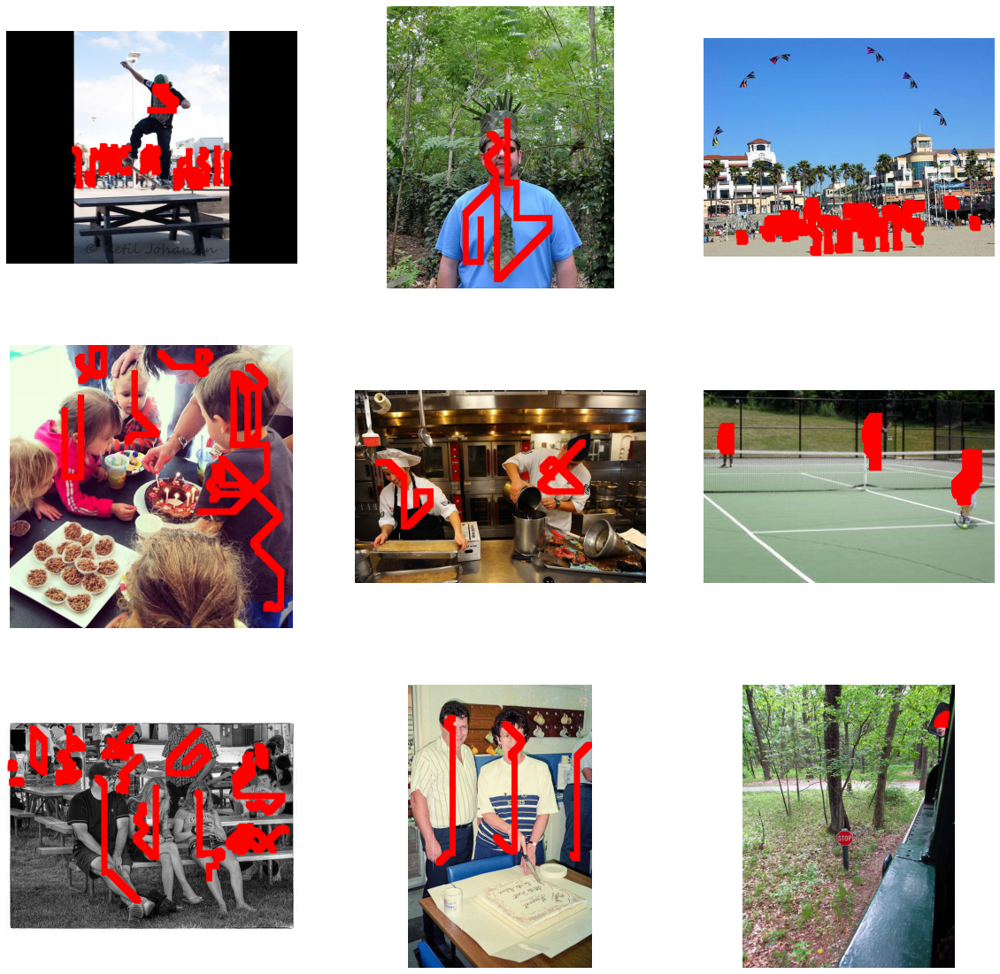

In [ ]:
#0.001 dis*5
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_random(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

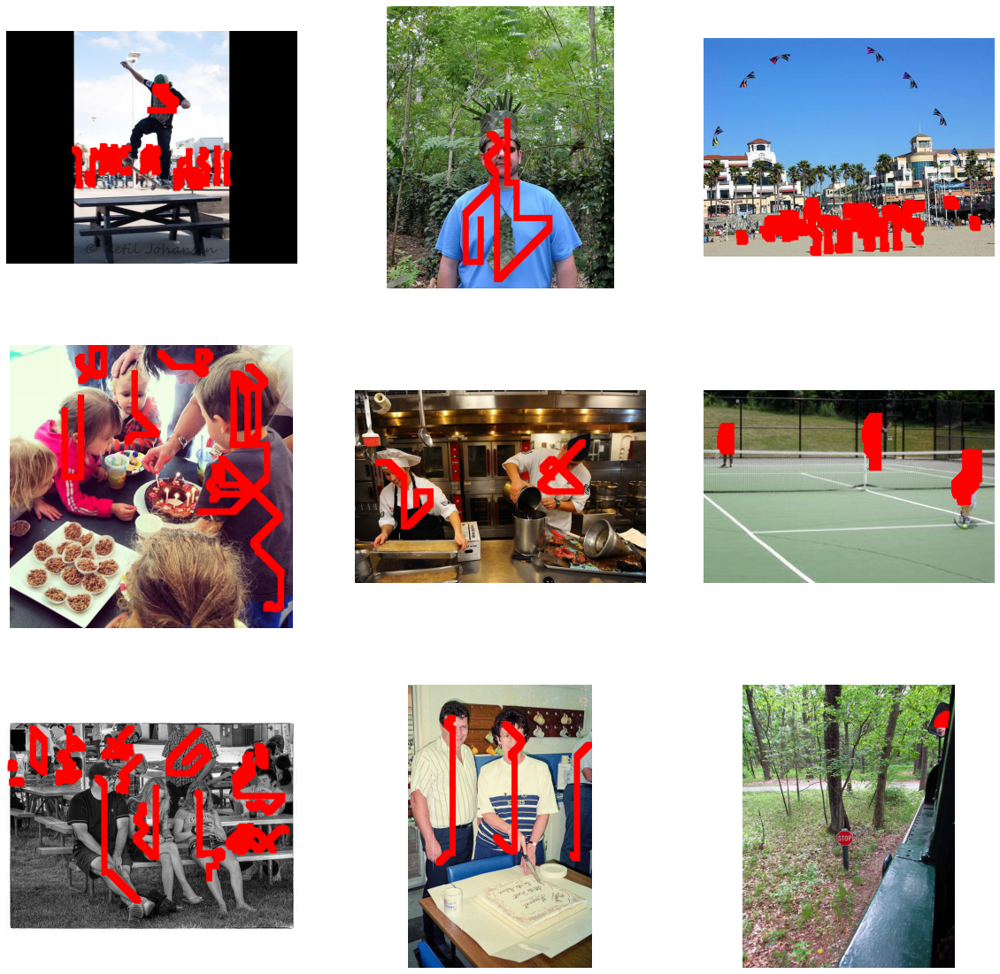

In [ ]:
#0.001 dis/5
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_random(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

In [ ]:
def get_tri(s, coef, ct=0, flag=0):
    approx = cv2.approxPolyDP(s, coef, True)
    edge = len(approx)
    if ct == 500:
        return approx
    if edge > 3:
        if flag == -1:
            return approx
        return get_tri(s, coef * 2, ct+1, 1)
    elif edge < 3:
        if flag == 1:
            return approx
        return get_tri(s, coef / 2, ct+1, -1)
    else:
        return approx

def get_init_dir(pt, mc):
    x1, y1 = pt
    x2, y2 = mc
    dx = np.sign(x2-x1)
    dy = np.sign(y2-y1)
    directions = [[-1,-1],[-1,0],[-1,1],[0,1],[1,1],[1,0],[1,-1],[0,-1]]
    dir = directions.index([dx, dy])
    return dir

def get_init_pt(pt, mc, mask, r = 0.8, ct = 0):
    # if mask[pt[0],pt[1]] == 1:
    #     return pt
    # else:
    #     pt = r * pt + (1-r) * mc
    #     pt = pt.astype(int)
    #     return get_init_pt(pt, mc, mask, r-0.05)
    if ct == 17:
        return np.array([-1,-1]).astype(int)
    pt = r * pt + (1-r) * mc
    pt = pt.astype(int)
    if mask[pt[0],pt[1]] == 1:
        return pt
    else:     
        return get_init_pt(pt, mc, mask, r-0.05, ct+1)


def draw_random(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        size = np.sum(mask)
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            poly = get_tri(s, 10)
            # print(poly)
            length = 0
            for j in range(len(poly)):
                start_pt = np.array([poly[j][0][1],poly[j][0][0]]).astype(int)
                mc = np.array(cm(mask)).astype(int)
                # print(mc, start_pt)
                
                pt = get_init_pt(start_pt, mc, mask)
                if pt[0] == -1:
                    continue
                
                # print(mask[pt[0],pt[1]])
                
                dir = get_init_dir(pt, mc)
                # print(mc, pt, dir)
                pts, ran = go(mask, dir, pt)
                length += len(pts)
                for pt in pts:
                    x, y = pt
                    bg[x-3:x+3,y-3:y+3] = 1
                    mask[x,y] = -1
                if(length > 0.001 * size):
                    break
        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(int).flatten())
    t = t.reshape((height, width)) 
    return t

def draw_result_random(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = draw_random(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

# to show example, useless when generating annotation
def draw_sample_random(coco, img, img_pos):
    # graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = io.imread(r'{}/{}'.format(img_pos, img['file_name']))
    graph = draw_result_random(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    # graph = draw_result_tri(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

In [ ]:
def get_distance(mask, dir, pt):
    # assert(mask[pt[0]][pt[1]] == 1)
    dis = 0
    maxx, maxy = mask.shape
    directions = np.array([[-1,-1],[-1,0],[-1,1],[0,1],[1,1],[1,0],[1,-1],[0,-1]])
    d = directions[dir]
    while 1:
        pt = pt + d
        dis += 1
        if pt[0] == 0 or pt[0] == maxx or pt[1] == 0 or pt[1] == maxy:
            break
        if mask[pt[0]][pt[1]] != 1:
            if mask[pt[0]][pt[1]] == -1:
                dis = dis / 5
            break
    return dis

def alter_8(num):
    if num > 7:
        num = num - 8
    if num < 0:
        num = num + 8
    return num

def three_distance(mask, dir, pt):
    dis = get_distance(mask, dir, pt)
    l_dis = get_distance(mask, alter_8(dir-2), pt)
    r_dis = get_distance(mask, alter_8(dir+2), pt)
    return dis, l_dis, r_dis

def get_direction(mask, dir, pt, current_dis):
    x = -5
    dis, l_dis, r_dis = three_distance(mask, dir, pt)
    if np.max([dis, l_dis, r_dis]) < np.max([0.1*current_dis,2]):
        return -1, -5
    if dis < np.max([0.1 * current_dis, 2]):
        if l_dis > r_dis:
            dir = alter_8(dir-2)
        else:
            dir = alter_8(dir+2)
    else:
        lr_ratio = np.log(l_dis / float(r_dis))
        dir = alter_8(dir - int(lr_ratio))
        x = int(lr_ratio)
    return dir, x

def go(mask, dir, pt):
    current_dis = 0
    ran = []
    directions = np.array([[-1,-1],[-1,0],[-1,1],[0,1],[1,1],[1,0],[1,-1],[0,-1]])
    pts = [pt]
    while 1:
        dir, rand = get_direction(mask, dir, pt, current_dis)
        ran.append(rand)
        if dir == -1:
            return pts, ran
        mask[pt[0]][pt[1]] = -1
        pt = pt + directions[dir]
        if mask[pt[0]][pt[1]] == 0:
            return pts, ran
        pts.append(pt)
        current_dis += 1

In [ ]:
pt = np.array([250, 150])
print(mask[pt[0]][pt[1]])
directions = np.array([[-1,-1],[-1,0],[-1,1],[0,1],[1,1],[1,0],[1,-1],[0,-1]])
d = directions[1]
num = 0
while 1:
    pt = pt + d
    num += 1
    if pt[0] == 0 or pt[0] == maxx or pt[1] == 0 or pt[1] == maxy:
        break
    if mask[pt[0]][pt[1]] == 0:
        break
print(num)


1.0
58


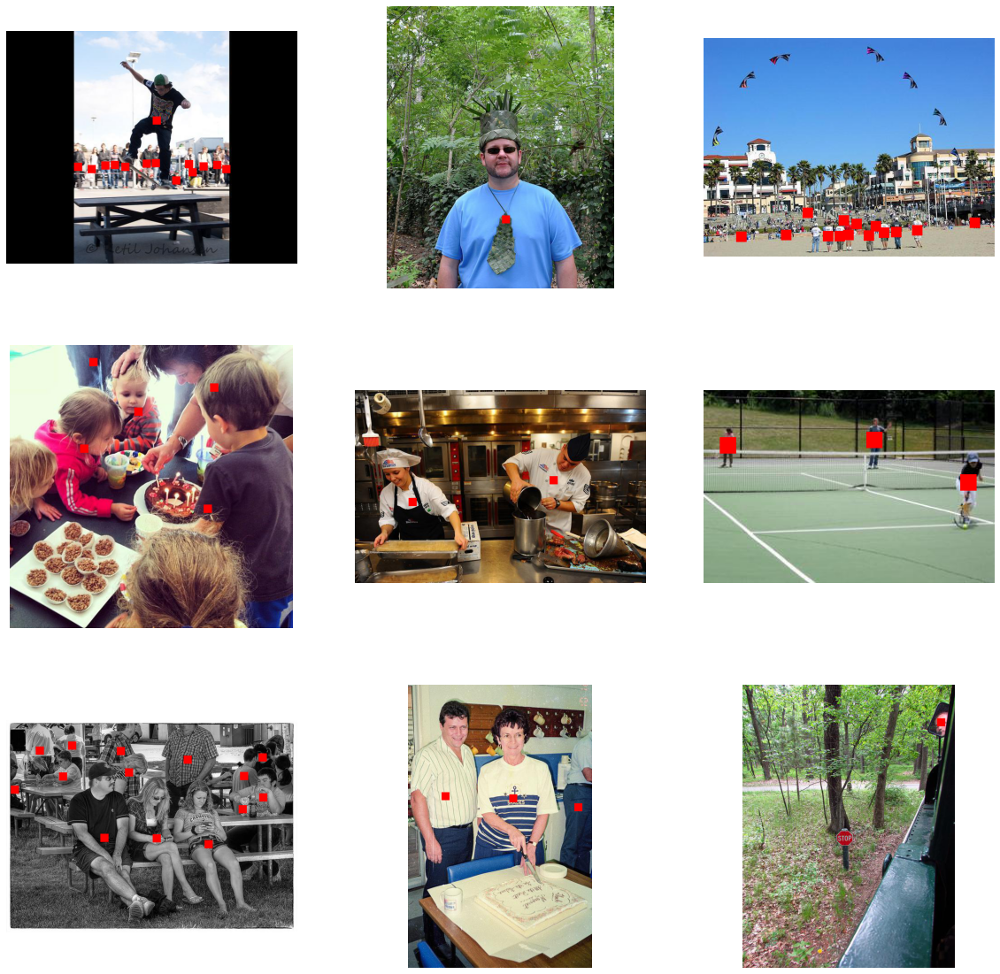

In [ ]:
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_dot(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

In [ ]:
def draw_dot(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        mc = np.array(cm(mask)).astype(int)
        x, y = mc
        bg[x-5:x+5,y-5:y+5] = 1
        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(int).flatten())
    t = t.reshape((height, width)) 
    return t

def draw_result_dot(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = draw_dot(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

# to show example, useless when generating annotation
def draw_sample_dot(coco, img, img_pos):
    # graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = io.imread(r'{}/{}'.format(img_pos, img['file_name']))
    graph = draw_result_dot(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    # graph = draw_result_tri(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

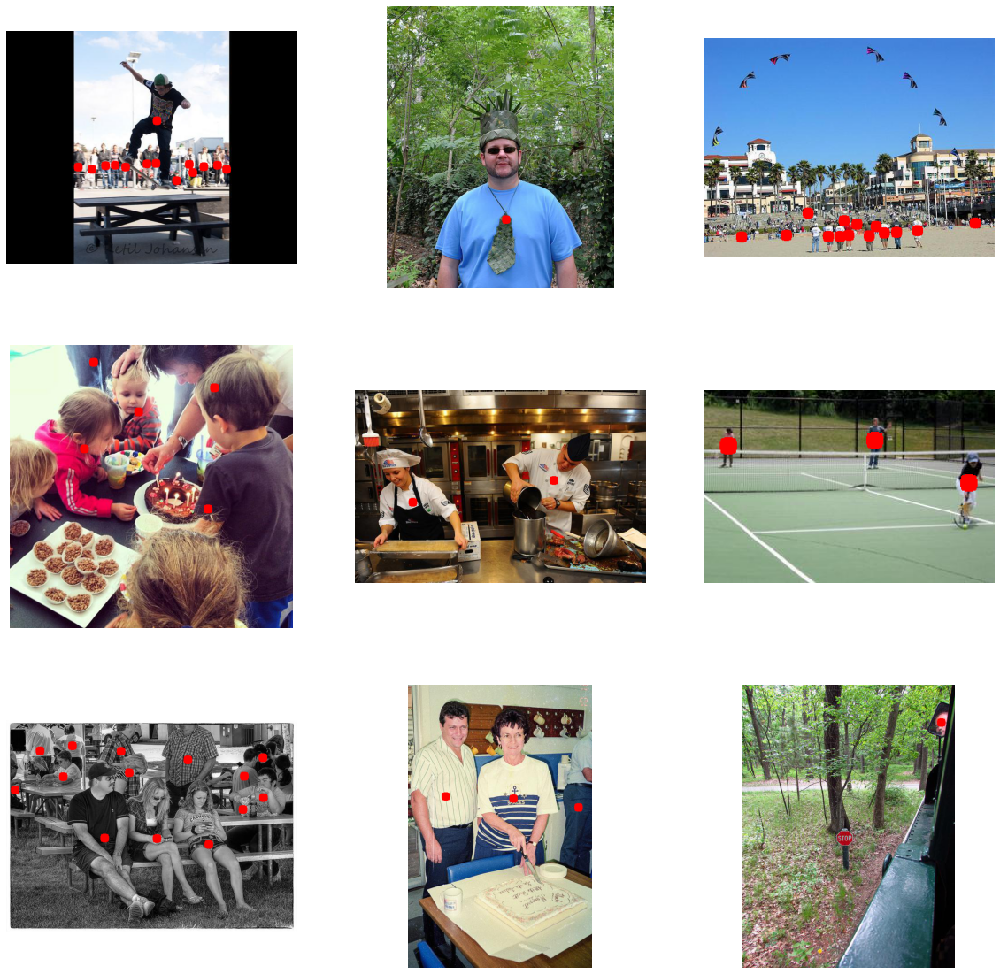

In [ ]:
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_dot2(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

In [ ]:
def draw_dot2(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        mc = np.array(cm(mask)).astype(int)
        x, y = mc
        cv2.circle(bg, tuple([y, x]), 5, 1, -1)
        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(int).flatten())
    t = t.reshape((height, width)) 
    return t

def draw_result_dot2(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = draw_dot2(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

# to show example, useless when generating annotation
def draw_sample_dot2(coco, img, img_pos):
    # graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = io.imread(r'{}/{}'.format(img_pos, img['file_name']))
    graph = draw_result_dot2(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    # graph = draw_result_tri(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

In [ ]:
print(mask.shape)
maxx, maxy = mask.shape
print(maxx, maxy)

(426, 640)
426 640


In [ ]:
x=np.arange(4).reshape(2,2,1)
print(x)
y=np.repeat(x,2,axis=2)
print(y.shape)
print(y)

[[[0]
  [1]]

 [[2]
  [3]]]
(2, 2, 2)
[[[0 0]
  [1 1]]

 [[2 2]
  [3 3]]]


In [ ]:
   
import math
import sys
from collections import namedtuple

Point = namedtuple('Point', ['x', 'y'])

EPSILON = math.sqrt(sys.float_info.epsilon)


def earclip(polygon):
    """
    Simple earclipping algorithm for a given polygon p.
    polygon is expected to be an array of 2-tuples of the cartesian points of the polygon
    For a polygon with n points it will return n-2 triangles.
    The triangles are returned as an array of 3-tuples where each item in the tuple is a 2-tuple of the cartesian point.
    e.g
    >>> polygon = [(0,1), (-1, 0), (0, -1), (1, 0)]
    >>> triangles = tripy.earclip(polygon)
    >>> triangles
    [((1, 0), (0, 1), (-1, 0)), ((1, 0), (-1, 0), (0, -1))]
    Implementation Reference:
        - https://www.geometrictools.com/Documentation/TriangulationByEarClipping.pdf
    """
    ear_vertex = []
    triangles = []

    polygon = [Point(*point) for point in polygon]

    if _is_clockwise(polygon):
        polygon.reverse()

    point_count = len(polygon)
    for i in range(point_count):
        prev_index = i - 1
        prev_point = polygon[prev_index]
        point = polygon[i]
        next_index = (i + 1) % point_count
        next_point = polygon[next_index]

        if _is_ear(prev_point, point, next_point, polygon):
            ear_vertex.append(point)

    while ear_vertex and point_count >= 3:
        ear = ear_vertex.pop(0)
        i = polygon.index(ear)
        prev_index = i - 1
        prev_point = polygon[prev_index]
        next_index = (i + 1) % point_count
        next_point = polygon[next_index]

        polygon.remove(ear)
        point_count -= 1
        triangles.append(((prev_point.x, prev_point.y), (ear.x, ear.y), (next_point.x, next_point.y)))
        if point_count > 3:
            prev_prev_point = polygon[prev_index - 1]
            next_next_index = (i + 1) % point_count
            next_next_point = polygon[next_next_index]

            groups = [
                (prev_prev_point, prev_point, next_point, polygon),
                (prev_point, next_point, next_next_point, polygon),
            ]
            for group in groups:
                p = group[1]
                if _is_ear(*group):
                    if p not in ear_vertex:
                        ear_vertex.append(p)
                elif p in ear_vertex:
                    ear_vertex.remove(p)
    return triangles


def _is_clockwise(polygon):
    s = 0
    polygon_count = len(polygon)
    for i in range(polygon_count):
        point = polygon[i]
        point2 = polygon[(i + 1) % polygon_count]
        s += (point2.x - point.x) * (point2.y + point.y)
    return s > 0


def _is_convex(prev, point, next):
    return _triangle_sum(prev.x, prev.y, point.x, point.y, next.x, next.y) < 0


def _is_ear(p1, p2, p3, polygon):
    ear = _contains_no_points(p1, p2, p3, polygon) and \
        _is_convex(p1, p2, p3) and \
        _triangle_area(p1.x, p1.y, p2.x, p2.y, p3.x, p3.y) > 0
    return ear


def _contains_no_points(p1, p2, p3, polygon):
    for pn in polygon:
        if pn in (p1, p2, p3):
            continue
        elif _is_point_inside(pn, p1, p2, p3):
            return False
    return True


def _is_point_inside(p, a, b, c):
    area = _triangle_area(a.x, a.y, b.x, b.y, c.x, c.y)
    area1 = _triangle_area(p.x, p.y, b.x, b.y, c.x, c.y)
    area2 = _triangle_area(p.x, p.y, a.x, a.y, c.x, c.y)
    area3 = _triangle_area(p.x, p.y, a.x, a.y, b.x, b.y)
    areadiff = abs(area - sum([area1, area2, area3])) < EPSILON
    return areadiff


def _triangle_area(x1, y1, x2, y2, x3, y3):
    return abs((x1 * (y2 - y3) + x2 * (y3 - y1) + x3 * (y1 - y2)) / 2.0)


def _triangle_sum(x1, y1, x2, y2, x3, y3):
    return x1 * (y3 - y2) + x2 * (y1 - y3) + x3 * (y2 - y1)


def calculate_total_area(triangles):
    result = []
    for triangle in triangles:
        sides = []
        for i in range(3):
            next_index = (i + 1) % 3
            pt = triangle[i]
            pt2 = triangle[next_index]
            # Distance between two points
            side = math.sqrt(math.pow(pt2[0] - pt[0], 2) + math.pow(pt2[1] - pt[1], 2))
            sides.append(side)
        # Heron's numerically stable forumla for area of a triangle:
        # https://en.wikipedia.org/wiki/Heron%27s_formula
        # However, for line-like triangles of zero area this formula can produce an infinitesimally negative value
        # as an input to sqrt() due to the cumulative arithmetic errors inherent to floating point calculations:
        # https://people.eecs.berkeley.edu/~wkahan/Triangle.pdf
        # For this purpose, abs() is used as a reasonable guard against this condition.
        c, b, a = sorted(sides)
        area = .25 * math.sqrt(abs((a + (b + c)) * (c - (a - b)) * (c + (a - b)) * (a + (b - c))))
        result.append((area, a, b, c))
    triangle_area = sum(tri[0] for tri in result)
    return triangle_area


In [ ]:
# def get_ten(s, coef, flag = 0):
#     approx = cv2.approxPolyDP(s, coef, True)
#     edge = len(approx)
#     if edge < 3:
#         if flag == 1:
#             return approx
#         else:
#             return get_ten(s, coef / 2, -1)
#     elif edge > 6:
#         if flag == -1:
#             return approx
#         else:
#             return get_ten(s, coef * 2, 1)
#     else:
#         return approx

def get_hex(s, coef, ct=0):
    approx = cv2.approxPolyDP(s, coef, True)
    edge = len(approx)
    if ct == 500:
        return approx
    if edge > 6:
        return get_hex(s, coef * 2, ct+1)
    elif edge < 3:
        return get_hex(s, coef / 2, ct+1)
    else:
        return approx

def find_same_element(x, y):
    num = 0
    item = []
    for i in x:
        for j in y:
            if list(i) == list(j):
                item.append(i)
                num += 1
    return num, item

def get_adjacent_points(obj, poly):
    adj_point = []
    adj_num = 0
    for triangle in poly:
        num, item = find_same_element(triangle, obj)
        if num == 2:
            adj_num += 1
            adj_point.append(list(item))
    return np.array(adj_point)

def middle_pts(pts):
    assert(len(pts)==2)
    x = 0.5*(pts[0]+pts[1])
    x = x.astype(int)
    return x


def other_pts(pts, triangle):
    assert(len(pts)==2)
    for p1 in triangle:
        flag = 0
        for p2 in pts:
            if list(p1) == list(p2):
                flag = 1
        if flag == 0:
            return p1

def draw_tri(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            poly = get_hex(s, 10)
            poly = poly.reshape((poly.shape[0], poly.shape[2]))
            # print(poly.shape)
            # print(poly)
            poly_tri = np.array(earclip(poly))
            # assert(poly_tri.shape[0] == len(poly) - 2)
            if len(poly_tri.shape) != 3:
                continue
            assert(poly_tri.shape[1] == 3)
            assert(poly_tri.shape[2] == 2)
            if len(poly_tri) == 1:
                bg = np.zeros((height, width))
                adj_point = poly_tri[0]
                # print('adj', adj_point)
                middle_12 = middle_pts(adj_point[:2])
                # print(middle_12)
                # print(adj_point[2])
                len_12 = np.linalg.norm(middle_12 - adj_point[2])
                middle_23 = middle_pts(adj_point[1:])
                len_23 = np.linalg.norm(middle_23 - adj_point[0])
                middle_13 = middle_pts([adj_point[0], adj_point[2]])
                len_13 = np.linalg.norm(middle_13 - adj_point[1])
                lenall = [len_12, len_13, len_23]
                if len_12 == np.max(lenall):
                    apex = np.vstack((middle_12, adj_point[2])).astype(int)
                elif len_23 == np.max(lenall):
                    apex = np.vstack((middle_23, adj_point[0])).astype(int)
                else:
                    apex = np.vstack((middle_13, adj_point[1])).astype(int)
                cv2.polylines(bg, [apex], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
            else:
                for i in poly_tri:
                    bg = np.zeros((height, width))
                    adj_point= get_adjacent_points(i,poly_tri)
                    if len(adj_point) == 1:
                        adj_point = adj_point[0]
                        apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, i))).astype(int)
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                    elif len(adj_point) == 2:
                        apex = np.vstack((middle_pts(adj_point[0]), middle_pts(adj_point[1]))).astype(int)
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                    else:
                        assert(len(adj_point) == 3)
                        m1 = middle_pts(adj_point[0])
                        m2 = middle_pts(adj_point[1])
                        m3 = middle_pts(adj_point[2])
                        m12 = middle_pts([m1,m2])
                        apex = np.vstack((m1,m2))
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                        apex = np.vstack((m12,m3))
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))

                    # adj_point = get_adjacent_points(triangle, poly_tri)
                    # if len(adj_point) == 2:
                    #     # apex = curve_scribble(np.vstack((middle_pts(adj_point), other_pts(adj_point, triangle))))
                    #     apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, triangle))).astype(int)
                    #     cv2.polylines(bg, [apex], 0, 1)
                    #     im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                    # else:
                    #     assert(len(adj_point) == 3)
                    #     middle_12 = middle_pts(adj_point[:2])
                    #     middle_23 = middle_pts(adj_point[1:])
                    #     middle_13 = middle_pts([adj_point[0], adj_point[2]])
                    #     middle_tri = middle_pts([middle_12, middle_23])
                    #     # apex = curve_scribble(np.vstack((middle_12, middle_23)))
                    #     apex = np.vstack((middle_12, middle_23)).astype(int)
                    #     cv2.polylines(bg, [apex], 0, 1)
                    #     im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                    #     # apex = curve_scribble(np.vstack((middle_13, middle_tri)))
                    #     apex = np.vstack((middle_13, middle_tri)).astype(int)
                    #     cv2.polylines(bg, [apex], 0, 1)
                    #     im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

def draw_result_tri(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = draw_tri(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

# to show example, useless when generating annotation
def draw_sample_tri(coco, img, img_pos):
    # graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = io.imread(r'{}/{}'.format(img_pos, img['file_name']))
    graph = draw_result_tri(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    # graph = draw_result_tri(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

def create_scribble_anno_tri(coco, img, target = 1, background_target = 2, real_background = 0):
    graph = np.zeros((img['height'], img['width'])) * real_background
    # add_background = draw_result_tri(coco, range(2,91), img['height'], img['width'], background_target, img, graph)
    # add_target = draw_result_tri(coco, [1], img['height'], img['width'], target, img, add_background)
    add_target = draw_result_tri(coco, [1], img['height'], img['width'], target, img, graph)
    return add_target

In [ ]:
# sin

def curve_scribble(pts):
    a1, b1, a2, b2 = pts[0,0], pts[0,1], pts[1,0], pts[1,1]
    x = np.linspace(a1,a2,1000)
    # 1e-7 to avoid 0
    y = (b1-b2)/(a1-a2+1e-7)*(x-a2)+b2
    hypo = np.sqrt((a1-a2)**2+(b1-b2)**2)+1e-7
    i = np.linspace(-hypo/2, hypo/2, 1000)
    # can adjust 10, 33 here to get different curve
    # hypo is the length between pts, 33 is aprox to 10*pi, which is 5 periods curve
    # 10 is amplitude
    j = 10*np.sin(33/hypo*i)
    cos = (a2-a1)/hypo
    sin = (b2-b1)/hypo
    matrix = np.array([[cos,-sin],[sin,cos]])
    z = np.dot(matrix,np.vstack((i,j)))
    anno = np.vstack((z[0]+(a1+a2)/2,z[1]+(b1+b2)/2))
    return anno.T.astype(int)

def draw_tri_s(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            poly = get_hex(s, 10)
            poly = poly.reshape((poly.shape[0], poly.shape[2]))
            # print(poly.shape)
            # print(poly)
            poly_tri = np.array(earclip(poly))
            # assert(poly_tri.shape[0] == len(poly) - 2)
            if len(poly_tri.shape) != 3:
                continue
            assert(poly_tri.shape[1] == 3)
            assert(poly_tri.shape[2] == 2)
            if len(poly_tri) == 1:
                bg = np.zeros((height, width))
                adj_point = poly_tri[0]
                # print('adj', adj_point)
                middle_12 = middle_pts(adj_point[:2])
                # print(middle_12)
                # print(adj_point[2])
                len_12 = np.linalg.norm(middle_12 - adj_point[2])
                middle_23 = middle_pts(adj_point[1:])
                len_23 = np.linalg.norm(middle_23 - adj_point[0])
                middle_13 = middle_pts([adj_point[0], adj_point[2]])
                len_13 = np.linalg.norm(middle_13 - adj_point[1])
                lenall = [len_12, len_13, len_23]
                if len_12 == np.max(lenall):
                    apex = np.vstack((middle_12, adj_point[2])).astype(int)
                elif len_23 == np.max(lenall):
                    apex = np.vstack((middle_23, adj_point[0])).astype(int)
                else:
                    apex = np.vstack((middle_13, adj_point[1])).astype(int)
                apex = curve_scribble(apex)
                cv2.polylines(bg, [apex], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
            else:
                for i in poly_tri:
                    bg = np.zeros((height, width))
                    adj_point= get_adjacent_points(i,poly_tri)
                    if len(adj_point) == 1:
                        adj_point = adj_point[0]
                        apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, i))).astype(int)
                        apex = curve_scribble(apex)
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                    elif len(adj_point) == 2:
                        apex = np.vstack((middle_pts(adj_point[0]), middle_pts(adj_point[1]))).astype(int)
                        apex = curve_scribble(apex)
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                    else:
                        assert(len(adj_point) == 3)
                        m1 = middle_pts(adj_point[0])
                        m2 = middle_pts(adj_point[1])
                        m3 = middle_pts(adj_point[2])
                        m12 = middle_pts([m1,m2])
                        apex = np.vstack((m1,m2))
                        apex = curve_scribble(apex)
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                        apex = np.vstack((m12,m3))
                        apex = curve_scribble(apex)
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

def draw_result_tri_s(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = draw_tri_s(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

# to show example, useless when generating annotation
def draw_sample_tri_s(coco, img, img_pos):
    # graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = io.imread(r'{}/{}'.format(img_pos, img['file_name']))
    graph = draw_result_tri_s(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    # graph = draw_result_tri(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

def create_scribble_anno_tri_s(coco, img, target = 1, background_target = 2, real_background = 0):
    graph = np.zeros((img['height'], img['width'])) * real_background
    # add_background = draw_result_tri(coco, range(2,91), img['height'], img['width'], background_target, img, graph)
    # add_target = draw_result_tri(coco, [1], img['height'], img['width'], target, img, add_background)
    add_target = draw_result_tri_s(coco, [1], img['height'], img['width'], target, img, graph)
    return add_target

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:92: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:94: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

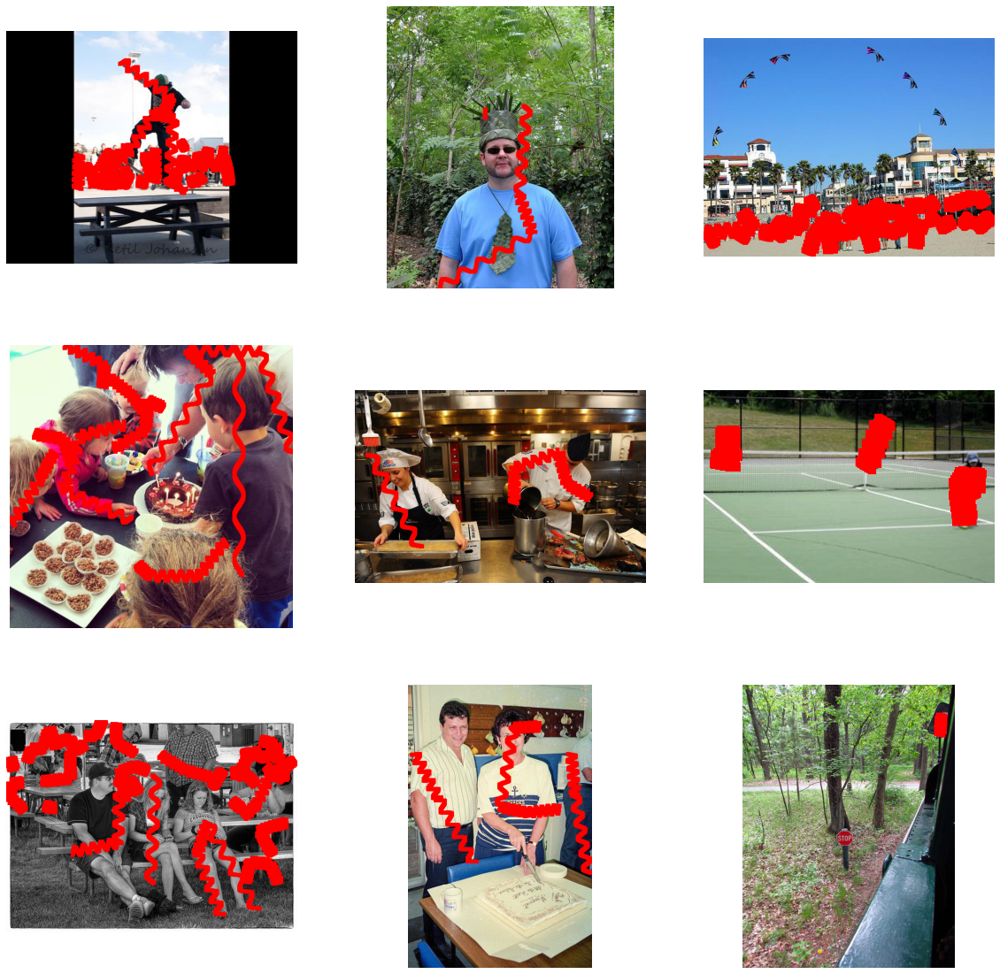

In [ ]:
# samples of generated scribble
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_tri_s(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

NameError: ignored

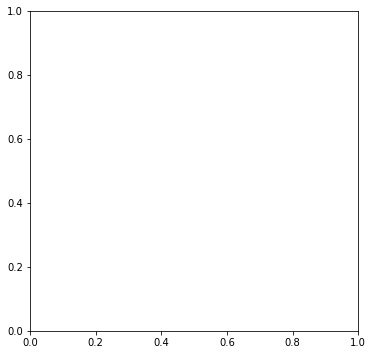

In [ ]:
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_tri(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

In [ ]:
def get_iso_pts(poly):
    iso_pts = []
    for triangle in poly:
        adj_point = get_adjacent_points(triangle, poly)
        if len(adj_point) == 1:
            adj_pts = adj_point[0]
            for pts in triangle:
                flag = 0
                for ref_pts in adj_pts:
                    # print(pts)
                    # print(ref_pts)
                    if list(pts) == list(ref_pts):
                        flag = 1
                if flag == 0:
                    iso_pts.append(pts)
    return iso_pts

def get_adjacent_triangle(obj, poly):
    adj_triangle = []
    for triangle in poly:
        num, item = find_same_element(triangle, obj)
        if num == 2:
            adj_triangle.append(triangle)
    return adj_triangle

def draw_mstri(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            poly = get_hex(s, 10)
            poly = poly.reshape((poly.shape[0], poly.shape[2]))
            poly_tri = np.array(earclip(poly))
            if len(poly_tri.shape) != 3:
                continue
            assert(poly_tri.shape[1] == 3)
            assert(poly_tri.shape[2] == 2)
            if len(poly_tri) == 1:
                bg = np.zeros((height, width))
                mc = np.mean(poly_tri[0], axis=0)
                for pts in poly_tri[0]:
                    apex = np.vstack((mc, pts)).astype(int)
                    cv2.polylines(bg, [apex], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
            else:
                bg = np.zeros((height, width))
                for i in poly_tri:
                    
                    adj_tri = get_adjacent_triangle(i, poly_tri)
                    mc_i = np.mean(i, axis = 0)
                    for j in adj_tri:
                        mc_j = np.mean(j, axis = 0)
                        apex = np.vstack((mc_i, mc_j)).astype(int)
                        cv2.polylines(bg, [apex], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

def draw_result_mstri(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = draw_mstri(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

# to show example, useless when generating annotation
def draw_sample_mstri(coco, img, img_pos):
    # graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = io.imread(r'{}/{}'.format(img_pos, img['file_name']))
    graph = draw_result_mstri(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    # graph = draw_result_tri(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

def create_scribble_anno_mstri(coco, img, target = 1, background_target = 2, real_background = 0):
    graph = np.zeros((img['height'], img['width'])) * real_background
    # add_background = draw_result_tri(coco, range(2,91), img['height'], img['width'], background_target, img, graph)
    # add_target = draw_result_tri(coco, [1], img['height'], img['width'], target, img, add_background)
    add_target = draw_result_mstri(coco, [1], img['height'], img['width'], target, img, graph)
    return add_target

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:61: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

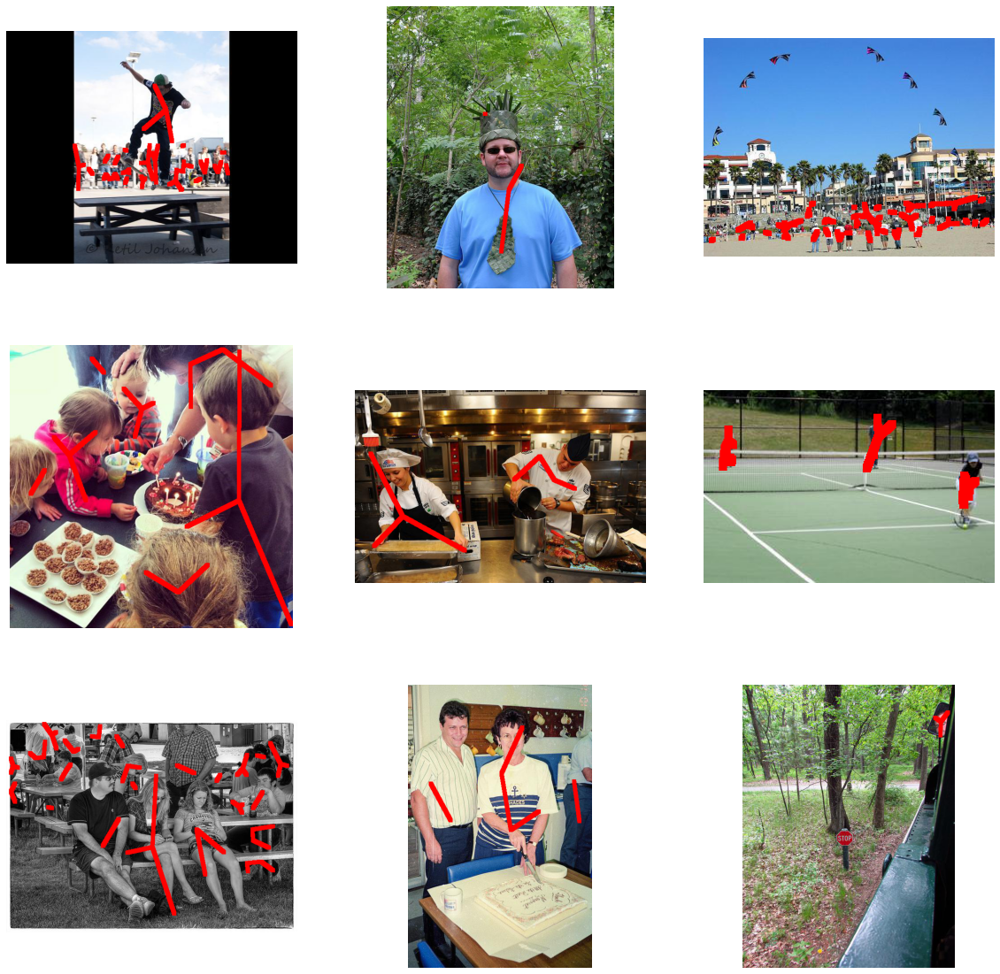

In [ ]:
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_mstri(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

In [ ]:
# sin mode

def draw_tri(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            poly = get_hex(s, 10)
            poly = poly.reshape((poly.shape[0], poly.shape[2]))
            # print(poly.shape)
            # print(poly)
            poly_tri = np.array(earclip(poly))
            # assert(poly_tri.shape[0] == len(poly) - 2)
            if len(poly_tri.shape) != 3:
                print('error')
                print(poly_tri.shape)
                continue
            assert(poly_tri.shape[1] == 3)
            assert(poly_tri.shape[2] == 2)
            if len(poly_tri) == 1:
                bg = np.zeros((height, width))
                adj_point = poly_tri[0]
                # print('adj', adj_point)
                middle_12 = middle_pts(adj_point[:2])
                # print(middle_12)
                # print(adj_point[2])
                len_12 = np.linalg.norm(middle_12 - adj_point[2])
                middle_23 = middle_pts(adj_point[1:])
                len_23 = np.linalg.norm(middle_23 - adj_point[0])
                middle_13 = middle_pts([adj_point[0], adj_point[2]])
                len_13 = np.linalg.norm(middle_13 - adj_point[1])
                lenall = [len_12, len_13, len_23]
                if len_12 == np.max(lenall):
                    apex = np.vstack((middle_12, adj_point[2])).astype(int)
                elif len_23 == np.max(lenall):
                    apex = np.vstack((middle_23, adj_point[0])).astype(int)
                else:
                    apex = np.vstack((middle_13, adj_point[1])).astype(int)
                apex = curve_scribble(apex.reshape(2,2))
                cv2.polylines(bg, [apex], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
            else:
                for triangle in poly_tri:
                    bg = np.zeros((height, width))
                    adj_point = get_adjacent_points(triangle, poly_tri)
                    if len(adj_point) == 2:
                        # apex = curve_scribble(np.vstack((middle_pts(adj_point), other_pts(adj_point, triangle))))
                        apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, triangle))).astype(int)
                        apex = curve_scribble(apex.reshape(2,2))
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                    else:
                        assert(len(adj_point) == 3)
                        middle_12 = middle_pts(adj_point[:2])
                        middle_23 = middle_pts(adj_point[1:])
                        middle_13 = middle_pts([adj_point[0], adj_point[2]])
                        middle_tri = middle_pts([middle_12, middle_23])
                        # apex = curve_scribble(np.vstack((middle_12, middle_23)))
                        apex = np.vstack((middle_12, middle_23)).astype(int)
                        apex = curve_scribble(apex.reshape(2,2))
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                        # apex = curve_scribble(np.vstack((middle_13, middle_tri)))
                        apex = np.vstack((middle_13, middle_tri)).astype(int)
                        apex = curve_scribble(apex.reshape(2,2))
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

def draw_result_tri(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = draw_tri(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

# to show example, useless when generating annotation
def draw_sample_tri(coco, img, img_pos):
    # graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = io.imread(r'{}/{}'.format(img_pos, img['file_name']))
    graph = draw_result_tri(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    # graph = draw_result_tri(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

def create_scribble_anno_tri(coco, img, target = 1, background_target = 2, real_background = 0):
    graph = np.zeros((img['height'], img['width'])) * real_background
    # add_background = draw_result_tri(coco, range(2,91), img['height'], img['width'], background_target, img, graph)
    # add_target = draw_result_tri(coco, [1], img['height'], img['width'], target, img, add_background)
    add_target = draw_result_tri(coco, [1], img['height'], img['width'], target, img, graph)
    return add_target

In [ ]:
def draw_tri(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            poly = get_hex(s, 10)
            poly = poly.reshape((poly.shape[0], poly.shape[2]))
            # print(poly.shape)
            # print(poly)
            poly_tri = np.array(earclip(poly))
            # assert(poly_tri.shape[0] == len(poly) - 2)
            if len(poly_tri.shape) != 3:
                continue
            assert(poly_tri.shape[1] == 3)
            assert(poly_tri.shape[2] == 2)
            if len(poly_tri) == 1:
                bg = np.zeros((height, width))
                adj_point = poly_tri[0]
                # print('adj', adj_point)
                middle_12 = middle_pts(adj_point[:2])
                # print(middle_12)
                # print(adj_point[2])
                len_12 = np.linalg.norm(middle_12 - adj_point[2])
                middle_23 = middle_pts(adj_point[1:])
                len_23 = np.linalg.norm(middle_23 - adj_point[0])
                middle_13 = middle_pts([adj_point[0], adj_point[2]])
                len_13 = np.linalg.norm(middle_13 - adj_point[1])
                lenall = [len_12, len_13, len_23]
                if len_12 == np.max(lenall):
                    apex = np.vstack((middle_12, adj_point[2])).astype(int)
                elif len_23 == np.max(lenall):
                    apex = np.vstack((middle_23, adj_point[0])).astype(int)
                else:
                    apex = np.vstack((middle_13, adj_point[1])).astype(int)
                cv2.polylines(bg, [apex], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
            else:
                for i in poly_tri:
                    bg = np.zeros((height, width))
                    adj_point= get_adjacent_points(i,poly_tri)
                    if len(adj_point) == 1:
                        adj_point = adj_point[0]
                        apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, i))).astype(int)
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                    elif len(adj_point) == 2:
                        apex = np.vstack((middle_pts(adj_point[0]), middle_pts(adj_point[1]))).astype(int)
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                    else:
                        assert(len(adj_point) == 3)
                        m1 = middle_pts(adj_point[0])
                        m2 = middle_pts(adj_point[1])
                        m3 = middle_pts(adj_point[2])
                        m12 = middle_pts([m1,m2])
                        apex = np.vstack((m1,m2))
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                        apex = np.vstack((m12,m3))
                        cv2.polylines(bg, [apex], 0, 1)
                        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))

                    # adj_point = get_adjacent_points(triangle, poly_tri)
                    # if len(adj_point) == 2:
                    #     # apex = curve_scribble(np.vstack((middle_pts(adj_point), other_pts(adj_point, triangle))))
                    #     apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, triangle))).astype(int)
                    #     cv2.polylines(bg, [apex], 0, 1)
                    #     im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                    # else:
                    #     assert(len(adj_point) == 3)
                    #     middle_12 = middle_pts(adj_point[:2])
                    #     middle_23 = middle_pts(adj_point[1:])
                    #     middle_13 = middle_pts([adj_point[0], adj_point[2]])
                    #     middle_tri = middle_pts([middle_12, middle_23])
                    #     # apex = curve_scribble(np.vstack((middle_12, middle_23)))
                    #     apex = np.vstack((middle_12, middle_23)).astype(int)
                    #     cv2.polylines(bg, [apex], 0, 1)
                    #     im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
                    #     # apex = curve_scribble(np.vstack((middle_13, middle_tri)))
                    #     apex = np.vstack((middle_13, middle_tri)).astype(int)
                    #     cv2.polylines(bg, [apex], 0, 1)
                    #     im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

In [ ]:
#test
def draw_mstri(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            poly = get_hex(s, 10)
            poly = poly.reshape((poly.shape[0], poly.shape[2]))
            poly_tri = np.array(earclip(poly))
            if len(poly_tri.shape) != 3:
                continue
            assert(poly_tri.shape[1] == 3)
            assert(poly_tri.shape[2] == 2)
            if len(poly_tri) == 1:
                bg = np.zeros((height, width))
                mc = cm(poly_tri[0])
                for pts in poly_tri[0]:
                    apex = np.vstack((mc, pts))
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
            else:
                bg = np.zeros((height, width))
                for i in poly_tri:
                    
                    adj_tri = get_adjacent_triangle(i, poly_tri)
                    mc_i = cm(i)
                    for j in adj_tri:
                        mc_j = cm(j)
                        apex = np.vstack((mc_i, mc_j)).astype(int)
                        cv2.polylines(bg, [apex], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


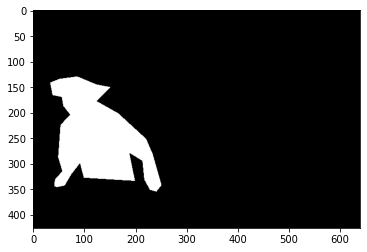

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
img = ori[4]
height, width = img['height'], img['width']
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
mask = create_mask_3d(coco_train, anns, height, width)
plt.imshow(mask)

In [ ]:
# for i in range(len(anns)):
i = 0
bg = np.zeros((height, width))
mask = coco_train.annToMask(anns[i])
x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

In [ ]:
s = ct[0]
poly = get_hex(s, 10)
print(poly.shape)
poly = poly.reshape((poly.shape[0], poly.shape[2]))
print(poly.shape)

(3, 1, 2)
(3, 2)


In [ ]:
poly_tri = np.array(earclip(poly))
print(poly_tri)

[[[ 34 141]
  [241 354]
  [ 42 344]]]


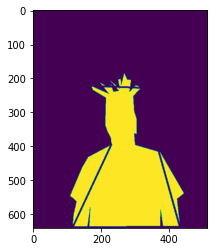

In [ ]:
g = mask.copy()
cv2.polylines(g, [np.array(poly)], 1, [0,255,255], 4)

    
plt.imshow(g)

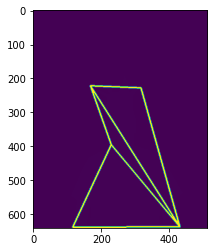

In [ ]:
g2 = mask.copy()
for i in poly_tri:
    # cv2.polylines(g2, [np.array(poly)], 1, [0,255,255], 4)
    cv2.polylines(g2, [i], 1, [255,0,0], 4)
    
plt.imshow(g2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[304.66666667 362.        ]
[258.33333333 556.        ]
[275.66666667 417.66666667]


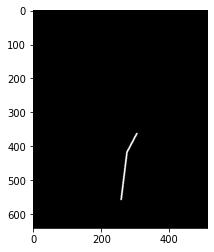

In [ ]:
bg = np.zeros((height, width,3))
for i in poly_tri:
    adj_tri = get_adjacent_triangle(i, poly_tri)
    mc_i = np.mean(i, axis=0)
    print(mc_i)
    for j in adj_tri:
        mc_j = np.mean(j, axis=0)
        apex = np.vstack((mc_i, mc_j)).astype(int)
        cv2.polylines(bg, [apex], 0, [255,255,255], 4)
plt.imshow(bg)

In [ ]:
xx=np.array([[10,10],[10,100],[100,10]])
print(cm(xx))

(1.375, 0.5)


In [ ]:
print(np.mean(xx, axis = 0))

[40. 40.]


In [ ]:
xx=[[10,10],[10,100],[100,10]]
xp = np.array(earclip(xx))
print(xp)
print(xp.shape)

[[[ 10  10]
  [100  10]
  [ 10 100]]]
(1, 3, 2)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 299.5, 299.5, -0.5)

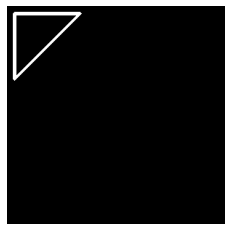

In [ ]:
x=[[10,10],[10,100],[100,10]]
g = np.zeros((300,300,3))
gg = g.copy()
cv2.polylines(gg, [np.array(x)], 1, [255,255,255], 4)
plt.imshow(gg)
plt.axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


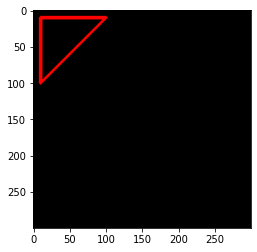

In [ ]:
g2 = g.copy()
p = np.array(earclip(x))
for i in p:
    cv2.polylines(g2, [np.array(x)], 1, [255,255,255], 4)
    cv2.polylines(g2, [i], 1, [255,0,0], 4)
    
plt.imshow(g2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


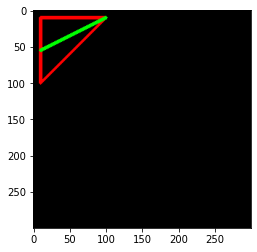

In [ ]:
g3 = g2.copy()


if len(x) == 1:
    print('x')
elif len(x) == 2:
    cv2.polylines(g3, [x], 0, [0,255,0], 4)
elif len(x) == 3:  
    xx = np.array(x)
    
    apex = np.vstack((middle_pts(xx[:2]), other_pts(xx[:2], xx))).astype(int)
    cv2.polylines(g3, [apex], 0, [0,255,0], 4)
else:
    p = np.array(earclip(x))
    for i in p:
        adj_point= get_adjacent_points(i,p)
        if len(adj_point) == 1:
            adj_point = adj_point[0]
            apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, i))).astype(int)
            cv2.polylines(g3, [apex], 0, [0,255,0], 4)
        elif len(adj_point) == 2:
            apex = np.vstack((middle_pts(adj_point[0]), middle_pts(adj_point[1]))).astype(int)
            cv2.polylines(g3, [apex], 0, [0,255,0], 4)
        else:
            assert(len(adj_point) == 3)
            m1 = middle_pts(adj_point[0])
            m2 = middle_pts(adj_point[1])
            m3 = middle_pts(adj_point[2])
            m12 = middle_pts([m1,m2])
            apex = np.vstack((m1,m2))
            cv2.polylines(g3, [apex], 0, [0,255,0], 4)
            apex = np.vstack((m12,m3))
            cv2.polylines(g3, [apex], 0, [0,255,0], 4)


plt.imshow(g3)

In [ ]:
print(x)
print(np.vstack((x[0],x[2])))

[[10, 10], [10, 100], [100, 10]]
[[ 10  10]
 [100  10]]


In [ ]:
print(middle_pts(np.array(x[:2])))

[10 55]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


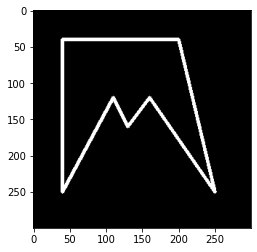

In [ ]:
x = [[40, 40], [40,250],[110,120],[130, 160], [160,120],[250,250],[200,40]]
g = np.zeros((300,300,3))
gg = g.copy()
cv2.polylines(gg, [np.array(x)], 1, [255,255,255], 4)
plt.imshow(gg)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


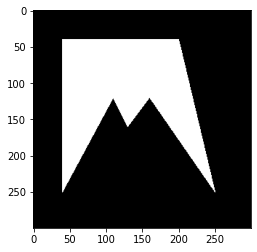

In [ ]:
f = g.copy()
cv2.fillPoly(f, [np.array(x)], [255,255,255])
plt.imshow(f)

In [ ]:
from scipy.ndimage.measurements import center_of_mass as cm
c = cm(f)
print(c)

(113.72074649812095, 127.30675606422959, 1.0)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[113.7207465  127.30675606]


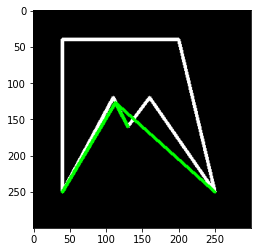

In [ ]:
ggg = gg.copy()
iso = get_iso_pts(ear)
mc = np.array(c[:2])
print(mc)
for i in iso:
    ii = np.array(i)
    apex = np.vstack((ii,mc)).astype(int)
    cv2.polylines(ggg, [apex], 0, [0,255,0], 4)
plt.imshow(ggg)

In [ ]:
print(apex)

[[250.         250.        ]
 [113.7207465  127.30675606]]


In [ ]:
print(get_iso_pts(ear))

(200, 40)
[200  40]
(200, 40)
[160 120]
(250, 250)
[200  40]
(250, 250)
[160 120]
(160, 120)
[200  40]
(160, 120)
[160 120]
(160, 120)
[160 120]
(160, 120)
[110 120]
(130, 160)
[160 120]
(130, 160)
[110 120]
(110, 120)
[160 120]
(110, 120)
[110 120]
(110, 120)
[40 40]
(110, 120)
[110 120]
(40, 250)
[40 40]
(40, 250)
[110 120]
(40, 40)
[40 40]
(40, 40)
[110 120]
[(250, 250), (130, 160), (40, 250)]


In [ ]:
print(get_iso_pts(ear))

[(250, 250), (130, 160), (40, 250)]


In [ ]:
t = [[110,120],[40,250],[40,40]]
a = get_adjacent_points(t, ear)
print(a)

[[[ 40  40]
  [110 120]]]


In [ ]:
aa = a[0]
print(aa)
print(t)

[[ 40  40]
 [110 120]]
[[110, 120], [40, 250], [40, 40]]


In [ ]:
for x in t:
    print('------')
    print(x)
    for i in aa:
        print(i, list(i) == list(x))

NameError: ignored

In [ ]:
def get_iso_pts(poly):
    iso_pts = []
    for triangle in poly:
        adj_point = get_adjacent_points(triangle, poly)
        if len(adj_point) == 1:
            adj_pts = adj_point[0]
            for pts in triangle:
                flag = 0
                for ref_pts in adj_pts:
                    # print(pts)
                    # print(ref_pts)
                    if list(pts) == list(ref_pts):
                        flag = 1
                if flag == 0:
                    iso_pts.append(pts)
    return iso_pts


def get_adjacent_points(obj, poly):
    adj_point = []
    adj_num = 0
    for triangle in poly:
        num, item = find_same_element(triangle, obj)
        if num == 2:
            adj_num += 1
            adj_point.append(list(item))
    return np.array(adj_point)

In [ ]:
def find_same_element(x, y):
    num = 0
    item = []
    for i in x:
        for j in y:
            if list(i) == list(j):
                item.append(i)
                num += 1
    return num, item

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


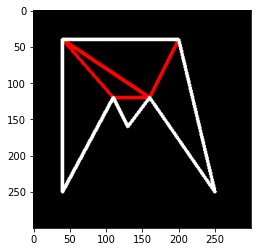

In [ ]:
g2 = g.copy()
p = np.array(earclip(x))
for i in p:
    cv2.polylines(g2, [i], 1, [255,0,0], 4)
    cv2.polylines(g2, [np.array(x)], 1, [255,255,255], 4)
plt.imshow(g2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


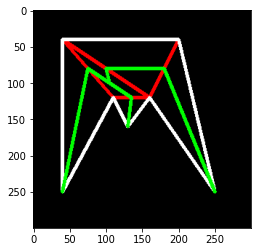

In [ ]:
g3 = g2.copy()
p = np.array(earclip(x))

for i in p:
    adj_point= get_adjacent_points(i,p)
    if len(adj_point) == 1:
        adj_point = adj_point[0]
        apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, i))).astype(int)
        cv2.polylines(g3, [apex], 0, [0,255,0], 4)
    elif len(adj_point) == 2:
        apex = np.vstack((middle_pts(adj_point[0]), middle_pts(adj_point[1]))).astype(int)
        cv2.polylines(g3, [apex], 0, [0,255,0], 4)
    else:
        assert(len(adj_point) == 3)
        m1 = middle_pts(adj_point[0])
        m2 = middle_pts(adj_point[1])
        m3 = middle_pts(adj_point[2])
        m12 = middle_pts([m1,m2])
        apex = np.vstack((m1,m2))
        cv2.polylines(g3, [apex], 0, [0,255,0], 4)
        apex = np.vstack((m12,m3))
        cv2.polylines(g3, [apex], 0, [0,255,0], 4)


plt.imshow(g3)

In [ ]:
print(len(x))

3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 299.5, 299.5, -0.5)

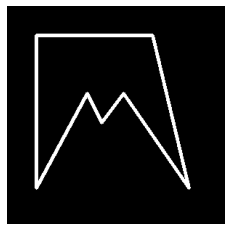

In [ ]:
x = [[40, 40], [40,250],[110,120],[130, 160], [160,120],[250,250],[200,40]]
g = np.zeros((300,300,3))
gg = g.copy()
cv2.polylines(gg, [np.array(x)], 1, [255,255,255], 4)
plt.imshow(gg)
plt.axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


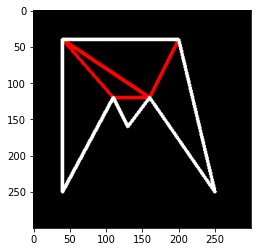

In [ ]:
g2 = g.copy()
p = np.array(earclip(x))
for i in p:
    cv2.polylines(g2, [i], 1, [255,0,0], 4)
    cv2.polylines(g2, [np.array(x)], 1, [255,255,255], 4)
plt.imshow(g2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


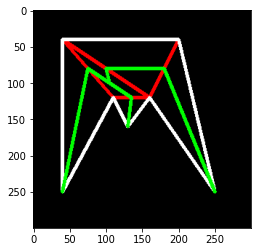

In [ ]:
g3 = g2.copy()
p = np.array(earclip(x))

for i in p:
    adj_point= get_adjacent_points(i,p)
    if len(adj_point) == 1:
        adj_point = adj_point[0]
        apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, i))).astype(int)
        cv2.polylines(g3, [apex], 0, [0,255,0], 4)
    elif len(adj_point) == 2:
        apex = np.vstack((middle_pts(adj_point[0]), middle_pts(adj_point[1]))).astype(int)
        cv2.polylines(g3, [apex], 0, [0,255,0], 4)
    else:
        assert(len(adj_point) == 3)
        m1 = middle_pts(adj_point[0])
        m2 = middle_pts(adj_point[1])
        m3 = middle_pts(adj_point[2])
        m12 = middle_pts([m1,m2])
        apex = np.vstack((m1,m2))
        cv2.polylines(g3, [apex], 0, [0,255,0], 4)
        apex = np.vstack((m12,m3))
        cv2.polylines(g3, [apex], 0, [0,255,0], 4)


plt.imshow(g3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


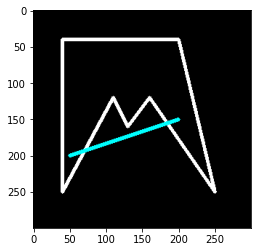

In [ ]:
g1 = gg.copy()
f = np.array([[50,200],[200,150]])
cv2.polylines(g1, [f], 0, [0,255,255], 4)
plt.imshow(g1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


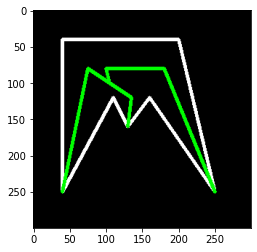

In [ ]:
g4 = gg.copy()
p = np.array(earclip(x))

for i in p:
    adj_point= get_adjacent_points(i,p)
    if len(adj_point) == 1:
        adj_point = adj_point[0]
        apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, i))).astype(int)
        cv2.polylines(g4, [apex], 0, [0,255,0], 4)
    elif len(adj_point) == 2:
        apex = np.vstack((middle_pts(adj_point[0]), middle_pts(adj_point[1]))).astype(int)
        cv2.polylines(g4, [apex], 0, [0,255,0], 4)
    else:
        assert(len(adj_point) == 3)
        m1 = middle_pts(adj_point[0])
        m2 = middle_pts(adj_point[1])
        m3 = middle_pts(adj_point[2])
        m12 = middle_pts([m1,m2])
        apex = np.vstack((m1,m2))
        cv2.polylines(g4, [apex], 0, [0,255,0], 4)
        apex = np.vstack((m12,m3))
        cv2.polylines(g4, [apex], 0, [0,255,0], 4)


plt.imshow(g4)

In [ ]:
def curve_scribble(pts):
    a1, b1, a2, b2 = pts[0,0], pts[0,1], pts[1,0], pts[1,1]
    x = np.linspace(a1,a2,1000)
    # 1e-7 to avoid 0
    y = (b1-b2)/(a1-a2+1e-7)*(x-a2)+b2
    hypo = np.sqrt((a1-a2)**2+(b1-b2)**2)+1e-7
    i = np.linspace(-hypo/2, hypo/2, 1000)
    # can adjust 10, 33 here to get different curve
    # hypo is the length between pts, 33 is aprox to 10*pi, which is 5 periods curve
    # 10 is amplitude
    j = 10*np.sin(0.2*i)
    cos = (a2-a1)/hypo
    sin = (b2-b1)/hypo
    matrix = np.array([[cos,-sin],[sin,cos]])
    z = np.dot(matrix,np.vstack((i,j)))
    anno = np.vstack((z[0]+(a1+a2)/2,z[1]+(b1+b2)/2))
    return anno.T.astype(int)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


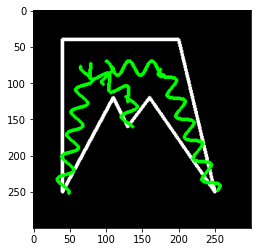

In [ ]:
g5 = gg.copy()
p = np.array(earclip(x))

for i in p:
    adj_point= get_adjacent_points(i,p)
    if len(adj_point) == 1:
        adj_point = adj_point[0]
        apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, i))).astype(int)
        apex = curve_scribble(apex)
        cv2.polylines(g5, [apex], 0, [0,255,0], 4)
    elif len(adj_point) == 2:
        apex = np.vstack((middle_pts(adj_point[0]), middle_pts(adj_point[1]))).astype(int)
        apex = curve_scribble(apex)
        cv2.polylines(g5, [apex], 0, [0,255,0], 4)
    else:
        assert(len(adj_point) == 3)
        m1 = middle_pts(adj_point[0])
        m2 = middle_pts(adj_point[1])
        m3 = middle_pts(adj_point[2])
        m12 = middle_pts([m1,m2])
        apex = np.vstack((m1,m2))
        apex = curve_scribble(apex)
        cv2.polylines(g5, [apex], 0, [0,255,0], 4)
        apex = np.vstack((m12,m3))
        apex = curve_scribble(apex)
        cv2.polylines(g5, [apex], 0, [0,255,0], 4)


plt.imshow(g5)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'final-2')

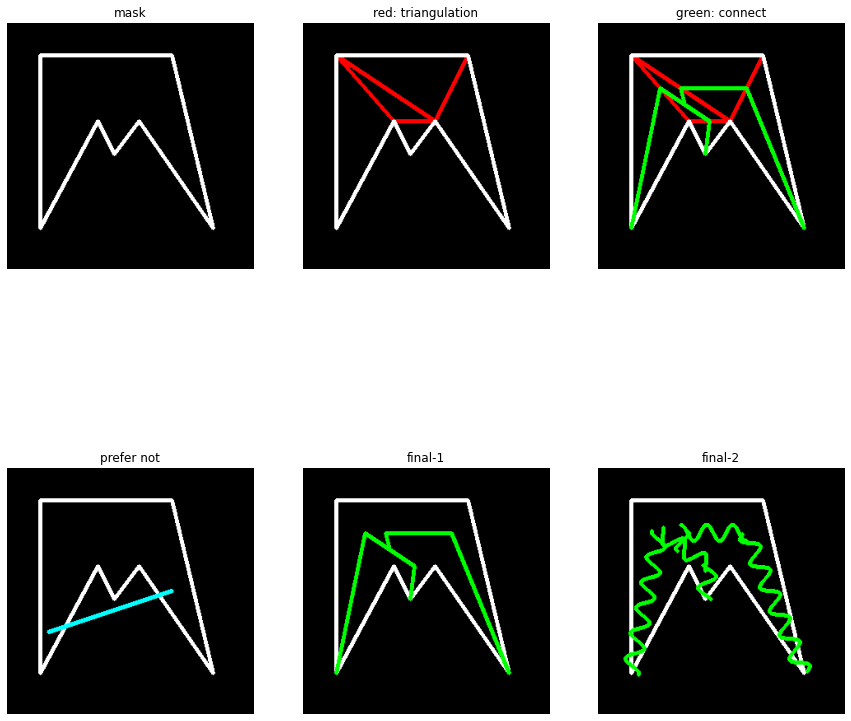

In [ ]:
plt.figure(figsize=(15,15))
plt.subplot(2,3,1)
plt.imshow(gg)
plt.title('mask')
plt.axis('off')
plt.subplot(2,3,2)
plt.title('red: triangulation')
plt.imshow(g2)
plt.axis('off')
plt.subplot(2,3,3)
plt.imshow(g3)
plt.title('green: connect')
plt.axis('off')
plt.subplot(2,3,4)
plt.imshow(g1)
plt.axis('off')
plt.title('prefer not')
plt.subplot(2,3,5)
plt.imshow(g4)
plt.axis('off')
plt.title('final-1')
plt.subplot(2,3,6)
plt.imshow(g5)
plt.axis('off')
plt.title('final-2')

In [ ]:
print(np.unique(q))

[ 40 110 120 160]


In [ ]:
qq = np.array(adj_point).reshape(4,2)
print(qq)

[[200  40]
 [160 120]
 [ 40  40]
 [160 120]]


In [ ]:
def get_adjacent_points(obj, poly):
    adj_point = []
    adj_num = 0
    for triangle in poly:
        num, item = find_same_element(triangle, obj)
        if num == 2:
            adj_num += 1
            adj_point.append(list(item))
    return np.array(adj_point)

def middle_pts(pts):
    assert(len(pts)==2)
    x = 0.5*(pts[0]+pts[1])
    x = x.astype(int)
    return x


def other_pts(pts, triangle):
    assert(len(pts)==2)
    for p1 in triangle:
        flag = 0
        for p2 in pts:
            if list(p1) == list(p2):
                flag = 1
        if flag == 0:
            return p1

In [ ]:
print(p)
for t in p:
    print('--------------')
    print(t)
    print(len(get_adjacent_points(t,p)))
    print((get_adjacent_points(t,p)))
    x = get_adjacent_points(t,p)
    if len(x) == 2:
        m = middle_pts(x)
        print('xxxx', m)

[[[200  40]
  [250 250]
  [160 120]]

 [[110 120]
  [ 40 250]
  [ 40  40]]

 [[ 40  40]
  [200  40]
  [160 120]]

 [[ 40  40]
  [160 120]
  [110 120]]]
--------------
[[200  40]
 [250 250]
 [160 120]]
2
[[200  40]
 [160 120]]
xxxx [180  80]
--------------
[[110 120]
 [ 40 250]
 [ 40  40]]
2
[[110 120]
 [ 40  40]]
xxxx [75 80]
--------------
[[ 40  40]
 [200  40]
 [160 120]]
3
[[ 40  40]
 [200  40]
 [160 120]]
--------------
[[ 40  40]
 [160 120]
 [110 120]]
3
[[ 40  40]
 [160 120]
 [110 120]]


[[200  40]
 [250 250]
 [160 120]]
2
[[180  80]
 [250 250]]


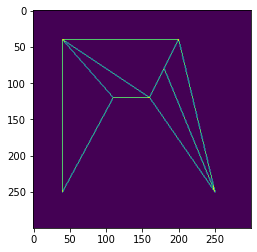

In [ ]:
g3 = g2.copy()
for triangle in p:
    print(triangle)
    adj_point = get_adjacent_points(triangle, p)
    if len(adj_point) == 2:
        print('2')
        # apex = curve_scribble(np.vstack((middle_pts(adj_point), other_pts(adj_point, triangle))))
        apex = np.vstack((middle_pts(adj_point), other_pts(adj_point, triangle))).astype(int)
        print(apex)
        cv2.polylines(g3, [apex], 1, 4)
        break
    else:
        print(3)
        assert(len(adj_point) == 3)
        middle_12 = middle_pts(adj_point[:2])
        middle_23 = middle_pts(adj_point[1:])
        middle_13 = middle_pts([adj_point[0], adj_point[2]])
        middle_tri = middle_pts([middle_12, middle_23])
        # apex = curve_scribble(np.vstack((middle_12, middle_23)))
        apex = np.vstack((middle_12, middle_23)).astype(int)
        cv2.polylines(g3, [apex], 1, 4)
        # apex = curve_scribble(np.vstack((middle_13, middle_tri)))
        apex = np.vstack((middle_13, middle_tri)).astype(int)
        cv2.polylines(g3, [apex], 1, 4)
plt.imshow(g3)

In [ ]:
q = []
print(len(q)==0)

True


In [ ]:
def find_same_element(x, y):
    num = 0
    item = []
    for i in x:
        for j in y:
            if list(i) == list(j):
                item.append(i)
                num += 1
    return num, item

In [ ]:
x=[[1,2],[2,3],[3,4]]
y=[[1,20],[2,30],[30,4]]
print(find_same_element(x,y))

(0, [])


In [ ]:
dataDir = '/gdrive/My Drive/anno'
coco_train = COCO('{}/instances_train2017.json'.format(dataDir))
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)

In [ ]:
dataDir = '/gdrive/My Drive/anno'
coco_train = COCO('{}/instances_train2017.json'.format(dataDir))

loading annotations into memory...
Done (t=30.43s)
creating index...
index created!


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:88: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:90: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

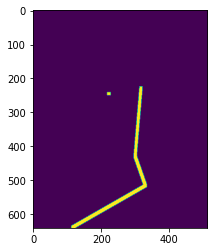

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
x = create_scribble_anno_tri(coco_train, ori[1], 1, 2, 0)
plt.imshow(x)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:88: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:90: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

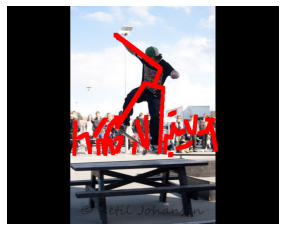

In [ ]:
draw_sample_tri(coco_train, ori[0], r'/gdrive/My Drive/anno/draw')

AssertionError: ignored

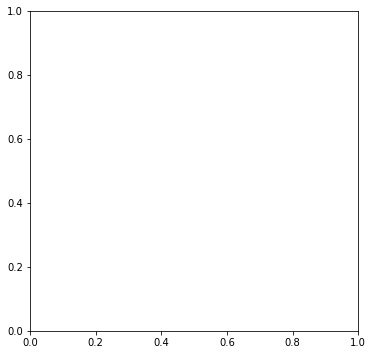

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_tri(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:61: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

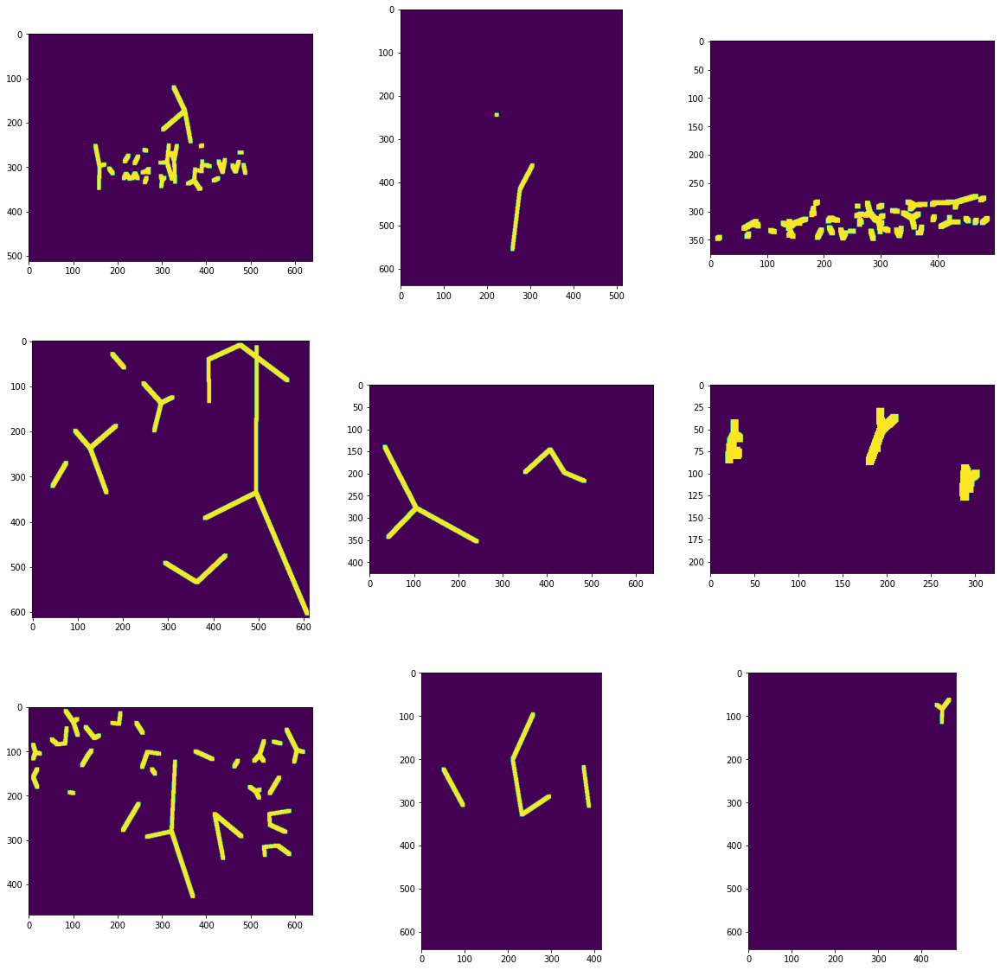

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    x = create_scribble_anno_mstri(coco_train, ori[i], 1, 0, 0)
    plt.imshow(x)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:153: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprec

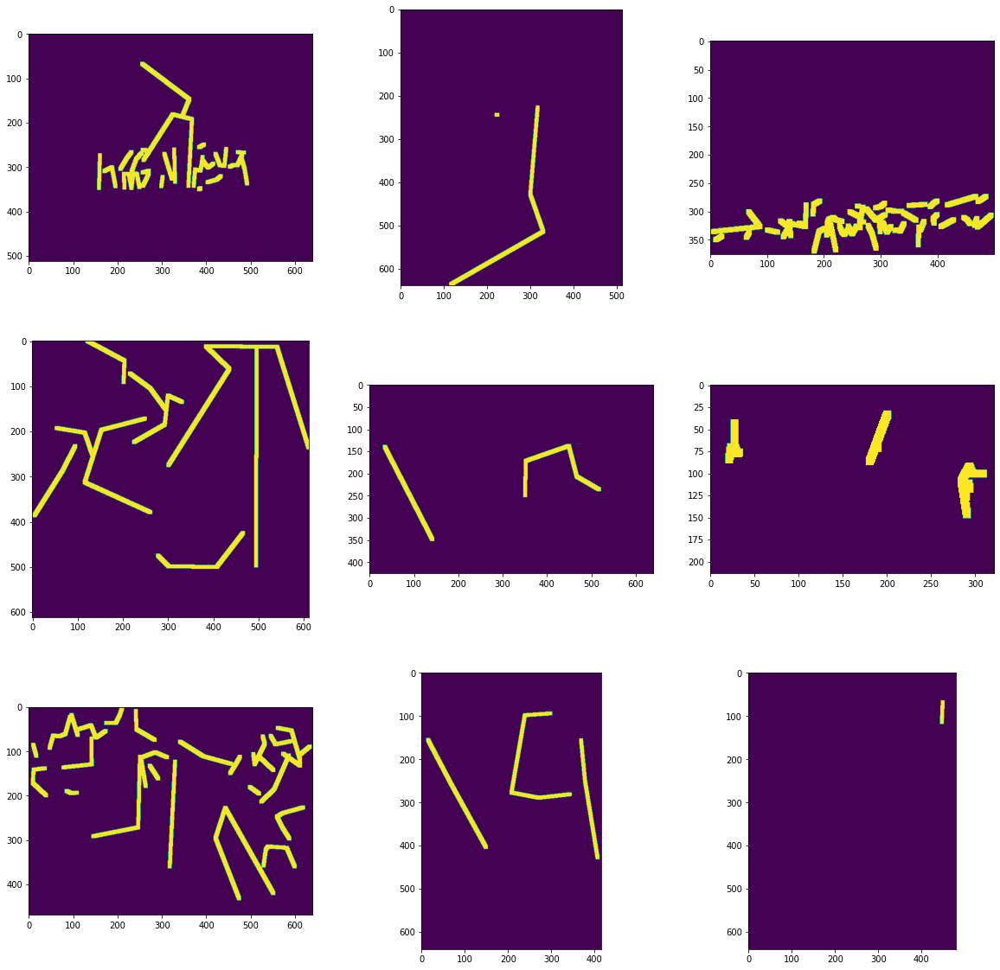

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    x = create_scribble_anno_tri(coco_train, ori[i], 1, 0, 0)
    plt.imshow(x)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:153: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprec

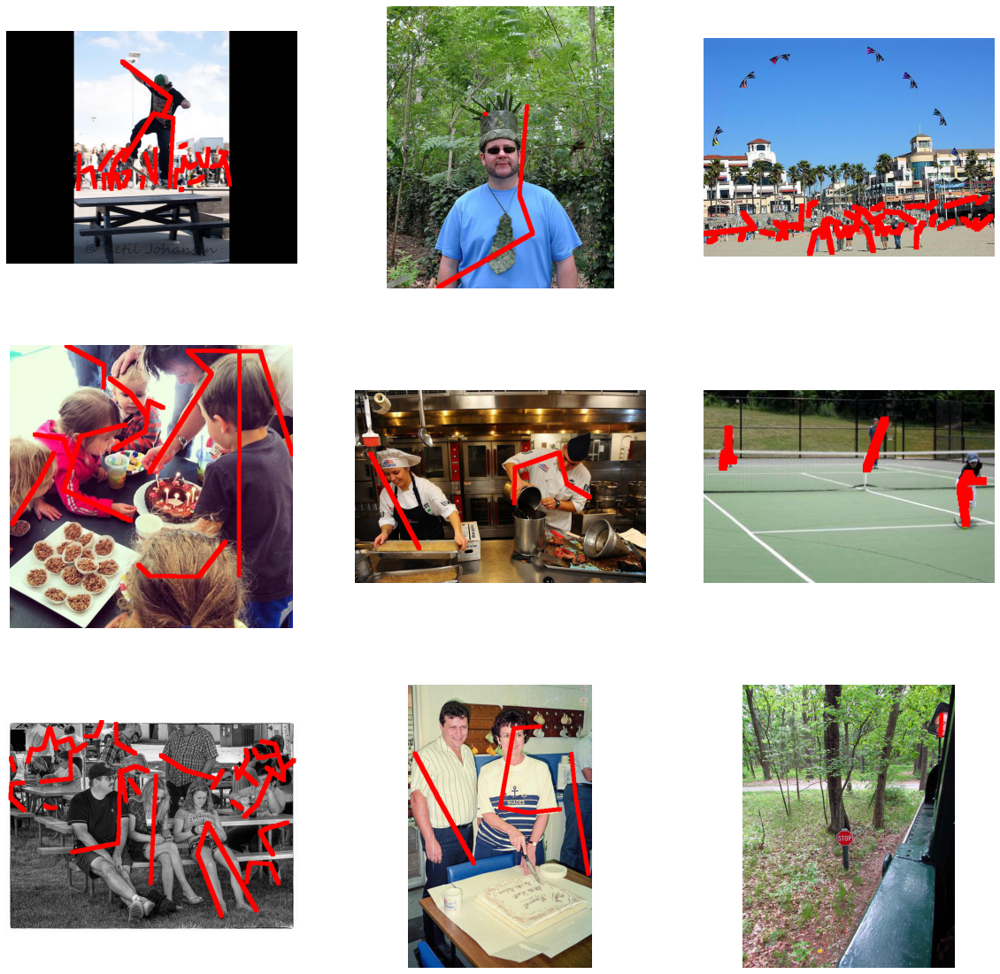

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_tri(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

In [ ]:
def get_hex(s, coef):
    approx = cv2.approxPolyDP(s, coef, True)
    edge = len(approx)
    if edge > 7:
        return get_hex(s, coef * 2)
    else:
        return approx

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
img = ori[0]
height, width = img['height'], img['width']
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
poly_list = []
anns = coco_train.loadAnns(annIds)
for i in range(len(anns)):
    bg = np.zeros((height, width))
    mask = coco_train.annToMask(anns[i])
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    for s in ct:
        poly = get_hex(s, 10)
        poly_list.append(poly)
    break

In [ ]:
def create_mask(coco, anns, height, width):
    mask = np.zeros((height, width))
    # for i in range(len(anns)):
        # mask = np.maximum(coco.annToMask(anns[i])*(i+1), mask) #*255.0
    mask = np.maximum(coco.annToMask(anns[0]), mask) #*255.0
    return np.array(mask)

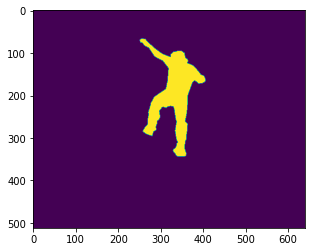

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
img = ori[0]
height, width = img['height'], img['width']
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
mask = create_mask(coco_train, anns, height, width)
plt.imshow(mask)

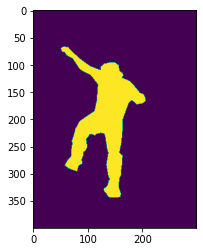

In [ ]:
b = mask[0:400,200:500]
plt.imshow(b)

In [ ]:
x = np.zeros((8,6))
cm_list = []
for i in range(8):
    for j in range(6):
        path = b[50*i:50*(i+1),50*j:50*(j+1)]
        x[i,j] = np.sum(path)
        if x[i,j] > 500:
            c = cm(path)
            p = [int(c[0])+50*i,int(c[1])+50*j]
            cm_list.append(p)


In [ ]:
def plot_point(img, p):
    x,y=p[0],p[1]
    img[x-5:x+5,y-5:y+5]=5
    return img

In [ ]:
from scipy.ndimage.measurements import center_of_mass as cm

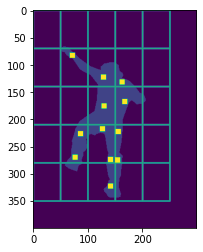

In [ ]:
bb = bbb.copy()
for p in cm_list:
    bb = plot_point(bb, p)
plt.imshow(bb)


In [ ]:
q = np.linspace(0,250,6)
w = np.linspace(0,350,6)
print(q,w)

[  0.  50. 100. 150. 200. 250.] [  0.  70. 140. 210. 280. 350.]


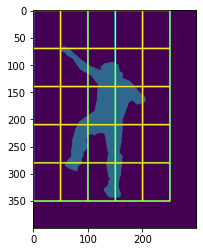

In [ ]:
bbb = b.copy()
for i in q:
    ij = []
    for j in w:
        ij.append(np.array([i,j]).astype(int))
    ij = np.array(ij).reshape(6,2)
    cv2.polylines(bbb,[ij],0,3,2)
for j in w:
    ij = []
    for i in q:
        ij.append(np.array([i,j]).astype(int))
    ij = np.array(ij).reshape(6,2)
    cv2.polylines(bbb,[ij],0,3,2)
plt.imshow(bbb)

In [ ]:
x = np.zeros((4,3))
cm_list = []
for i in range(4):
    for j in range(3):
        path = b[100*i:100*(i+1),100*j:100*(j+1)]
        x[i,j] = np.sum(path)
        if x[i,j] > 1500:
            c = cm(path)
            p = [int(c[0])+100*i,int(c[1])+100*j]
            cm_list.append(p)

In [ ]:
qq = np.linspace(0,300,4)
ww = np.linspace(0,400,5)
qq[-1] = qq[-1] - 1
ww[-1] = ww[-1] - 1
print(qq,ww)

[  0. 100. 200. 299.] [  0. 100. 200. 300. 399.]


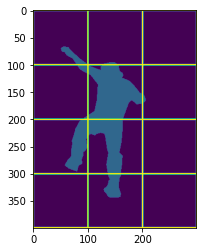

In [ ]:
c = b.copy()
for i in qq:
    ij = []
    for j in ww:
        ij.append(np.array([i,j]).astype(int))
    ij = np.array(ij).reshape(5,2)
    cv2.polylines(c,[ij],0,3,2)
for j in ww:
    ij = []
    for i in qq:
        ij.append(np.array([i,j]).astype(int))
    ij = np.array(ij).reshape(4,2)
    cv2.polylines(c,[ij],0,3,2)
plt.imshow(c)

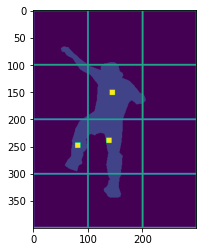

In [ ]:
cc = c.copy()
for p in cm_list:
    cc = plot_point(cc, p)
plt.imshow(cc)


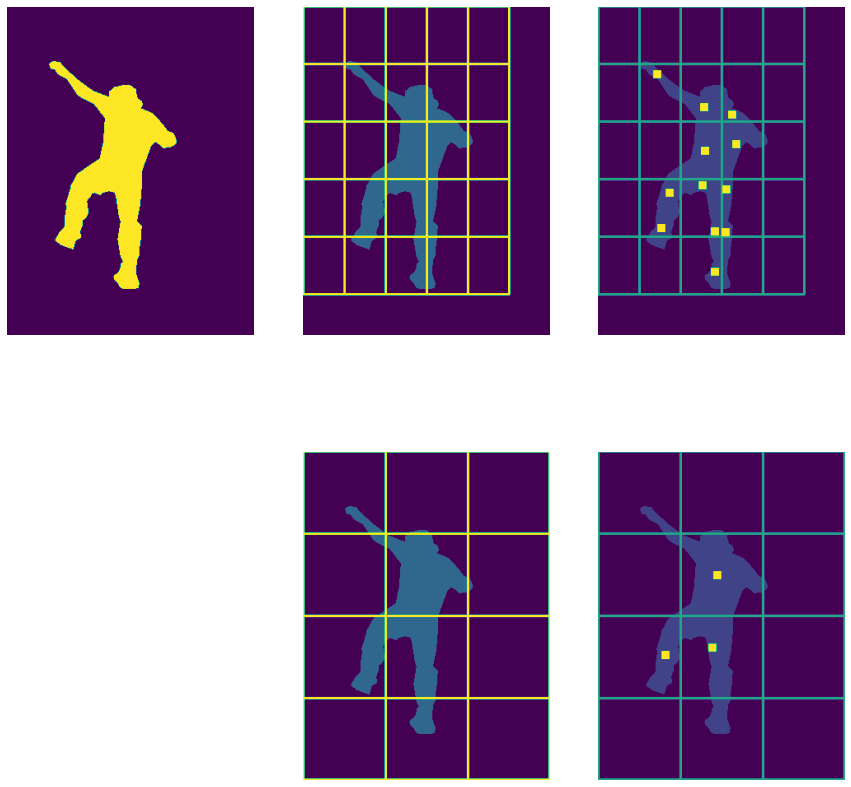

In [ ]:
plt.figure(figsize=(15,15))
plt.subplot(2,3,1)
plt.axis('off')
plt.imshow(b)
plt.subplot(2,3,2)
plt.axis('off')
plt.imshow(bbb)
plt.subplot(2,3,3)
plt.axis('off')
plt.imshow(bb)
plt.subplot(2,3,5)
plt.axis('off')
plt.imshow(c)
plt.subplot(2,3,6)
plt.axis('off')
plt.imshow(cc)

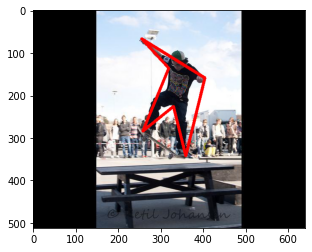

In [ ]:
graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
for poly in poly_list:
    cv2.polylines(graph, [poly], 1, [255,0,0], 5)
plt.imshow(graph)

In [ ]:
polygon = poly_list[0].reshape((6,2))
print(polygon.shape)

(6, 2)


(4, 3, 2)


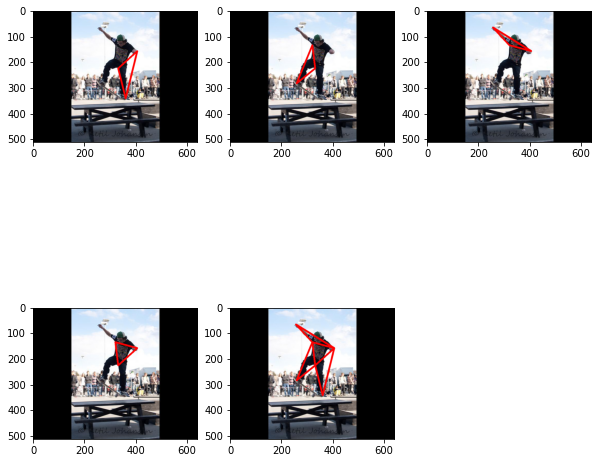

In [ ]:
tri_list = np.array(earclip(polygon))
print(tri_list.shape)
b = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
c = b.copy()
plt.figure(figsize=(10,10))
for i in range(4):
    plt.subplot(2,3,i+1)
    graph = b.copy()
    cv2.polylines(graph, [tri_list[i]], 1, [255,0,0], 5)
    cv2.polylines(c, [tri_list[i]], 1, [255,0,0], 5)
    plt.imshow(graph)
plt.subplot(2,3,5)
plt.imshow(c)

In [ ]:
def other_pts(pts, triangle):
    assert(len(pts)==2)
    for p1 in triangle:
        for p2 in pts:
            if list(p1) == list(p2):
                continue
            else:
                return p1

In [ ]:
print(tri_list[0])

[[404 159]
 [359 342]
 [330 226]]


In [ ]:
t = tri_list[0]
p = t[:2]
print(p)
print(t)

[[404 159]
 [359 342]]
[[404 159]
 [359 342]
 [330 226]]


In [ ]:
print(other_pts(p,t))

[404 159]


In [ ]:
q = np.array([([404, 159], dtype=int32), ([330, 226], dtype=int32)])
print(q)

SyntaxError: ignored

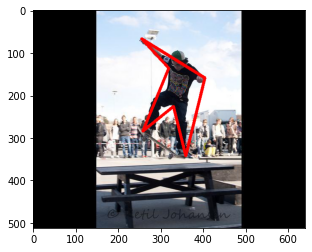

In [ ]:
graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
cv2.polylines(graph, [polygon], 1, [255,0,0], 5)
plt.imshow(graph)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:129: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:131: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprec

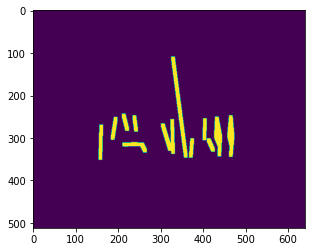

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
x = create_scribble_anno_tri(coco_train, ori[0], 1, 2, 0)
plt.imshow(x)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:119: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:121: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprec

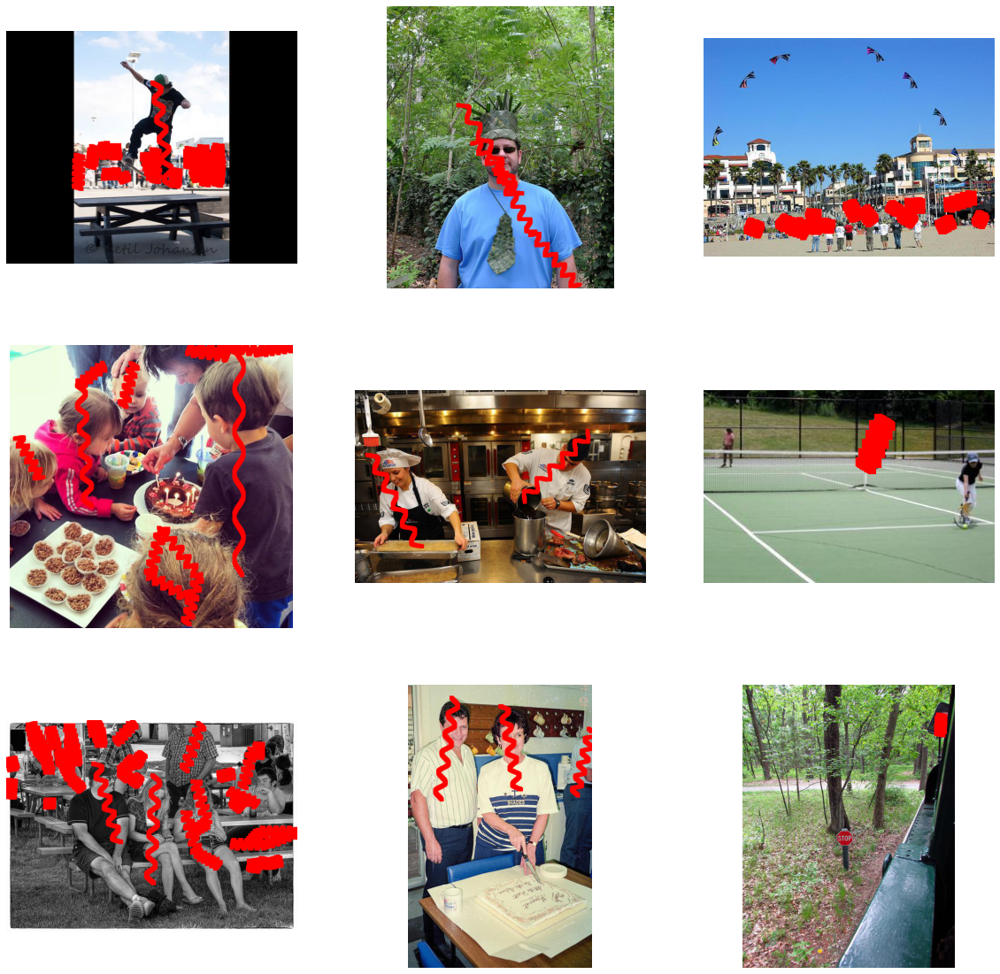

In [ ]:
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_tri(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:129: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:131: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprec

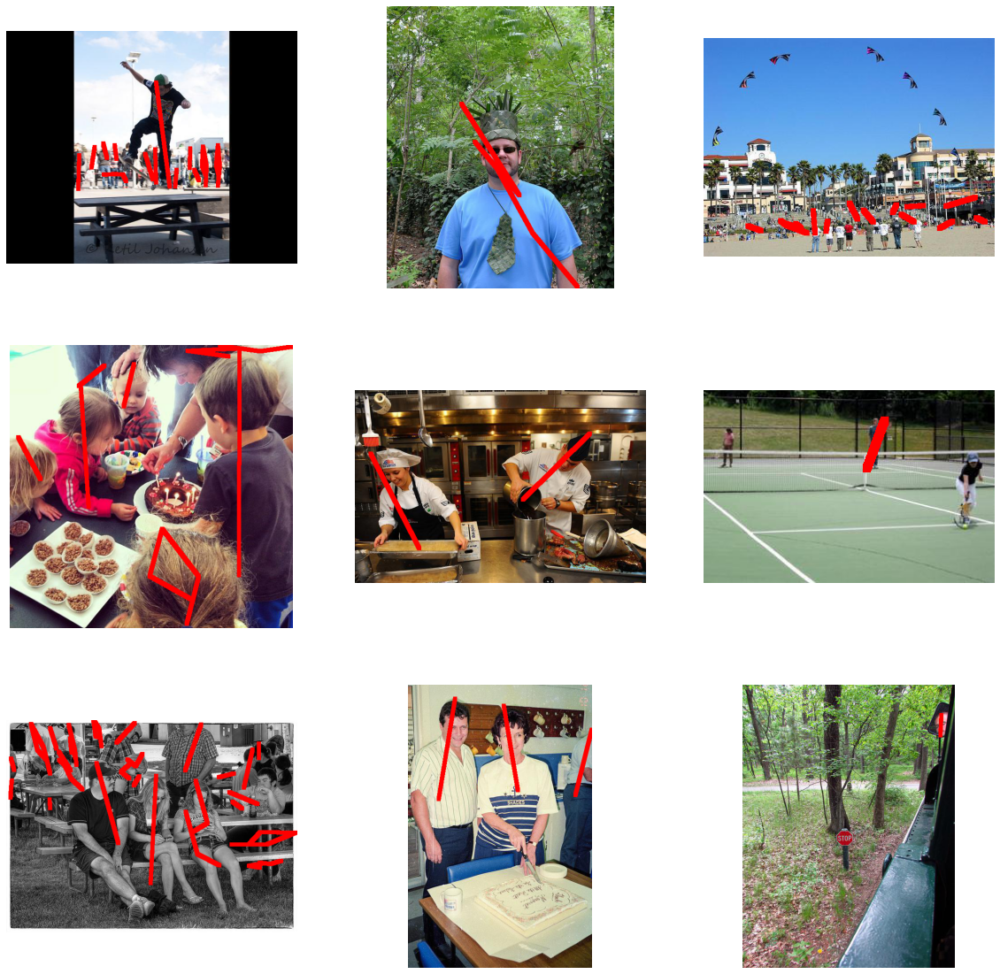

In [ ]:
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_tri(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

In [ ]:
def other_pts(pts, triangle):
    assert(len(pts)==2)
    for p in triangle:
        if p not in pts:
            return p

In [ ]:
q=[1,2,3]
w=q[0,2]
print(w)

TypeError: ignored

In [ ]:

def curve_scribble(pts):
    a1, b1, a2, b2 = pts[0,0], pts[0,1], pts[1,0], pts[1,1]
    x = np.linspace(a1,a2,1000)
    # 1e-7 to avoid 0
    y = (b1-b2)/(a1-a2+1e-7)*(x-a2)+b2
    hypo = np.sqrt((a1-a2)**2+(b1-b2)**2)+1e-7
    i = np.linspace(-hypo/2, hypo/2, 1000)
    # can adjust 10, 33 here to get different curve
    # hypo is the length between pts, 33 is aprox to 10*pi, which is 5 periods curve
    # 10 is amplitude
    j = 10*np.sin(33/hypo*i)
    cos = (a2-a1)/hypo
    sin = (b2-b1)/hypo
    matrix = np.array([[cos,-sin],[sin,cos]])
    z = np.dot(matrix,np.vstack((i,j)))
    anno = np.vstack((z[0]+(a1+a2)/2,z[1]+(b1+b2)/2))
    return anno.T.astype(int)

In [ ]:
def get_polyline(s, coef):
    approx = cv2.approxPolyDP(s, coef, True)
    edge = len(approx)
    if edge > 3:
        return get_polyline(s, coef * 2)
    else:
        return approx

def curve_scribble(pts):
    a1, b1, a2, b2 = pts[0,0], pts[0,1], pts[1,0], pts[1,1]
    x = np.linspace(a1,a2,1000)
    # 1e-7 to avoid 0
    y = (b1-b2)/(a1-a2+1e-7)*(x-a2)+b2
    hypo = np.sqrt((a1-a2)**2+(b1-b2)**2)
    i = np.linspace(-hypo/2, hypo/2, 1000)
    # can adjust 10, 33 here to get different curve
    # hypo is the length between pts, 33 is aprox to 10*pi, which is 5 periods curve
    # 10 is amplitude
    j = 10*np.sin(33/hypo*i)
    cos = (a2-a1)/hypo
    sin = (b2-b1)/hypo
    matrix = np.array([[cos,-sin],[sin,cos]])
    z = np.dot(matrix,np.vstack((i,j)))
    anno = np.vstack((z[0]+(a1+a2)/2,z[1]+(b1+b2)/2))
    return anno.T.astype(int)

def create_scribble_poly(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            apex = get_polyline(s, 10)
            if apex.shape[0] == 1:
                apex = np.repeat(apex, 2, axis = 0)
            if apex.shape[0] == 1 or apex.shape[0] == 2:
                apex = curve_scribble(apex.reshape(2,2))
                cv2.polylines(bg, [apex], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
            else:
                assert(apex.shape[0] == 3)
                apex_poly = apex.reshape(3,2)
                apex_1 = curve_scribble(apex_poly[:2])
                cv2.polylines(bg, [apex_1], 0, 1)
                apex_2 = curve_scribble(apex_poly[1:])
                cv2.polylines(bg, [apex_2], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t
    
def draw_result_poly(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = create_scribble_poly(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

# to show example, useless when generating annotation
def draw_sample_poly(coco, img, img_pos):
    # graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = io.imread(r'{}/{}'.format(img_pos, img['file_name']))
    graph = draw_result_poly(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    graph = draw_result_poly(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

def create_scribble_anno_poly(coco, img, target = 1, background_target = 2, real_background = 0):
    graph = np.zeros((img['height'], img['width'])) * real_background
    add_background = draw_result_poly(coco, range(2,91), img['height'], img['width'], background_target, img, graph)
    add_target = draw_result_poly(coco, [1], img['height'], img['width'], target, img, add_background)
    return add_target

In [ ]:
dataDir = '/gdrive/My Drive/anno'
coco_train = COCO('{}/instances_train2017.json'.format(dataDir))

loading annotations into memory...
Done (t=46.25s)
creating index...
index created!


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in multiply
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:52: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/d

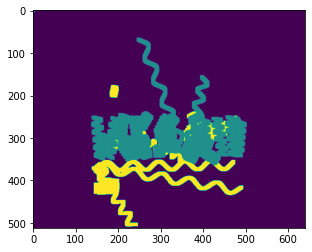

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
x = create_scribble_anno_poly(coco_train, ori[0], 1, 2, 0)
plt.imshow(x)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in multiply
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:52: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/d

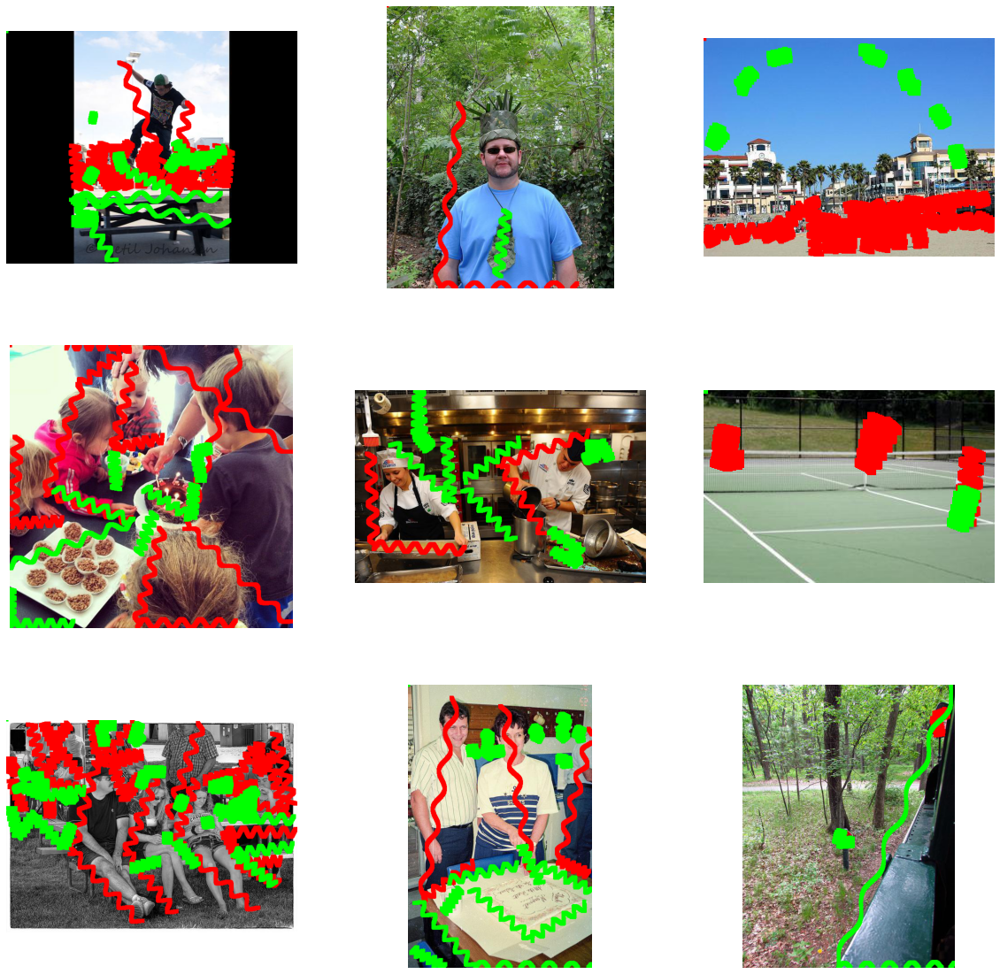

In [ ]:
# samples of generated scribble
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_poly(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

In [ ]:
def get_polyline(s, coef):
    approx = cv2.approxPolyDP(s, coef, True)
    edge = len(approx)
    if edge > 4:
        return get_polyline(s, coef * 2)
    else:
        return approx

def create_scribble_midline(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            apex = get_polyline(s, 1)
            if apex.shape[0] == 1:
                apex = np.repeat(apex, 2, axis = 0)
            if apex.shape[0] == 1 or apex.shape[0] == 2:
                apex = curve_scribble(apex.reshape(2,2))
                cv2.polylines(bg, [apex], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
            elif apex.shape[0] == 3:
                apex_poly = apex.reshape(3,2)
                apex_midline = curve_scribble(np.vstack((apex_poly[0], 0.5*(apex_poly[1]+apex_poly[2]))))
                cv2.polylines(bg, [apex_midline], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
            else:
                assert(apex.shape[0] == 4)
                apex_poly = apex.reshape(4,2)

                p1 = 0.5*(apex_poly[0]+apex_poly[1])
                p2 = 0.5*(apex_poly[1]+apex_poly[2])
                p3 = 0.5*(apex_poly[2]+apex_poly[3])
                p4 = 0.5*(apex_poly[3]+apex_poly[0])
                d1 = np.linalg.norm(p3-p1)
                d2 = np.linalg.norm(p2-p4)
                if d1 > d2:
                    apex_midline = curve_scribble(np.vstack((p1, p3)))
                else:
                    apex_midline = curve_scribble(np.vstack((p2, p4)))
                cv2.polylines(bg, [apex_midline], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t
    
def draw_result_midline(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = create_scribble_midline(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

# to show example, useless when generating annotation
def draw_sample_midline(coco, img, img_pos):
    # graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = io.imread(r'{}/{}'.format(img_pos, img['file_name']))
    graph = draw_result_midline(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    # graph = draw_result_midline(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

def create_scribble_anno_midline(coco, img, target = 1, background_target = 2, real_background = 0):
    graph = np.zeros((img['height'], img['width'])) * real_background
    # add_background = draw_result_midline(coco, range(2,91), img['height'], img['width'], background_target, img, graph)
    add_target = draw_result_midline(coco, [1], img['height'], img['width'], target, img, graph)
    return add_target

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:47: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

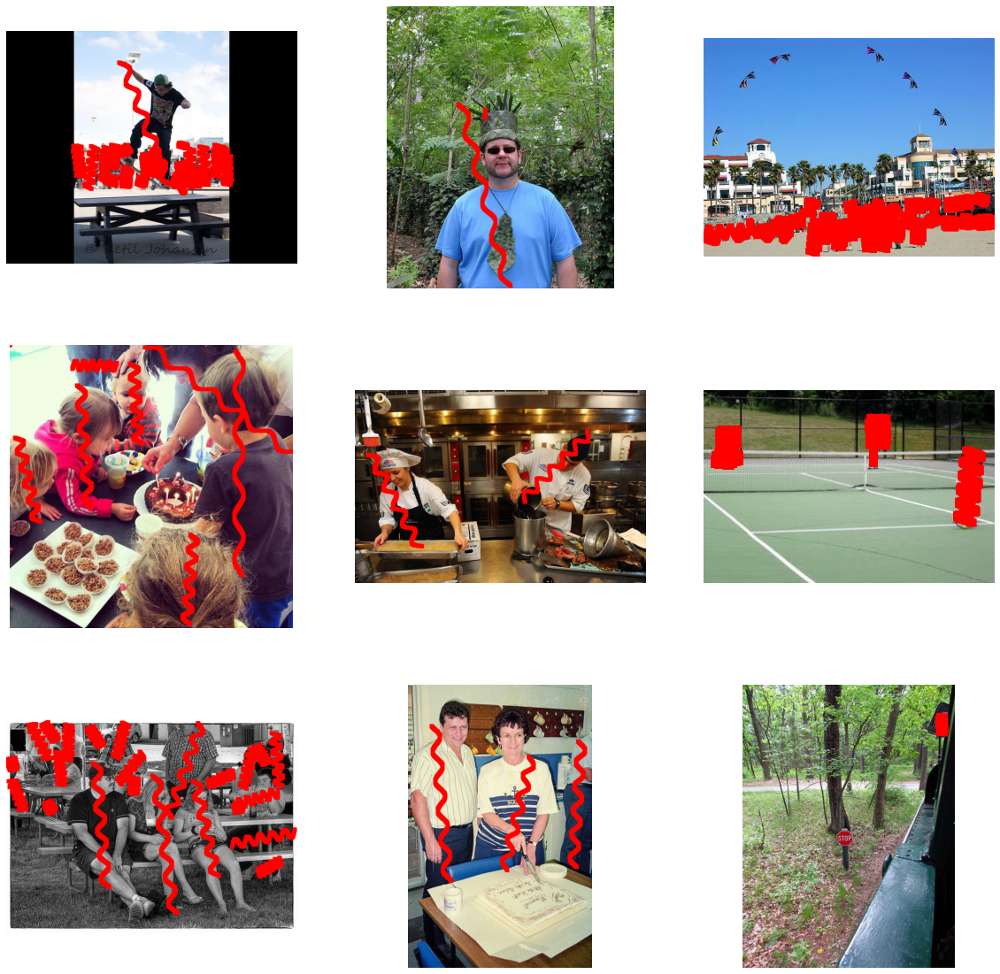

In [ ]:
# samples of generated scribble
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample_midline(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

In [ ]:
q=np.array([1,1])
w=np.array([2,2])
print(np.linalg.norm(q-w))

1.4142135623730951


(3, 1, 2)
[[[255  67]]

 [[359 342]]

 [[404 159]]]


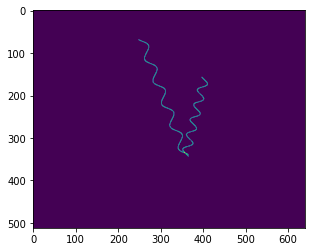

In [ ]:
img = ori[0]
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
height, width = img['height'], img['width']
for i in range(len(anns)):
    bg = np.zeros((height, width))
    
    mask = coco_train.annToMask(anns[i])
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    for s in ct:
        apex = get_polyline(s, 10)
        print(apex.shape)
        print(apex)
        assert(apex.shape[0] == 3)
        apex_poly = apex.reshape(3,2)
        apex_1 = curve_scribble(apex_poly[:2])
        cv2.polylines(bg, [apex_1], 0, 1)
        apex_2 = curve_scribble(apex_poly[1:])
        cv2.polylines(bg, [apex_2], 0, 1)
        plt.imshow(bg)
        break
    break

In [ ]:
def create_scribble_poly(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            apex = get_polyline(s, 10)
            if apex.shape[0] == 1:
                apex = np.repeat(apex, 2, axis = 0)
            if apex.shape[0] == 1 or apex.shape[0] == 2:
                apex = curve_scribble(apex.reshape(2,2))
                cv2.polylines(bg, [apex], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
            else:
                assert(apex.shape[0] == 3)
                apex_poly = apex.reshape(3,2)
                apex_1 = curve_scribble(apex[:2])
                cv2.polylines(bg, [apex_1], 0, 1)
                apex_2 = curve_scribble(apex[1:])
                cv2.polylines(bg, [apex_2], 0, 1)
                im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

In [ ]:
# samples of generated scribble
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample(coco_train, ori[i], r'/gdrive/My Drive/anno/draw')

In [ ]:
# get line from perfect annotation
def get_line(s, coef):
    approx = cv2.approxPolyDP(s, coef, True)
    edge = len(approx)
    if edge > 2:
        return get_line(s, coef * 2)
    else:
        return approx

def get_polyline(s, coef):
    approx = cv2.approxPolyDP(s, coef, True)
    edge = len(approx)
    if edge > 3:
        return get_line(s, coef * 2)
    else:
        return approx

# create scribble for each kind of object
def create_scribble(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            apex = get_line(s, 10)
            cv2.fillPoly(bg, [apex], 1)
            # by changing iterations para here, adjust line thinkness (higher -> thicker)
            im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

# useless function: get thincker line to see more clear
# def create_scribble_show(coco, anns, height, width):
#     im_list = []
#     for i in range(len(anns)):
#         bg = np.zeros((height, width))
#         mask = coco.annToMask(anns[i])
#         x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
#         gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
#         ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
#         ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
#         for s in ct:
#             apex = get_line(s, 10)
#             cv2.fillPoly(bg, [apex], 1)
#             im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 10))
#     t = im_list[0].astype(np.int).flatten()
#     for i in range(1,len(im_list)):
#         t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
#     t = t.reshape((height, width)) 
#     return t

# draw scribble and add it to graph para (e.g origin image, annotation for one target)
def draw_result(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = create_scribble(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

# to show example, useless when generating annotation
def draw_sample(coco, img, img_pos):
    # graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = io.imread(r'{}/{}'.format(img_pos, img['file_name']))
    graph = draw_result(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    graph = draw_result(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

# this is the main function
# add targets together
# target is the value in annotation for human scribble, background_target for bg, real_background for nothing
# there are some overlap between target and bg_target, I always let target overwrite bg_target; if you want otherwise, just switch line assigned add_background and add_target
def create_scribble_anno(coco, img, target = 1, background_target = 2, real_background = 0):
    graph = np.zeros((img['height'], img['width'])) * real_background
    add_background = draw_result(coco, range(2,91), img['height'], img['width'], background_target, img, graph)
    add_target = draw_result(coco, [1], img['height'], img['width'], target, img, add_background)
    return add_target

In [ ]:
def create_mask(coco, anns, height, width):
    mask = np.zeros((height, width))
    for i in range(len(anns)):
        mask = np.maximum(coco.annToMask(anns[i]), mask) * 255.0
    mask = Image.fromarray(mask)

    return mask

def create_poly_1(coco, anns, height, width,rt):
    masks = np.zeros((height, width))    
    for i in range(len(anns)):
        mask = coco.annToMask(anns[i]) * 255.0
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            approx = cv2.approxPolyDP(s, rt*cv2.arcLength(s, True), True)
            cv2 .fillPoly(masks,[approx],(255,255,255))
    masks = Image.fromarray(masks)
    return masks

def create_poly_2(coco, anns, height, width,rt):
    masks = np.zeros((height, width))    
    for i in range(len(anns)):
        mask = coco.annToMask(anns[i]) * 255.0
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            approx = cv2.approxPolyDP(s, rt, True)
            cv2 .fillPoly(masks,[approx],(255,255,255))
    masks = Image.fromarray(masks)
    return masks

def create_poly_known(coco, anns, height, width, edge):
    masks = np.zeros((height, width)) 
    num = len(anns)   
    for i in range(num):
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            approx = cv2.approxPolyDP(s, 0.8, True)
            print(approx)

def linear_search(s, start, end, check, store):
    i = np.linspace(start, end, 20)
    for r in i:
        approx = cv2.approxPolyDP(s, r, True)
        edge = len(approx)
        idx = e2i(edge)
        if idx == -1:
            continue
        if check[idx] == -1:
            # print(r, edge, idx)
            check[idx] = r
            store[idx].append(approx)
    return check, store

def dichotomy_init(s, start, end, s_init, check, store, ct):
    mid = (start + end) * 0.5
    approx = cv2.approxPolyDP(s, mid, True)
    ct += 1
    if ct >= 900:
        if s_init:
            if check[0] == -1:
                check[0] = mid
                store[0].append(approx)
                #print('stuck in start 2')
        else:
            if check[7] == -1:
                check[7] = mid
                store[7].append(approx)
                #print('stuck in end 2')

        return start, check, store
    edge = len(approx)
    if s_init:
        if edge == 3:
            if check[0] == -1:
                check[0] = mid
                store[0].append(approx)
            return mid, check, store
        elif edge < 3:
            return dichotomy_init(s, mid, end, 1, check, store, ct)
        else:
            if edge <= 10:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = mid
                    store[idx].append(approx)
            return dichotomy_init(s, start, mid, 1, check, store, ct)
    else:
        if edge == 10:
            if check[7] == -1:
                check[7] = mid
                store[7].append(approx)
            return mid, check, store
        elif edge > 10:
            return dichotomy_init(s, start, mid, 0, check, store, ct)
        else:
            if edge >= 3:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = mid
                    store[idx].append(approx)
            return dichotomy_init(s, mid, end, 0, check, store, ct)

def start_init(s, start, check, store, ct):
    approx = cv2.approxPolyDP(s, start, True)
    edge = len(approx)
    if edge == 3:
        if check[0] == -1:
            check[0] = start
            store[0].append(approx)
        return start, check, store
    else: 
        ct += 1
        if ct >= 900:
            check[0] = start
            store[0].append(approx)
            #print('stuck in start 1')
            return start, check, store
        if edge < 3:
            return start_init(s, 0.1*start, check, store, ct)
        else:
            if edge <= 10:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = start
                    store[idx].append(approx)
            return dichotomy_init(s, start * 10, start, 1, check, store, ct)

def end_init(s, end, check, store, ct):
    approx = cv2.approxPolyDP(s, end, True)
    edge = len(approx)
    if edge == 10:
        if check[7] == -1:
            check[7] = end
            store[7].append(approx)
        return end, check, store
    else: 
        ct += 1
        if ct >= 900:
            check[7] = end
            store[7].append(approx)
            #print('stuck in end 1')
            return end, check, store
        if edge > 10:
            return end_init(s, 10*end, check, store, ct)
        else:
            if edge >= 3:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = end
                    store[idx].append(approx)
            return dichotomy_init(s, end, end*0.1, 0, check, store, ct)

# def end_init(s, end):
#     approx = cv2.approxPolyDP(s, end, True)
#     edge = len(approx)
#     if edge > 10:
#         return end_init(s, 4*end)
#     else:
#         return end * 0.25

def dichotomy(s, start, end, check, store, ct):
    ct += 1
    if ct >= 900:
        check, store = fill_hole(check, store)
        #print('stuck in hole')
        return check, store, 0
    mid = (start + end) * 0.5
    approx = cv2.approxPolyDP(s, mid, True)
    edge = len(approx)
    # print('-----------')
    # print(edge)
    # print(check)
    # print(mid)
    if edge >= 3 and edge <= 10:
        idx = e2i(edge)
        if check[idx] == -1:
            check[idx] = mid
            store[idx].append(approx)
        if -1 in check[idx:]:
            check, store, ct = dichotomy(s, mid, end, check, store, ct)
        if -1 in check[:idx]:
            check, store, ct = dichotomy(s, start, mid, check, store, ct)
    elif edge < 3:
        check, store, ct = dichotomy(s, mid, end, check, store, ct)
    else:
        check, store, ct = dichotomy(s, start, mid, check, store, ct)
        
    return check, store, ct

def fill_hole(check, store):
    if check[0] != -1:
        for i in range(8):
            if check[i] == -1:
                check[i] = check[i-1]
                store[i].append(store[i-1][-1])
    elif check[7] != -1:
        for i in range(8):
            if check[7-i] == -1:
                check[7-i] = check[8-i]
                store[7-1].append(store[8-i][-1])
    else:
        print('cannt fill hole')
    return check, store

def fix_line(check, store):
    if len(store[7][-1]) == 2:
        print('fail sh')
    for i in range(7):
        if len(store[6-i][-1]) == 2:
            check[6-i] = check[7-i]
            store[6-i][-1] = store[7-1][-1]
        
    return check, store
        
def e2i(x):
  if x in [3, 4, 5, 6, 7, 8, 9, 10]:
      return x-3
  else:
      print('xx')
      return -1

def e2i_2(x):
  if x in [11, 12, 13, 14, 15]:
      return x-11
  else:
      print('xx')
      return -1

def draw_poly(mask, pts):
    cv2 .fillPoly(mask,[pts],(255,255,255))
    return mask

In [ ]:
# 11-15 version
def create_mask(coco, anns, height, width):
    mask = np.zeros((height, width))
    for i in range(len(anns)):
        mask = np.maximum(coco.annToMask(anns[i]), mask) * 255.0
    mask = Image.fromarray(mask)

    return mask

def create_poly_1(coco, anns, height, width,rt):
    masks = np.zeros((height, width))    
    for i in range(len(anns)):
        mask = coco.annToMask(anns[i]) * 255.0
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            approx = cv2.approxPolyDP(s, rt*cv2.arcLength(s, True), True)
            cv2 .fillPoly(masks,[approx],(255,255,255))
    masks = Image.fromarray(masks)
    return masks

def create_poly_2(coco, anns, height, width,rt):
    masks = np.zeros((height, width))    
    for i in range(len(anns)):
        mask = coco.annToMask(anns[i]) * 255.0
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            approx = cv2.approxPolyDP(s, rt, True)
            cv2 .fillPoly(masks,[approx],(255,255,255))
    masks = Image.fromarray(masks)
    return masks

def create_poly_known(coco, anns, height, width, edge):
    masks = np.zeros((height, width)) 
    num = len(anns)   
    for i in range(num):
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            approx = cv2.approxPolyDP(s, 0.8, True)
            print(approx)

def linear_search(s, start, end, check, store):
    i = np.linspace(start, end, 20)
    for r in i:
        approx = cv2.approxPolyDP(s, r, True)
        edge = len(approx)
        idx = e2i(edge)
        if idx == -1:
            continue
        if check[idx] == -1:
            # print(r, edge, idx)
            check[idx] = r
            store[idx].append(approx)
    return check, store

def dichotomy_init(s, start, end, s_init, check, store, ct):
    mid = (start + end) * 0.5
    approx = cv2.approxPolyDP(s, mid, True)
    ct += 1
    if ct >= 900:
        if s_init:
            if check[0] == -1:
                check[0] = mid
                store[0].append(approx)
                #print('stuck in start 2')
        else:
            if check[4] == -1:
                check[4] = mid
                store[4].append(approx)
                #print('stuck in end 2')

        return start, check, store
    edge = len(approx)
    if s_init:
        if edge == 11:
            if check[0] == -1:
                check[0] = mid
                store[0].append(approx)
            return mid, check, store
        elif edge < 11:
            return dichotomy_init(s, mid, end, 1, check, store, ct)
        else:
            if edge <= 15:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = mid
                    store[idx].append(approx)
            return dichotomy_init(s, start, mid, 1, check, store, ct)
    else:
        if edge == 15:
            if check[4] == -1:
                check[4] = mid
                store[4].append(approx)
            return mid, check, store
        elif edge > 15:
            return dichotomy_init(s, start, mid, 0, check, store, ct)
        else:
            if edge >= 11:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = mid
                    store[idx].append(approx)
            return dichotomy_init(s, mid, end, 0, check, store, ct)

def start_init(s, start, check, store, ct):
    approx = cv2.approxPolyDP(s, start, True)
    edge = len(approx)
    if edge == 11:
        if check[0] == -1:
            check[0] = start
            store[0].append(approx)
        return start, check, store
    else: 
        ct += 1
        if ct >= 900:
            check[0] = start
            store[0].append(approx)
            #print('stuck in start 1')
            return start, check, store
        if edge < 11:
            return start_init(s, 0.1*start, check, store, ct)
        else:
            if edge <= 15:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = start
                    store[idx].append(approx)
            return dichotomy_init(s, start * 10, start, 1, check, store, ct)

def end_init(s, end, check, store, ct):
    approx = cv2.approxPolyDP(s, end, True)
    edge = len(approx)
    if edge == 15:
        if check[4] == -1:
            check[4] = end
            store[4].append(approx)
        return end, check, store
    else: 
        ct += 1
        if ct >= 900:
            check[4] = end
            store[4].append(approx)
            #print('stuck in end 1')
            return end, check, store
        if edge > 15:
            return end_init(s, 10*end, check, store, ct)
        else:
            if edge >= 11:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = end
                    store[idx].append(approx)
            return dichotomy_init(s, end, end*0.1, 0, check, store, ct)

# def end_init(s, end):
#     approx = cv2.approxPolyDP(s, end, True)
#     edge = len(approx)
#     if edge > 10:
#         return end_init(s, 4*end)
#     else:
#         return end * 0.25

def dichotomy(s, start, end, check, store, ct):
    ct += 1
    if ct >= 900:
        check, store = fill_hole(check, store)
        #print('stuck in hole')
        return check, store, 0
    mid = (start + end) * 0.5
    approx = cv2.approxPolyDP(s, mid, True)
    edge = len(approx)
    # print('-----------')
    # print(edge)
    # print(check)
    # print(mid)
    if edge >= 11 and edge <= 15:
        idx = e2i(edge)
        if check[idx] == -1:
            check[idx] = mid
            store[idx].append(approx)
        if -1 in check[idx:]:
            check, store, ct = dichotomy(s, mid, end, check, store, ct)
        if -1 in check[:idx]:
            check, store, ct = dichotomy(s, start, mid, check, store, ct)
    elif edge < 11:
        check, store, ct = dichotomy(s, mid, end, check, store, ct)
    else:
        check, store, ct = dichotomy(s, start, mid, check, store, ct)
        
    return check, store, ct

def fill_hole(check, store):
    if check[0] != -1:
        for i in range(5):
            if check[i] == -1:
                check[i] = check[i-1]
                store[i].append(store[i-1][-1])
    elif check[4] != -1:
        for i in range(5):
            if check[4-i] == -1:
                check[4-i] = check[5-i]
                store[4-1].append(store[5-i][-1])
    else:
        print('cannt fill hole')
    return check, store

def fix_line(check, store):
    if len(store[4][-1]) == 2:
        print('fail sh')
    for i in range(4):
        if len(store[3-i][-1]) == 2:
            check[3-i] = check[4-i]
            store[3-i][-1] = store[4-1][-1]
        
    return check, store
        
# def e2i(x):
#   if x in [3, 4, 5, 6, 7, 8, 9, 10]:
#       return x-3
#   else:
#       print('xx')
#       return -1

def e2i(x):
  if x in [11, 12, 13, 14, 15]:
      return x-11
  else:
      print('xx')
      return -1

def draw_poly(mask, pts):
    cv2 .fillPoly(mask,[pts],(255,255,255))
    return mask

In [ ]:
def get_line(s, coef):
    approx = cv2.approxPolyDP(s, coef, True)
    edge = len(approx)
    if edge > 2:
        return get_line(s, coef * 2)
    else:
        return approx

def create_scribble(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            apex = get_line(s, 10)
            cv2.fillPoly(bg, [apex], 1)
            im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

def create_scribble_curve(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            apex = get_line(s, 10)
            if apex.shape[0] == 1:
                apex = np.repeat(apex, 2, axis = 0)
            apex = curve_scribble(apex.reshape(2,2))
            cv2.polylines(bg, [apex], 0, 1)
            im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

def create_scribble_show(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            apex = get_line(s, 10)
            cv2.fillPoly(bg, [apex], 1)
            im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 10))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

def draw_result(coco, catIds, height, width, color, img, graph):
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    scribble = create_scribble_curve(coco, anns, height, width)
    for i in range(height):
        for j in range(width):
            if scribble[i, j] == 1:
                graph[i, j] = color
    return graph

def draw_sample(coco, img):
    graph = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
    graph = draw_result(coco, [1], img['height'], img['width'], [255,0,0], img, graph)
    graph = draw_result(coco, range(2,91), img['height'], img['width'], [0,255,0], img, graph)
    plt.imshow(graph)
    plt.axis('off')

def create_scribble_anno(coco, img, target, background_target, real_background):
    graph = np.zeros((img['height'], img['width'])) * real_background
    add_background = draw_result(coco, range(2,91), img['height'], img['width'], background_target, img, graph)
    add_target = draw_result(coco, [1], img['height'], img['width'], target, img, add_background)
    return add_target

def curve_scribble(pts):
    a1, b1, a2, b2 = pts[0,0], pts[0,1], pts[1,0], pts[1,1]
    x = np.linspace(a1,a2,1000)
    y = (b1-b2)/(a1-a2+1e-7)*(x-a2)+b2
    hypo = np.sqrt((a1-a2)**2+(b1-b2)**2)
    i = np.linspace(-hypo/2, hypo/2, 1000)
    j = 10*np.sin(33/hypo*i)
    cos = (a2-a1)/hypo
    sin = (b2-b1)/hypo
    matrix = np.array([[cos,-sin],[sin,cos]])
    z = np.dot(matrix,np.vstack((i,j)))
    anno = np.vstack((z[0]+(a1+a2)/2,z[1]+(b1+b2)/2))
    return anno.T.astype(int)

In [ ]:
dataDir = '/gdrive/My Drive/anno'
coco_train = COCO('{}/instances_train2017.json'.format(dataDir))
catIDs_train = coco_train.getCatIds()
cats_train = coco_train.loadCats(catIDs_train)

loading annotations into memory...
Done (t=45.57s)
creating index...
index created!


In [ ]:
def create_scribble_curve(coco, anns, height, width):
    im_list = []
    for i in range(len(anns)):
        bg = np.zeros((height, width))
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            apex = get_line(s, 10)
            print(apex, apex.reshape(2,2))
            if apex.shape[0] == 1:
                apex = np.repeat(apex, 2, axis = 0)
            apex = curve_scribble(apex.reshape(2,2))
            print(apex)
            cv2.polylines(bg, [apex], 0, 1)
            plt.imshow(bg)
            return apex
            im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
    t = im_list[0].astype(np.int).flatten()
    for i in range(1,len(im_list)):
        t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
    t = t.reshape((height, width)) 
    return t

[[[255  67]]

 [[359 342]]] [[255  67]
 [359 342]]
[[248  69]
 [248  69]
 [248  69]
 ...
 [365 339]
 [365 339]
 [365 339]]


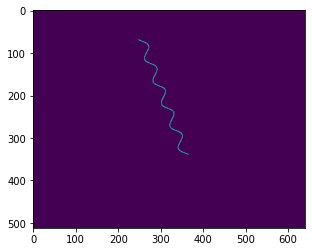

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
img = ori[0]
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
# scribble = create_scribble_curve(coco_train, anns, img['height'], img['width'])
# plt.imshow(scribble)
scribble = create_scribble_curve(coco_train, anns, img['height'], img['width'])

In [ ]:
print(scribble[:10])

[[197 -82]
 [197 -81]
 [198 -81]
 [198 -80]
 [199 -80]
 [200 -80]
 [200 -79]
 [200 -78]
 [200 -78]
 [200 -77]]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:22: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

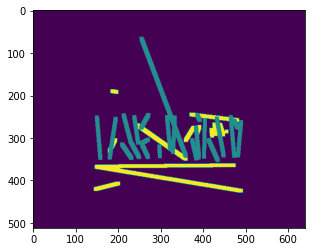

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
x = create_scribble_anno(coco_train, ori[0], 1, 2, 0)
plt.imshow(x)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:22: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

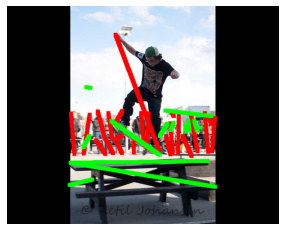

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
draw_sample(coco_train, ori[0])

In [ ]:
x=np.ones((1,1,2))
z=np.sum(x.shape)
if z != 5:
    x = np.repeat(x,2, axis=0)
print(x.shape)

(2, 1, 2)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:98: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:98: RuntimeWarning: invalid value encountered in multiply
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:99: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:100: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/

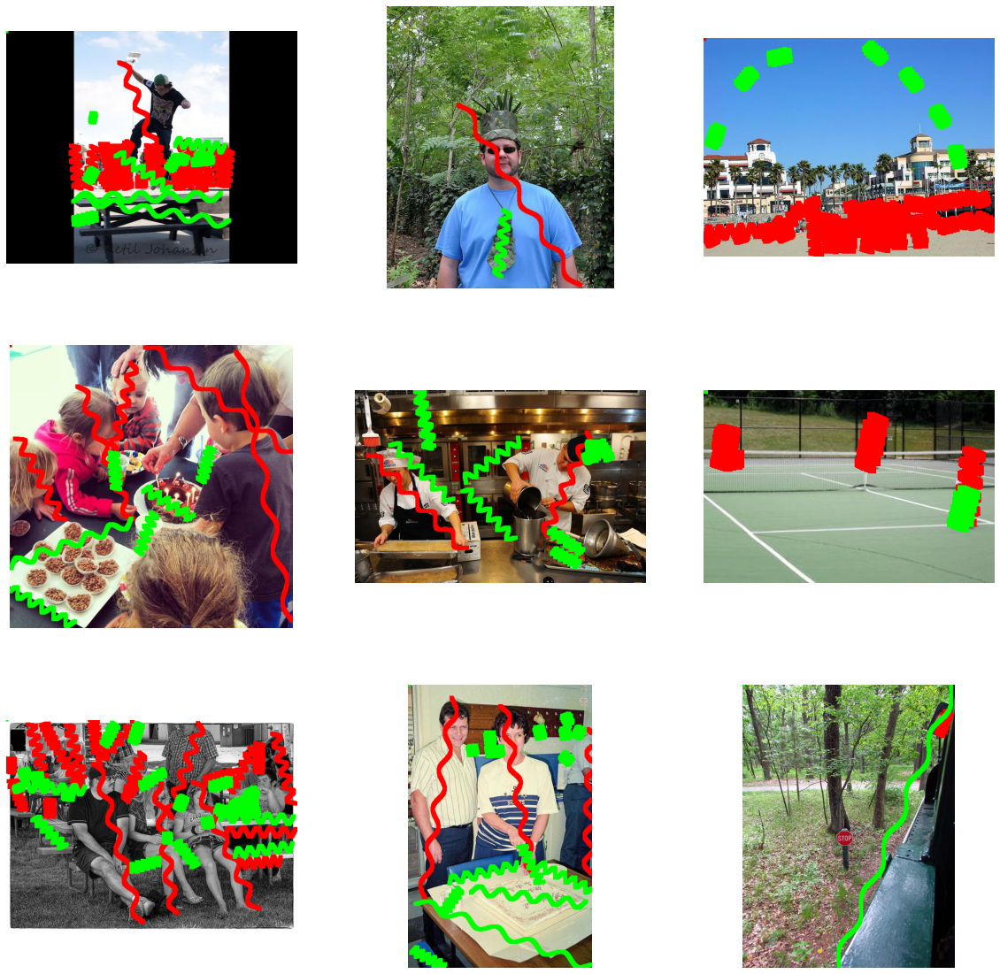

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample(coco_train, ori[i])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:22: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

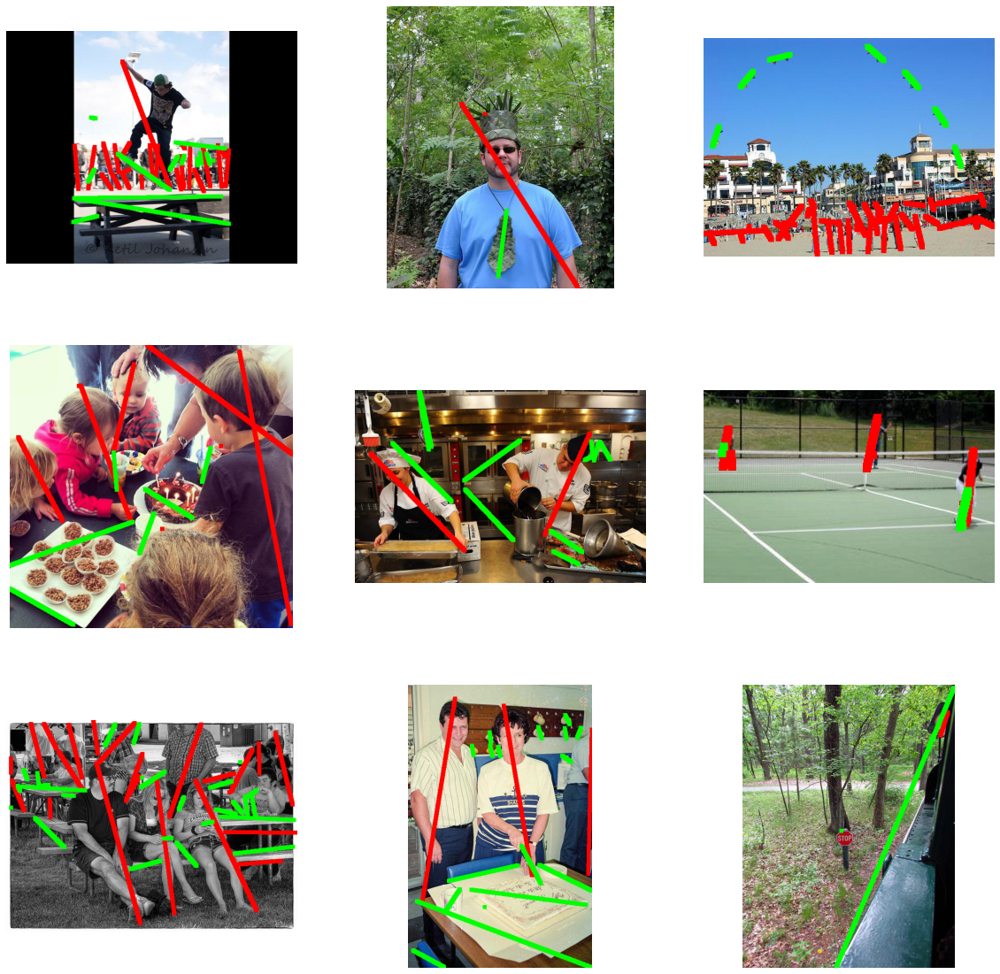

In [ ]:
plt.figure(figsize=(20,20))
for i in range(9):
    plt.subplot(3,3,i+1)
    draw_sample(coco_train, ori[i])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:22: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

(-0.5, 499.5, 374.5, -0.5)

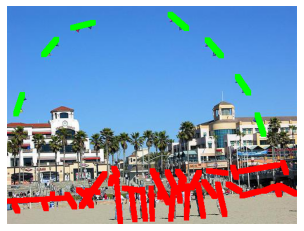

In [ ]:
img = ori[2]
I = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
g = I.copy()
g = draw_result(coco_train, [1], img['height'], img['width'], [255,0,0],g)
g = draw_result(coco_train, range(2,91), img['height'], img['width'], [0,255,0],g)
plt.imshow(g)
plt.axis('off')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:22: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

(-0.5, 479.5, 639.5, -0.5)

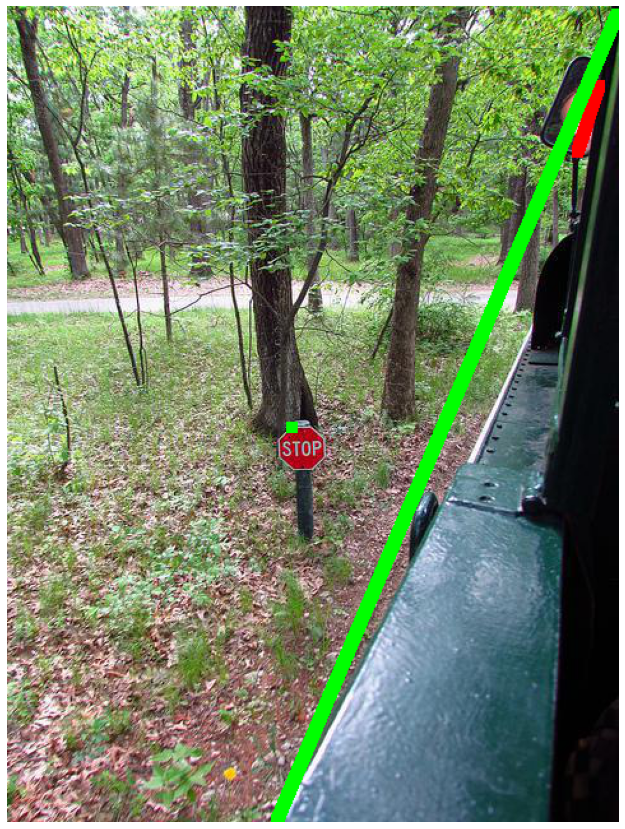

In [ ]:

img = ori[8]
I = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
g = I.copy()
g = draw_result(coco_train, [1], img['height'], img['width'], [255,0,0],g)
g = draw_result(coco_train, range(2,91), img['height'], img['width'], [0,255,0],g)
plt.figure(figsize=(15,15))
plt.imshow(g)
plt.axis('off')

In [ ]:
for i in range(9):
    

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:22: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

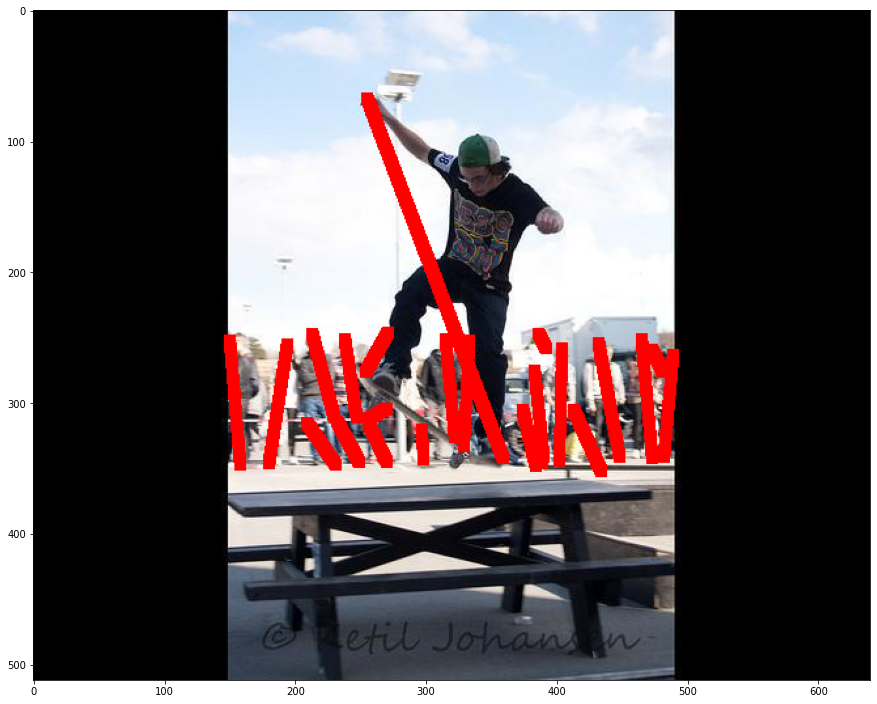

In [ ]:
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
x = create_scribble(coco_train, anns, img['height'], img['width'])
ii = I.copy()
plt.figure(figsize=(15,15))
for xx in range(img['height']):
    for yy in range(img['width']):
        if x[xx, yy] == 1:
            ii[xx, yy] = [255, 0, 0]
plt.imshow(ii)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:22: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

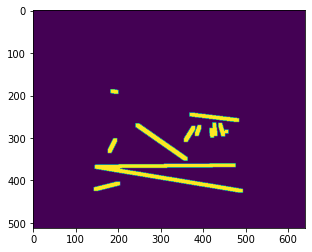

In [ ]:
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=np.arange(2,91), iscrowd=None)
anns = coco_train.loadAnns(annIds)
x = create_scribble(coco_train, anns, img['height'], img['width'])
plt.imshow(x)

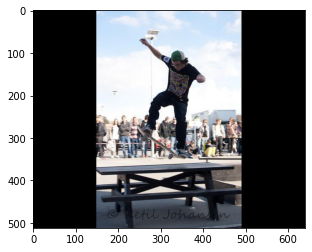

In [ ]:
plt.imshow(I)

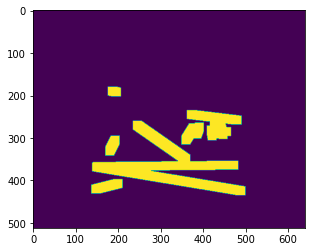

In [ ]:
plt.imshow(x)

In [ ]:
print(np.max(x))

1


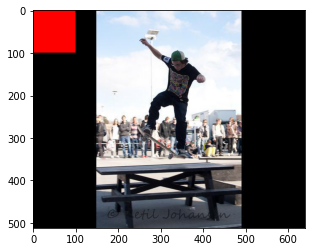

In [ ]:
ii = I.copy()
for q in range(100):
    for w in range(100):
        ii[q,w]=[255,0,0]
plt.imshow(ii)

327680 12197


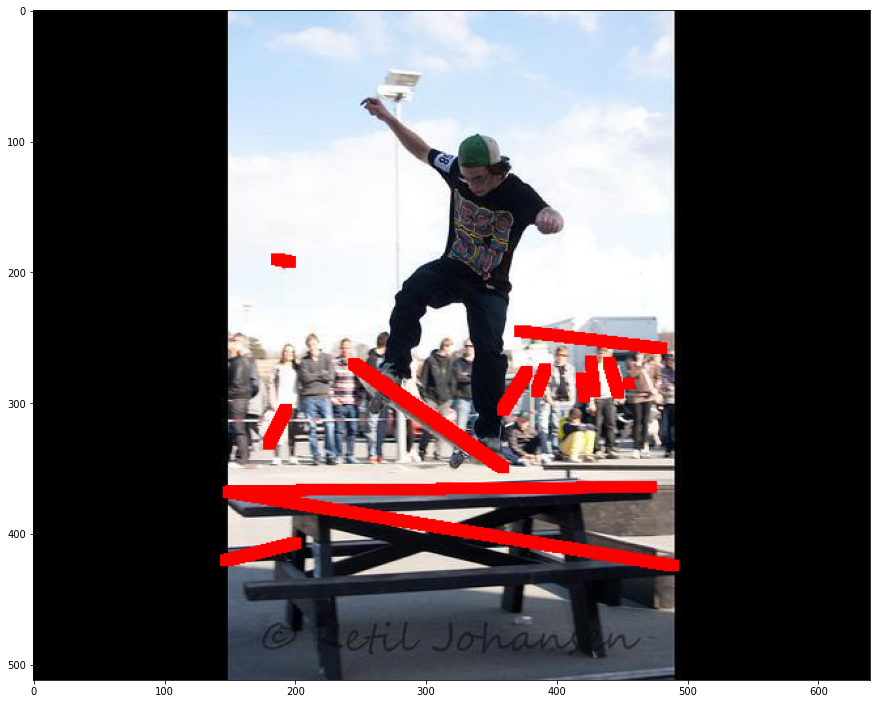

In [ ]:
c1 = 0
c2 = 0
ii = I.copy()
plt.figure(figsize=(15,15))
for xx in range(img['height']):
    for yy in range(img['width']):
        c1 += 1
        if x[xx, yy] == 1:
            c2 += 1
            ii[xx, yy] = [255, 0, 0]
plt.imshow(ii)
print(c1,c2)

In [ ]:
dataDir = '/gdrive/My Drive/anno'
coco_train = COCO('{}/instances_train2017.json'.format(dataDir))
catIDs_train = coco_train.getCatIds()
cats_train = coco_train.loadCats(catIDs_train)

NameError: ignored

In [ ]:
print(catIDs_train)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 67, 70, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 84, 85, 86, 87, 88, 89, 90]


In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
img = ori[0]
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)

(-0.5, 639.5, 511.5, -0.5)

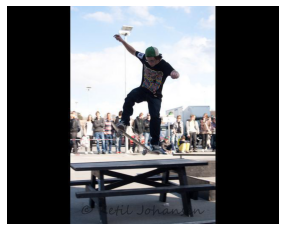

In [ ]:
I = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
plt.imshow(I)
plt.axis('off')

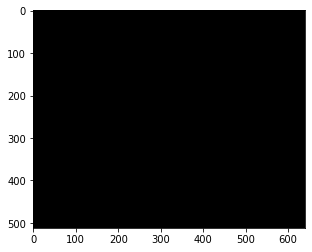

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
img = ori[0]
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[91], iscrowd=None)
anns = coco_train.loadAnns(annIds)
I = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
# plt.imshow(I)
# plt.axis('off')
m = create_mask(coco_train, anns, img['height'], img['width'])
plt.imshow(m)

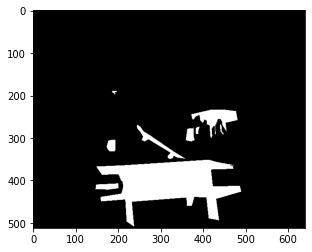

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
img = ori[0]
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=np.arange(2,91), iscrowd=None)
anns = coco_train.loadAnns(annIds)
I = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
# plt.imshow(I)
# plt.axis('off')
m = create_mask(coco_train, anns, img['height'], img['width'])
plt.imshow(m)

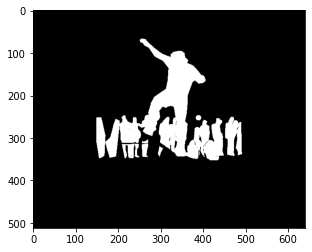

In [ ]:
m = create_mask(coco_train, anns, img['height'], img['width'])
plt.imshow(m)

(-0.5, 639.5, 511.5, -0.5)

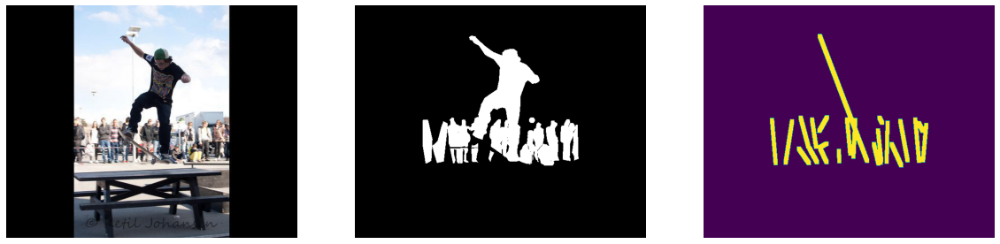

In [ ]:
plt.figure(figsize=(20,20))
plt.subplot(1,3,1)
I = io.imread(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']))
plt.imshow(I)
plt.axis('off')
plt.subplot(1,3,2)
m = create_mask(coco_train, anns, img['height'], img['width'])
plt.imshow(m)
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(t)
plt.axis('off')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Depre

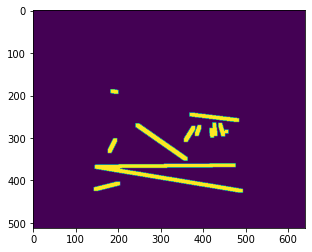

In [ ]:
total = I.copy()
im_list = []
for i in range(len(anns)):
    bg = np.zeros((img['height'], img['width']))
    mask = coco_train.annToMask(anns[i])
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    for s in ct:
        apex = get_line(s, 10)
        cv2.fillPoly(bg, [apex], 1)
        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
t = im_list[0].astype(np.int).flatten()
for i in range(1,len(im_list)):
    t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
t = t.reshape((img['height'], img['width']))
plt.imshow(t)

In [ ]:
# bg = np.zeros((img['height'], img['width']))
total = I.copy()
im_list = []
for i in range(len(anns)):
    bg = np.zeros((img['height'], img['width']))
    mask = coco_train.annToMask(anns[i])
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    for s in ct:
        apex = get_line(s, 10)
        cv2.fillPoly(bg, [apex], 1)
        im_list.append(cv2.dilate(bg,np.ones((3,3)), iterations = 4))
# plt.imshow(bg)


In [ ]:
t = im_list[0].astype(np.int).flatten()
for i in range(1,len(im_list)):
    t = np.bitwise_or(t, im_list[i].astype(np.int).flatten())
t = t.reshape((img['height'], img['width']))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the releas

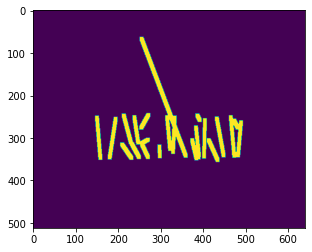

In [ ]:
plt.imshow(t)

In [ ]:
for i in range(640):
    for j in range(512):
        

In [ ]:
print(np.max(im_list[0]))

1.0


In [ ]:
z = np.bitwise_or(im_list[0].astype(np.int).flatten(), im_list[1].astype(np.int).flatten())

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  """Entry point for launching an IPython kernel.


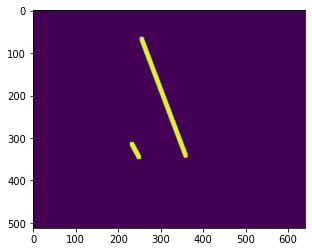

In [ ]:
zz = z.reshape((512,640))
plt.imshow(zz)

(-0.5, 639.5, 511.5, -0.5)

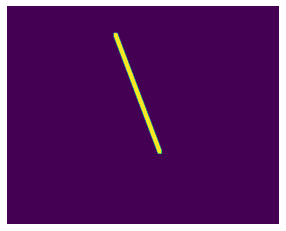

In [ ]:
plt.imshow(im_list[0])
plt.axis('off')

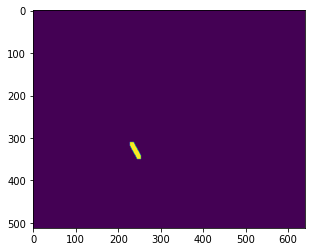

In [ ]:
plt.imshow(im_list[1])

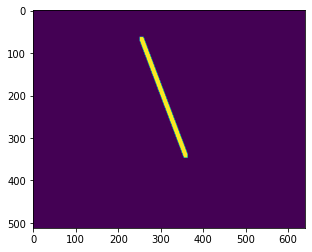

In [ ]:
x = im_list[0].copy()
plt.imshow(x)

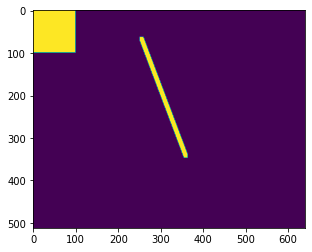

In [ ]:
x[0:100,0:100] = 255
plt.imshow(x)

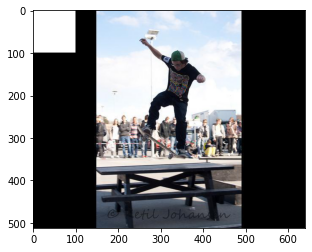

In [ ]:
y = I.copy()
y[0:100,0:100,:]=[255,255,255]
plt.imshow(y)

In [ ]:
print(I.shape)

(512, 640, 3)


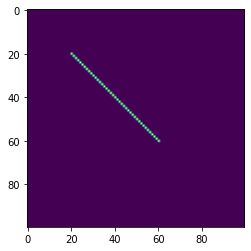

In [ ]:
x = np.zeros((100,100))
p = np.array([[20,20],[60,60]])
cv2.fillPoly(x,[p],[255,255,255])
plt.imshow(x)

In [ ]:
pp = p * np.array([[0.75,0.25],[0.25,0.75]])
pp = pp.astype(np.int)
print(pp)

[[15  5]
 [15 45]]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  


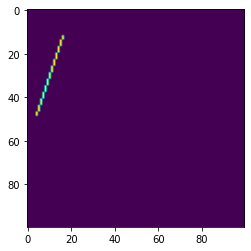

In [ ]:
xx = np.zeros((100,100))
cv2.fillPoly(xx,[pp],[255,255,255])
plt.imshow(xx)

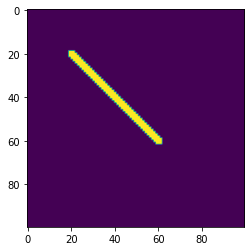

In [ ]:
y = x.copy()
z = cv2.dilate(y,np.ones((3,3)))
plt.imshow(z)

In [ ]:
ct = 0
pic = 0
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
img = ori[0]
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
num = 0   
store = [[0], [0], [0], [0], [0]]
edge = [11, 12, 13, 14, 15]

for i in range(len(anns)):
    # print('1')
    mask = coco_train.annToMask(anns[i])
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    for s in ct:
        # print('2')
        check = np.ones(5) * -1
        if (len(s) < 11):
            continue
        if len(s) < 15: 
            for j in range(len(s), 11):
                idx = e2i(j)
                check[idx] = -2
                store[idx].append(s)
        # print(store[1])
        start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store, 0)
        # start = np.load(r'/gdrive/My Drive/anno/poly/ck_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)[-1]
        # print(start)
        break
        # print(store[1])
        # print(store)
        if len(s) > 15:
            # print('m')
            end, check, store = end_init(s, 1e-12 * cv2.arcLength(s, True), check, store, 0)
        else:
            # print('mm')
            end = 1e-12 * cv2.arcLength(s, True)
        # print(start, end)
        
        num += 1
        if -1 in check:
            check, store,_ = dichotomy(s, start, end, check, store, 0)
        check, store = fix_line(check, store) 
assert(num == len(ct))                 
for i in range(5):
    store[i][0] = num
np.save(r'/gdrive/My Drive/anno//more_poly/polys_{}.npy'.format(img['file_name'][:-4]), store)
np.save(r'/gdrive/My Drive/anno//more_poly/ck_{}.npy'.format(img['file_name'][:-4]), check)
pic += 1
print(pic)
# if pic % 500 == 0 or pic == 2:
#     print(pic,'-----------------------------------------------------')

In [ ]:
x = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
for i in x[:5]:
    y = np.load(r'/gdrive/My Drive/anno/poly_part/poly_p/ck_{}.npy'.format(i['file_name'][:-4]),allow_pickle=True)
    print(y)

[6.08915035 3.89705622 3.89705622 1.85566857 1.50287842 1.26654327
 0.49931033 0.44450798]
[-2. -2. -2. -2. -2. -2. -2. -2.]
[9.77246811 9.77246811 6.77409721 5.77464024 5.18121267 5.18121267
 4.52531904 3.77572631]
[212.42515671 212.42515671 165.79524426  91.18738435  53.88345439
  38.59764334  35.23148941  30.56849816]
[101.29503545  55.7122695   55.7122695   32.92088652  30.25002133
  21.52519503  21.36939456  20.1007336 ]


In [ ]:
ct = 0
pic = 0
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
img = ori[0]
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
num = 0   
store = [[0], [0], [0], [0], [0]]
edge = [11, 12, 13, 14, 15]


mask = coco_train.annToMask(anns[0])
x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

for i in range(len(anns)):
    # print('1')
    mask = coco_train.annToMask(anns[i])
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    for s in ct:
        # print('2')
        check = np.ones(5) * -1
        if (len(s) < 11):
            continue
        if len(s) < 15: 
            for j in range(len(s), 11):
                idx = e2i(j)
                check[idx] = -2
                store[idx].append(s)
        # print(store[1])
        start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store, 0)
        # start = np.load(r'/gdrive/My Drive/anno/poly/ck_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)[-1]
        # print(start)
        break
        # print(store[1])
        # print(store)
        if len(s) > 15:
            # print('m')
            end, check, store = end_init(s, 1e-12 * cv2.arcLength(s, True), check, store, 0)
        else:
            # print('mm')
            end = 1e-12 * cv2.arcLength(s, True)
        # print(start, end)
        
        num += 1
        if -1 in check:
            check, store,_ = dichotomy(s, start, end, check, store, 0)
        check, store = fix_line(check, store) 
# assert(num == len(ct)) 


In [ ]:
print(len(ct[0]))

434


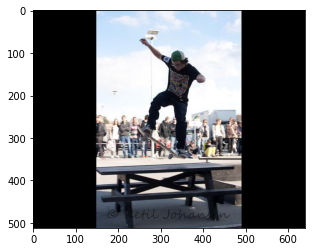

In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
img = ori[0]
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
plt.imshow(I)

In [ ]:
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
num = 0   
store = [[0], [0], [0], [0], [0]]
edge = [11, 12, 13, 14, 15]


mask = coco_train.annToMask(anns[0])
x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

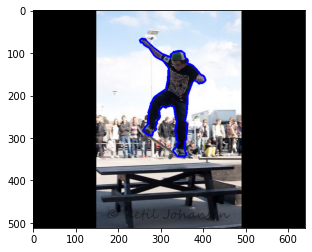

In [ ]:
cv2.drawContours(I, ct, -1, (0,0,255), 3)
plt.imshow(I)

In [ ]:
for i in ct:
  print(len(i))

434


In [ ]:
check = np.ones(5) * -1
start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store, 0)

In [ ]:
end, check, store = end_init(s, 1e-12 * cv2.arcLength(s, True), check, store, 0)

In [ ]:
check, store,_ = dichotomy(s, start, end, check, store, 0)

In [ ]:
print(start)
print(check)
print(store)

In [ ]:
print(end)
print(check)
print(store)

In [ ]:
print(check)
print(store)

In [ ]:
ct = 0
pic = 0
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
img = ori[0]
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
num = 0   
store = [[0], [0], [0], [0], [0]]
edge = [11, 12, 13, 14, 15]

for i in range(len(anns)):
    # print('1')
    mask = coco_train.annToMask(anns[i])
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    for s in ct:
        # print('2')
        check = np.ones(5) * -1
        if (len(s) < 11):
            continue
        if len(s) < 15: 
            for j in range(len(s), 11):
                idx = e2i(j)
                check[idx] = -2
                store[idx].append(s)
        # print(store[1])
        start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store, 0)
        # start = np.load(r'/gdrive/My Drive/anno/poly/ck_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)[-1]
        # print(start)
        # print(store[1])
        # print(store)
        if len(s) > 15:
            # print('m')
            end, check, store = end_init(s, 1e-12 * cv2.arcLength(s, True), check, store, 0)
        else:
            # print('mm')
            end = 1e-12 * cv2.arcLength(s, True)
        # print(start, end)
        
        num += 1
        if -1 in check:
            check, store,_ = dichotomy(s, start, end, check, store, 0)
        check, store = fix_line(check, store) 

assert(num == len(ct))                 
# for i in range(5):
#     store[i][0] = num
# np.save(r'/gdrive/My Drive/anno//more_poly/polys_{}.npy'.format(img['file_name'][:-4]), store)
# np.save(r'/gdrive/My Drive/anno//more_poly/ck_{}.npy'.format(img['file_name'][:-4]), check)
# pic += 1
# print(pic)
# if pic % 500 == 0 or pic == 2:
#     print(pic,'-----------------------------------------------------')

AssertionError: ignored

In [ ]:
ctl=[]
for i in range(len(anns)):
    # print('1')
    mask = coco_train.annToMask(anns[i])
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    print(len(ct))
    ctl.append(ct)

1
2
2
1
1
1
1
1
2
1
1
1
3
5


In [ ]:
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))

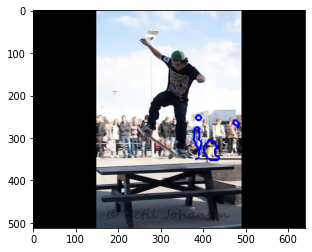

In [ ]:
x = I.copy()
cv2.drawContours(x, ctl[-1], -1, (0,0,255), 3)
plt.imshow(x)

In [ ]:
print(num, len(ct))

22 5


In [ ]:
x = np.load(r'/gdrive/My Drive/anno/add_new.npy', allow_pickle=True)
print(len(x))

15000


In [ ]:
%cd /gdrive/My Drive/files/ref

/gdrive/My Drive/files/ref


In [ ]:
import glob
print(glob.glob(pathname=*))

SyntaxError: ignored

In [ ]:
l = []
path = r'/gdrive/My Drive/anno/train'
for i,img in enumerate(x):
    p = os.path.join(path, img['file_name'])
    if not os.path.exists(p):
        l.append(img['file_name'])
    if i == 1 or i % 200 == 0:
        print(i)

In [ ]:
print(len(l))

700


In [ ]:
np.save(r'/gdrive/My Drive/anno/lost.npy',l)

In [ ]:
dataDir = '/gdrive/My Drive/anno'
coco_train = COCO('{}/instances_train2017.json'.format(dataDir))
catIDs_train = coco_train.getCatIds()
cats_train = coco_train.loadCats(catIDs_train)

loading annotations into memory...
Done (t=29.52s)
creating index...
index created!


In [ ]:
all = np.load(r'/gdrive/My Drive/anno/person_all.npy', allow_pickle=True)
print(len(all))

64115


In [ ]:
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
# ct = 0 
# new = []
# for i in all:
#     if i not in ori:
#         ct += 1
#         new.append(i)
#     if ct == 15000:
#         break
# print(len(new))

In [ ]:
np.save(r'/gdrive/My Drive/anno/add_new.npy', new)

In [ ]:
np.save(r'/gdrive/My Drive/anno/all_new.npy', ori)

In [ ]:
new = np.load(r'/gdrive/My Drive/anno/add_new.npy', allow_pickle=True)
print(len(new))

15000


In [ ]:
ori = list(ori)
ori = ori + new
print(len(ori),ori[0])

23000 {'license': 1, 'file_name': '000000262148.jpg', 'coco_url': 'http://images.cocodataset.org/train2017/000000262148.jpg', 'height': 512, 'width': 640, 'date_captured': '2013-11-20 05:50:03', 'flickr_url': 'http://farm5.staticflickr.com/4028/4549977479_547e6b22ae_z.jpg', 'id': 262148}


In [ ]:
ct = 0
pic = 0
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
for img in ori:
    # I = io.imread(r'/gdrive/My Drive/anno/poly_add2/{}'.format(img['file_name']))
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    # mask = create_poly_1(coco_train, anns, img['height'], img['width'], 0.03)

    # masks = np.zeros((img['height'], img['width'])) 
    num = 0   
    store = [[0], [0], [0], [0], [0]]
    edge = [11, 12, 13, 14, 15]

    for i in range(len(anns)):
        # print('1')
        mask = coco_train.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            # print('2')
            check = np.ones(5) * -1
            if (len(s) < 11):
                for i in range(5):
                    store[i].append(s)
                continue
            if len(s) < 15: 
                for j in range(len(s), 11):
                    idx = e2i(j)
                    check[idx] = -2
                    store[idx].append(s)
            # print(store[1])
            start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store, 0)
            # start = np.load(r'/gdrive/My Drive/anno/poly/ck_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)[-1]
            # print(start)
            break
            # print(store[1])
            # print(store)
            if len(s) > 15:
                # print('m')
                end, check, store = end_init(s, 1e-12 * cv2.arcLength(s, True), check, store, 0)
            else:
                # print('mm')
                end = 1e-12 * cv2.arcLength(s, True)
            # print(start, end)
            
            num += 1
            if -1 in check:
                check, store,_ = dichotomy(s, start, end, check, store, 0)
            check, store = fix_line(check, store)                  
    for i in range(5):
        store[i][0] = num
    np.save(r'/gdrive/My Drive/anno//more_poly/polys_{}.npy'.format(img['file_name'][:-4]), store)
    # np.save(r'/gdrive/My Drive/anno//more_poly/ck_{}.npy'.format(img['file_name'][:-4]), check)
    pic += 1
    if pic % 500 == 0 or pic == 2:
        print(pic,'-----------------------------------------------------')

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


2 -----------------------------------------------------
500 -----------------------------------------------------
1000 -----------------------------------------------------
1500 -----------------------------------------------------
2000 -----------------------------------------------------
2500 -----------------------------------------------------
3000 -----------------------------------------------------
3500 -----------------------------------------------------
4000 -----------------------------------------------------
4500 -----------------------------------------------------
5000 -----------------------------------------------------
5500 -----------------------------------------------------
6000 -----------------------------------------------------
6500 -----------------------------------------------------
7000 -----------------------------------------------------
7500 -----------------------------------------------------
8000 -----------------------------------------------------


In [ ]:
ct = 0
pic = 0
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
for img in ori:
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    num = 0   
    store = [[0], [0], [0], [0], [0]]
    edge = [11, 12, 13, 14, 15]

    for i in range(len(anns)):
        mask = coco_train.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            check = np.ones(5) * -1
            if (len(s) < 11):
                for i in range(5):
                    store[i].append(s)
                continue
            if len(s) < 15: 
                for j in range(len(s), 11):
                    idx = e2i(j)
                    check[idx] = -2
                    store[idx].append(s)
            start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store, 0)

            if len(s) > 15:
                end, check, store = end_init(s, 1e-12 * cv2.arcLength(s, True), check, store, 0)
            else:
                end = 1e-12 * cv2.arcLength(s, True)          
            num += 1
            if -1 in check:
                check, store,_ = dichotomy(s, start, end, check, store, 0)
            check, store = fix_line(check, store) 
    np.save(r'/gdrive/My Drive/anno//more_poly/polys_{}.npy'.format(img['file_name'][:-4]), store)
    # np.save(r'/gdrive/My Drive/anno//more_poly/ck_{}.npy'.format(img['file_name'][:-4]), check)
    pic += 1
    if pic % 500 == 0 or pic == 2:
        print(pic,'-----------------------------------------------------')

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


2 -----------------------------------------------------
500 -----------------------------------------------------
1000 -----------------------------------------------------
1500 -----------------------------------------------------
2000 -----------------------------------------------------
2500 -----------------------------------------------------
3000 -----------------------------------------------------
3500 -----------------------------------------------------
4000 -----------------------------------------------------
4500 -----------------------------------------------------
5000 -----------------------------------------------------
5500 -----------------------------------------------------
6000 -----------------------------------------------------
6500 -----------------------------------------------------
7000 -----------------------------------------------------
7500 -----------------------------------------------------
8000 -----------------------------------------------------


8000


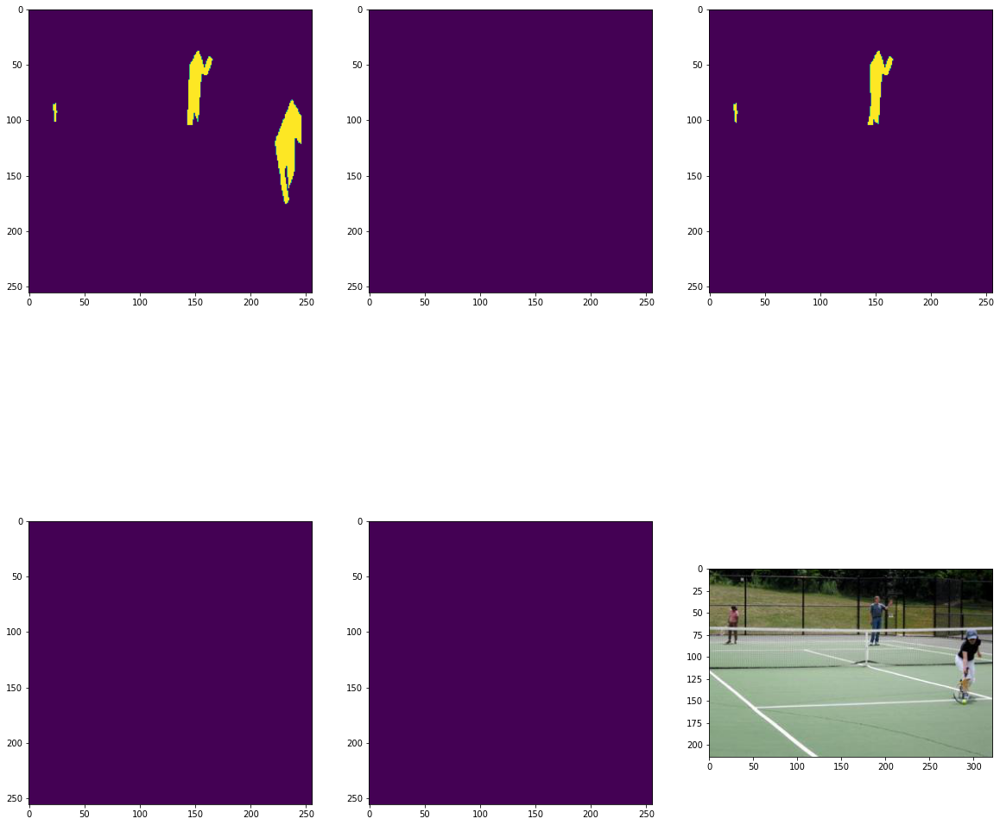

In [ ]:
add = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
print(len(add))
plt.figure(figsize=(20,20))
for i, edge in enumerate(np.arange(11, 16)):
    ct = 0
    # for img in add:
    img = add[5]
    # for img in add:
        # I = io.imread(r'/gdrive/My Drive/anno/add/{}'.format(img['file_name']))
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    ct_list = np.load(r'/gdrive/My Drive/anno/more_poly/polys_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)
    impft_m = np.zeros((img['height'], img['width']))
    # obj_num = ct_list[i][0]
    obj_num = len(ct_list[i])
    # assert(obj_num+1 == len(ct_list[i]))
    for j in range(1, obj_num):
        impft_m = cv2.fillPoly(impft_m, [ct_list[i][j]], (255,255,255))
    mask_temp = np.array(cv2.resize(impft_m,(256,256)))
    mask = np.where(mask_temp<127, 0, 1)
    mask = mask.astype(np.int)
    plt.subplot(2,3,i+1)
    plt.imshow(mask)
    # plt.imshow(mask)

    # np.save(r'/gdrive/My Drive/anno/copy/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
    # np.save(r'/gdrive/My Drive/anno/more_poly/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
plt.subplot(2,3,6)
plt.imshow(I)

In [ ]:
ct = 0
pic = 0
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)

img = ori[5142]
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
num = 0   
store = [[0], [0], [0], [0], [0]]
edge = [11, 12, 13, 14, 15]

for i in range(len(anns)):
    # print('1')
    mask = coco_train.annToMask(anns[i])
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    for s in ct:
        # print('2')
        check = np.ones(5) * -1
        if (len(s) < 11):
            for i in range(5):
                store[i].append(s)
            continue
        if len(s) < 15: 
            for j in range(len(s), 11):
                idx = e2i(j)
                check[idx] = -2
                store[idx].append(s)
        # print(store[1])
        start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store, 0)
        # start = np.load(r'/gdrive/My Drive/anno/poly/ck_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)[-1]
        # print(start)
        # print(store[1])
        # print(store)
        if len(s) > 15:
            # print('m')
            end, check, store = end_init(s, 1e-12 * cv2.arcLength(s, True), check, store, 0)
        else:
            # print('mm')
            end = 1e-12 * cv2.arcLength(s, True)
        # print(start, end)
        
        num += 1
        if -1 in check:
            check, store,_ = dichotomy(s, start, end, check, store, 0)
        check, store = fix_line(check, store) 

In [ ]:
plt.figure(figsize=(20,20))
ct = 0
for img in add:
    ct += 1
    if ct % 500 == 0 or ct == 2:
        print(ct, '-----------------------------------------')
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    ct_list = np.load(r'/gdrive/My Drive/anno/more_poly/polys_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)
    for i, edge in enumerate(np.arange(11, 16)):
        impft_m = np.zeros((img['height'], img['width']))
        # obj_num = ct_list[i][0]
        obj_num = len(ct_list[i])
        # assert(obj_num+1 == len(ct_list[i]))
        for j in range(1, obj_num):
            impft_m = cv2.fillPoly(impft_m, [ct_list[i][j]], (255,255,255))
        mask_temp = np.array(cv2.resize(impft_m,(256,256)))
        mask = np.where(mask_temp<127, 0, 1)
        mask = mask.astype(np.int)
        # plt.subplot(2,3,i+1)
        # plt.imshow(mask)
        # plt.imshow(mask)

        # np.save(r'/gdrive/My Drive/anno/copy/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
        np.save(r'/gdrive/My Drive/anno/more_poly/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)

2 -----------------------------------------
500 -----------------------------------------
1000 -----------------------------------------
1500 -----------------------------------------
2000 -----------------------------------------
2500 -----------------------------------------
3000 -----------------------------------------
3500 -----------------------------------------
4000 -----------------------------------------
4500 -----------------------------------------
5000 -----------------------------------------
5500 -----------------------------------------
6000 -----------------------------------------
6500 -----------------------------------------
7000 -----------------------------------------
7500 -----------------------------------------
8000 -----------------------------------------


<Figure size 1440x1440 with 0 Axes>

In [ ]:
x = ['000000440998', '000000178876', '000000178872']
ii = []
ori = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
for img in ori:
    if img['file_name'][:-4] in x:
        ii.append(img)
        print('x')


x
x
x


In [ ]:
yy = []
for n in x:
    print(n)
    y = np.load(r'/gdrive/My Drive/anno//more_poly/15_fix3/11_{}.npy'.format(n))
    yy.append(y)

000000440998
000000178876
000000178872


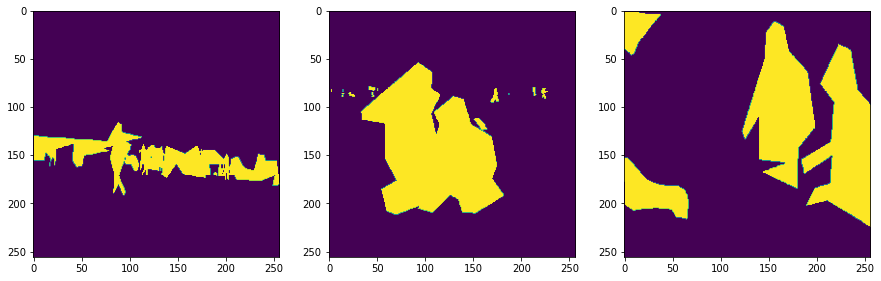

In [ ]:
plt.figure(figsize=(15,15))
plt.subplot(1,3,1)
plt.imshow(yy[0])
plt.subplot(1,3,2)
plt.imshow(yy[1])
plt.subplot(1,3,3)
plt.imshow(yy[2])

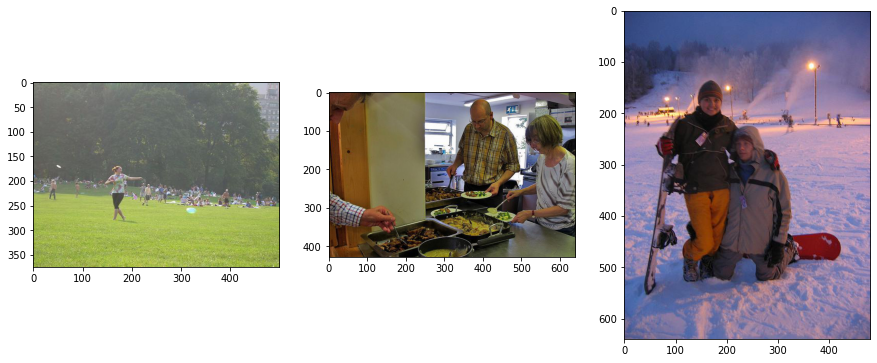

In [ ]:
plt.figure(figsize=(15,15))
plt.subplot(1,3,1)
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(ii[0]['file_name']))
plt.imshow(I)
plt.subplot(1,3,2)
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(ii[1]['file_name']))
plt.imshow(I)
plt.subplot(1,3,3)
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(ii[2]['file_name']))
plt.imshow(I)

In [ ]:
for q in ii:
  print(q['file_name'])

000000440998.jpg
000000178872.jpg
000000178876.jpg


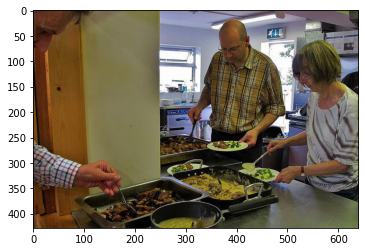

In [ ]:
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(ii[1]['file_name']))
plt.imshow(I)

In [ ]:
ct = 0
pic = 0
for img in ii:
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    num = 0   
    store = [[0], [0], [0], [0], [0]]
    edge = [11, 12, 13, 14, 15]

    for i in range(len(anns)):
        mask = coco_train.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            check = np.ones(5) * -1
            if (len(s) < 11):
                for i in range(5):
                    store[i].append(s)
                continue
            if len(s) < 15: 
                for j in range(len(s), 11):
                    idx = e2i(j)
                    check[idx] = -2
                    store[idx].append(s)
            start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store, 0)

            if len(s) > 15:
                end, check, store = end_init(s, 1e-12 * cv2.arcLength(s, True), check, store, 0)
            else:
                end = 1e-12 * cv2.arcLength(s, True)          
            num += 1
            if -1 in check:
                check, store,_ = dichotomy(s, start, end, check, store, 0)
            check, store = fix_line(check, store) 
    np.save(r'/gdrive/My Drive/anno//more_poly/15_fix3/polys_{}.npy'.format(img['file_name'][:-4]), store)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


In [ ]:
ct = 0
for img in ii:
    ct += 1
    if ct % 500 == 0 or ct == 2:
        print(ct, '-----------------------------------------')
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    ct_list = np.load(r'/gdrive/My Drive/anno/more_poly/15_fix3/polys_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)

    impft_m = np.zeros((img['height'], img['width']))
    # obj_num = ct_list[i][0]
    obj_num = len(ct_list[i])
    # assert(obj_num+1 == len(ct_list[i]))
    for j in range(1, obj_num):
        impft_m = cv2.fillPoly(impft_m, [ct_list[-1][j]], (255,255,255))
    mask_temp = np.array(cv2.resize(impft_m,(256,256)))
    mask = np.where(mask_temp<127, 0, 1)
    mask = mask.astype(np.int)
        # plt.subplot(2,3,i+1)
        # plt.imshow(mask)
        # plt.imshow(mask)

        # np.save(r'/gdrive/My Drive/anno/copy/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
    np.save(r'/gdrive/My Drive/anno/more_poly/15_fix3/{}_{}.npy'.format(edge, img['file_name'][:-4]), mask)

2 -----------------------------------------


In [ ]:
plt.figure(figsize=(20,20))
for i, edge in enumerate(np.arange(11, 16)):
    ct = 0
    # for img in add:
    img = ii[1]
    # for img in add:
        # I = io.imread(r'/gdrive/My Drive/anno/add/{}'.format(img['file_name']))
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    ct_list = np.load(r'/gdrive/My Drive/anno/more_poly/polys_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)
    # ct_list = store
    impft_m = np.zeros((img['height'], img['width']))
    # obj_num = ct_list[i][0]
    obj_num = len(ct_list[i])
    # assert(obj_num+1 == len(ct_list[i]))
    for j in range(1, obj_num):
        impft_m = cv2.fillPoly(impft_m, [ct_list[i][j]], (255,255,255))
    mask_temp = np.array(cv2.resize(impft_m,(256,256)))
    mask = np.where(mask_temp<127, 0, 1)
    mask = mask.astype(np.int)
    plt.subplot(2,3,i+1)
    plt.imshow(mask)
    # plt.imshow(mask)

    # np.save(r'/gdrive/My Drive/anno/copy/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
    # np.save(r'/gdrive/My Drive/anno/more_poly/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
plt.subplot(2,3,6)
plt.imshow(I)

(-0.5, 639.5, 511.5, -0.5)

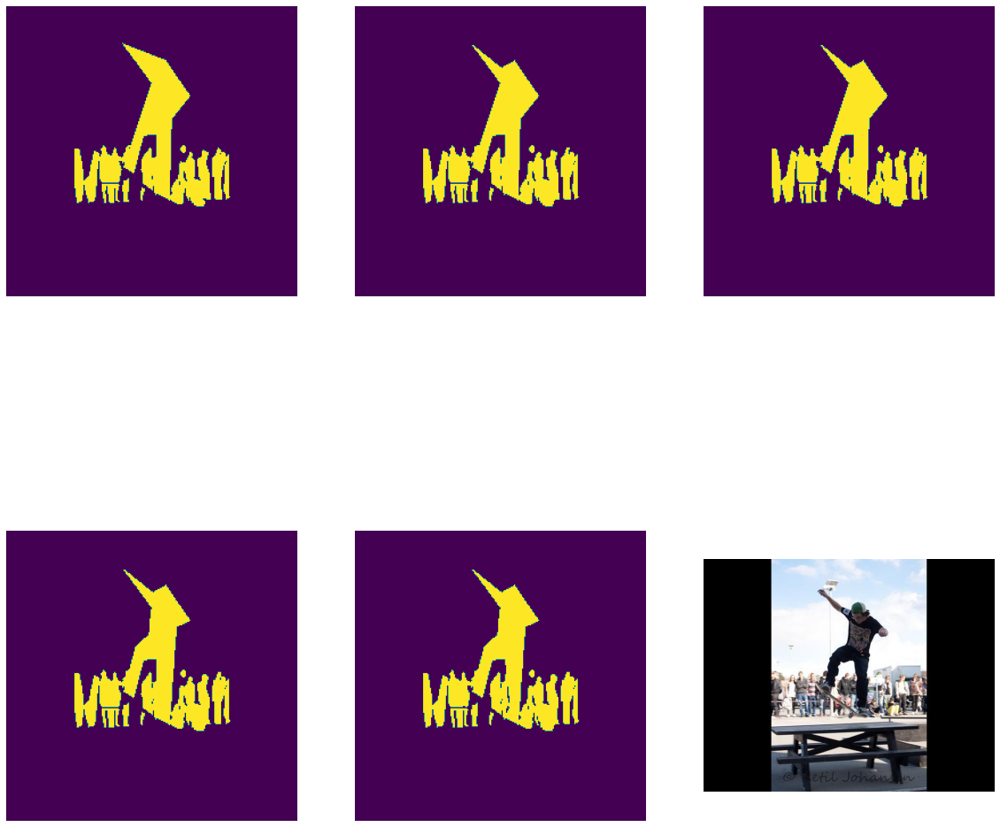

In [ ]:
add = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
# print(len(add))
plt.figure(figsize=(20,20))
for i, edge in enumerate(np.arange(11, 16)):
    ct = 0
    # for img in add:
    img = add[0]
    # for img in add:
        # I = io.imread(r'/gdrive/My Drive/anno/add/{}'.format(img['file_name']))
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    ct_list = np.load(r'/gdrive/My Drive/anno/more_poly/polys_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)
    # ct_list = store
    impft_m = np.zeros((img['height'], img['width']))
    # obj_num = ct_list[i][0]
    obj_num = len(ct_list[i])
    # assert(obj_num+1 == len(ct_list[i]))
    for j in range(1, obj_num):
        impft_m = cv2.fillPoly(impft_m, [ct_list[i][j]], (255,255,255))
    mask_temp = np.array(cv2.resize(impft_m,(256,256)))
    mask = np.where(mask_temp<127, 0, 1)
    mask = mask.astype(np.int)
    plt.subplot(2,3,i+1)
    plt.imshow(mask)
    plt.axis('off')
    # plt.imshow(mask)

    # np.save(r'/gdrive/My Drive/anno/copy/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
    # np.save(r'/gdrive/My Drive/anno/more_poly/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
plt.subplot(2,3,6)
plt.imshow(I)
plt.axis('off')

In [ ]:
add = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
print(len(add))
plt.figure(figsize=(20,20))
for i, edge in enumerate(np.arange(11, 16)):
    ct = 0
    # for img in add:
    img = add[11]
    # for img in add:
        # I = io.imread(r'/gdrive/My Drive/anno/add/{}'.format(img['file_name']))
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    # ct_list = np.load(r'/gdrive/My Drive/anno/more_poly/polys_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)
    ct_list = store
    impft_m = np.zeros((img['height'], img['width']))
    # obj_num = ct_list[i][0]
    obj_num = len(ct_list[i])
    # assert(obj_num+1 == len(ct_list[i]))
    for j in range(1, obj_num):
        impft_m = cv2.fillPoly(impft_m, [ct_list[i][j]], (255,255,255))
    mask_temp = np.array(cv2.resize(impft_m,(256,256)))
    mask = np.where(mask_temp<127, 0, 1)
    mask = mask.astype(np.int)
    plt.subplot(2,3,i+1)
    plt.imshow(mask)
    # plt.imshow(mask)

8000


NameError: ignored

<Figure size 1440x1440 with 0 Axes>

8000


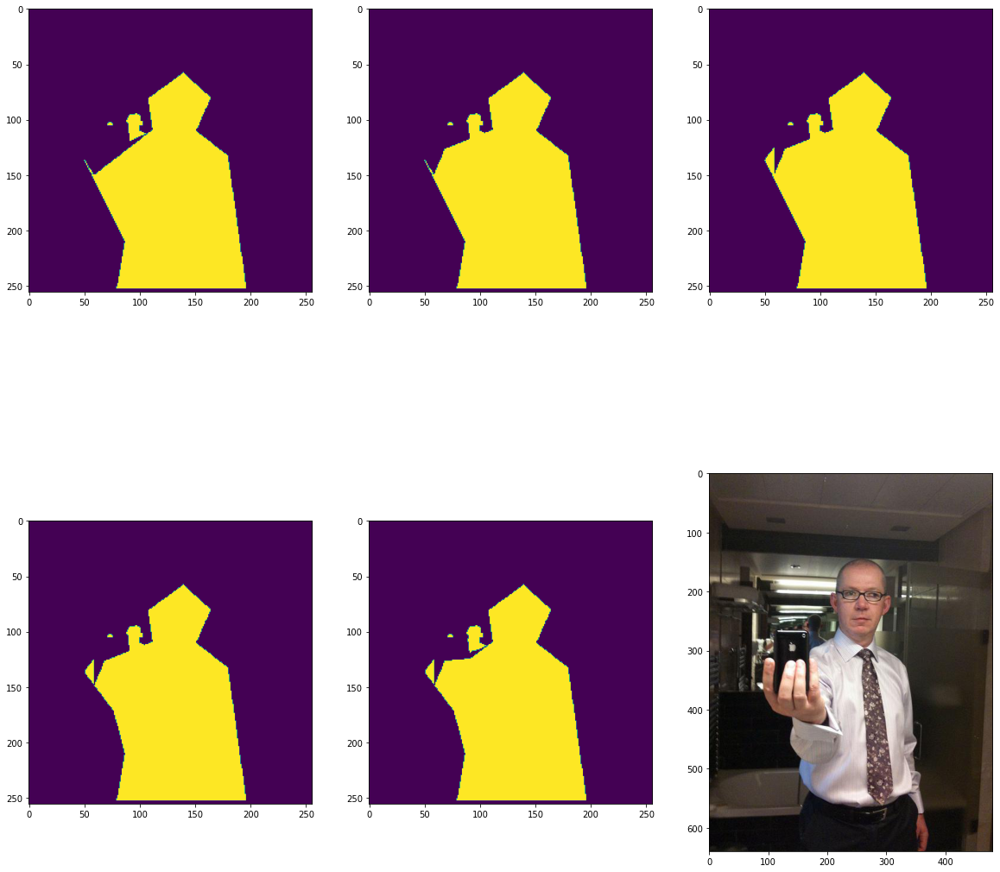

In [ ]:
add = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
print(len(add))
plt.figure(figsize=(20,20))
for i, edge in enumerate(np.arange(11, 16)):
    ct = 0
    # for img in add:
    img = add[7875]
    # for img in add:
        # I = io.imread(r'/gdrive/My Drive/anno/add/{}'.format(img['file_name']))
    mask = np.load(r'/gdrive/My Drive/anno/more_poly/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), allow_pickle=True)
    plt.subplot(2,3,i+1)
    plt.imshow(mask)
    # plt.imshow(mask)

    # np.save(r'/gdrive/My Drive/anno/copy/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
    # np.save(r'/gdrive/My Drive/anno/more_poly/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
plt.subplot(2,3,6)
plt.imshow(I)

In [ ]:
for i in range(5):
    print(len(ct_list[i]))

15
8
5
6
3


8000
2 -----------------------------------------


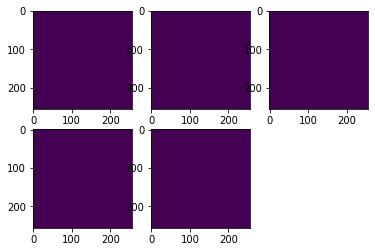

In [ ]:

add = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
print(len(add))
for img in add[1:2]:
    ct = 0
    for i, edge in enumerate(np.arange(11, 16)):
    # for img in add:
        # I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
        annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
        anns = coco_train.loadAnns(annIds)
        ct_list = np.load(r'/gdrive/My Drive/anno/more_poly/polys_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)
        impft_m = np.zeros((img['height'], img['width']))
        obj_num = ct_list[i][0]
        # assert(obj_num+1 == len(ct_list[i]))
        for j in range(1, obj_num):
            impft_m = cv2.fillPoly(impft_m, [ct_list[i][j]], (255,255,255))
        mask_temp = np.array(cv2.resize(impft_m,(256,256)))
        mask = np.where(mask_temp<127, 0, 1)
        mask = mask.astype(np.int)
        plt.subplot(2,3,i+1)
        plt.imshow(mask)

        # np.save(r'/gdrive/My Drive/anno/copy/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
        np.save(r'/gdrive/My Drive/anno/more_poly/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
        ct += 1
        if ct % 500 == 0 or ct == 2:
            print(ct, '-----------------------------------------')





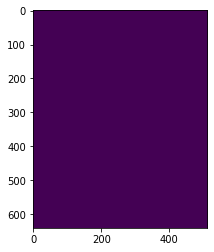

In [ ]:
plt.imshow(impft_m)

In [ ]:
print(ct_list[1][1])

[[[168 222]]

 [[229 395]]

 [[144 461]]

 [[116 637]]

 [[167 578]]

 [[165 639]]

 [[372 637]]

 [[374 585]]

 [[430 636]]

 [[440 534]]

 [[298 395]]

 [[316 228]]]


In [ ]:
test = add[0]
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
ct_list = np.load(r'/gdrive/My Drive/anno/more_poly/polys_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)
impft_m = np.zeros((img['height'], img['width']))
obj_num = ct_list[i][0]

In [ ]:
print(ct_list[0][1].shape)

(11, 1, 2)


In [ ]:
for i in range(1,6):
    print(ct_list[2][i].shape)

(13, 1, 2)
(13, 1, 2)
(13, 1, 2)
(13, 1, 2)


IndexError: ignored

In [ ]:
ct = 0
pic = 0
for img in new:
    # I = io.imread(r'/gdrive/My Drive/anno/poly_add2/{}'.format(img['file_name']))
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    # mask = create_poly_1(coco_train, anns, img['height'], img['width'], 0.03)

    # masks = np.zeros((img['height'], img['width'])) 
    num = 0   
    store = [[0], [0], [0], [0], [0], [0], [0], [0]]
    edge = [3, 4, 5, 6, 7, 8, 9, 10]

    for i in range(len(anns)):
        # print('1')
        mask = coco_train.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            # print('2')
            check = np.ones(8) * -1
            if (len(s) < 3):
                continue
            if len(s) < 10: 
                for j in range(len(s), 11):
                    idx = e2i(j)
                    check[idx] = -2
                    store[idx].append(s)
            # print(store[1])
            start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store, 0)
            # print(store[1])
            # print(store)
            if len(s) > 10:
                # print('m')
                end, check, store = end_init(s, 1e-10 * cv2.arcLength(s, True), check, store, 0)
            else:
                # print('mm')
                end = 1e-10 * cv2.arcLength(s, True)
            # print(start, end)
            
            num += 1
            if -1 in check:
                check, store,_ = dichotomy(s, start, end, check, store, 0)
            check, store = fix_line(check, store)                  
    for i in range(8):
        store[i][0] = num
    np.save(r'/gdrive/My Drive/anno//poly_add_2/polys_{}.npy'.format(img['file_name'][:-4]), store)
    np.save(r'/gdrive/My Drive/anno//poly_add_2/ck_{}.npy'.format(img['file_name'][:-4]), check)
    pic += 1
    if pic % 500 == 0 or pic == 2:
        print(pic,'-----------------------------------------------------')

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


2 -----------------------------------------------------
500 -----------------------------------------------------
1000 -----------------------------------------------------
1500 -----------------------------------------------------
2000 -----------------------------------------------------
2500 -----------------------------------------------------
3000 -----------------------------------------------------
3500 -----------------------------------------------------
4000 -----------------------------------------------------
4500 -----------------------------------------------------
5000 -----------------------------------------------------
5500 -----------------------------------------------------
6000 -----------------------------------------------------
6500 -----------------------------------------------------
7000 -----------------------------------------------------
7500 -----------------------------------------------------
8000 -----------------------------------------------------
8

In [ ]:
toadd = [15000, 4000, 4000, 4000, 2000, 2000, 1000, 1000]
add = np.load(r'/gdrive/My Drive/anno/add_new.npy', allow_pickle=True)
print(len(add))
for i, edge in enumerate(np.arange(3,11)):
    print(edge, toadd[i], '---------------')
    ct = 0
    for img in add[:toadd[i]]:
    # for img in add:
        # I = io.imread(r'/gdrive/My Drive/anno/add/{}'.format(img['file_name']))
        annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
        anns = coco_train.loadAnns(annIds)
        ct_list = np.load(r'/gdrive/My Drive/anno/poly_add_2/polys_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)
        impft_m = np.zeros((img['height'], img['width']))
        obj_num = ct_list[i][0]
        assert(obj_num+1 == len(ct_list[i]))
        for j in range(1, obj_num+1):
            impft_m = cv2.fillPoly(impft_m, [ct_list[i][j]], (255,255,255))
        mask_temp = np.array(cv2.resize(impft_m,(256,256)))
        mask = np.where(mask_temp<127, 0, 1)
        mask = mask.astype(np.int)
        np.save(r'/gdrive/My Drive/anno/copy/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
        np.save(r'/gdrive/My Drive/anno/poly_add_2/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
        ct += 1
        if ct % 500 == 0 or ct == 2:
            print(ct, '-----------------------------------------')

15000
3 15000 ---------------
2 -----------------------------------------
500 -----------------------------------------
1000 -----------------------------------------
1500 -----------------------------------------
2000 -----------------------------------------
2500 -----------------------------------------
3000 -----------------------------------------
3500 -----------------------------------------
4000 -----------------------------------------
4500 -----------------------------------------
5000 -----------------------------------------
5500 -----------------------------------------
6000 -----------------------------------------
6500 -----------------------------------------
7000 -----------------------------------------
7500 -----------------------------------------
8000 -----------------------------------------
8500 -----------------------------------------
9000 -----------------------------------------
9500 -----------------------------------------
10000 ----------------------------

In [ ]:
print(add[:2])

[{'license': 2, 'file_name': '000000262145.jpg', 'coco_url': 'http://images.cocodataset.org/train2017/000000262145.jpg', 'height': 427, 'width': 640, 'date_captured': '2013-11-20 02:07:55', 'flickr_url': 'http://farm8.staticflickr.com/7187/6967031859_5f08387bde_z.jpg', 'id': 262145}
 {'license': 1, 'file_name': '000000262146.jpg', 'coco_url': 'http://images.cocodataset.org/train2017/000000262146.jpg', 'height': 640, 'width': 480, 'date_captured': '2013-11-19 23:07:16', 'flickr_url': 'http://farm6.staticflickr.com/5090/5341741494_1f653cdb80_z.jpg', 'id': 262146}]


In [ ]:
x = np.load(r'/gdrive/My Drive/anno/person_addall2.npy', allow_pickle=True)
name = []
for i in x:
    name.append(i['file_name'][:-4])
path = r'/gdrive/My Drive/anno/copy/3'
file = []
for root, dir, f in os.walk(path):
    for n in f:
        file.append(n[:-6])

In [ ]:
y  = np.load(r'/gdrive/My Drive/anno/person_add.npy', allow_pickle=True)

In [ ]:
x = np.load(r'/gdrive/My Drive/anno/person_addall2.npy', allow_pickle=True)[:8258]
name = []
for i in x:
    name.append(i['file_name'][:-4])
path = r'/gdrive/My Drive/anno/copy/6'
file = []
for root, dir, f in os.walk(path):
    for n in f:
        file.append(n[:-6])
for i in name:
    if i not in file:
        print(i) 

In [ ]:
print(x[-1])

{'license': 6, 'file_name': '000000526028.jpg', 'coco_url': 'http://images.cocodataset.org/train2017/000000526028.jpg', 'height': 480, 'width': 640, 'date_captured': '2013-11-19 22:44:45', 'flickr_url': 'http://farm5.staticflickr.com/4056/5153115615_4fba458814_z.jpg', 'id': 526028}


In [ ]:
for i in name:
    if i not in file:
        print(i) 

In [ ]:
added = [1481,   828,   258, 0, 0, 0 ]
toadd = [2370, 2206, 2064,2000, 2000, 1143]
add = np.load(r'/gdrive/My Drive/anno/person_add.npy', allow_pickle=True)
print(len(add))
for i, edge in enumerate(np.arange(4,10)):
    print(edge, 8000+added[i]+toadd[i], '---------------')
    ct = 0
    for img in add[added[i]:added[i]+toadd[i]]:
    # for img in add:
        I = io.imread(r'/gdrive/My Drive/anno/add/{}'.format(img['file_name']))
        annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
        anns = coco_train.loadAnns(annIds)
        ct_list = np.load(r'/gdrive/My Drive/anno/poly_add/polys_{}.npy'.format(img['file_name'][:-4]), allow_pickle=True)
        impft_m = np.zeros((I.shape[0], I.shape[1]))
        obj_num = ct_list[i][0]
        assert(obj_num+1 == len(ct_list[i]))
        for j in range(1, obj_num+1):
            impft_m = cv2.fillPoly(impft_m, [ct_list[i][j]], (255,255,255))
        mask_temp = np.array(cv2.resize(impft_m,(256,256)))
        mask = np.where(mask_temp<127, 0, 1)
        mask = mask.astype(np.int)
        np.save(r'/gdrive/My Drive/anno/copy/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
        np.save(r'/gdrive/My Drive/anno/poly_mask_add/{}/{}_{}.npy'.format(edge, img['file_name'][:-4], edge), mask)
        ct += 1
        if ct % 500 == 0 or ct == 2:
            print(ct, '-----------------------------------------')

9067
4 11851 ---------------
2 -----------------------------------------
500 -----------------------------------------
1000 -----------------------------------------
1500 -----------------------------------------
2000 -----------------------------------------
5 11034 ---------------
2 -----------------------------------------
500 -----------------------------------------
1000 -----------------------------------------
1500 -----------------------------------------
2000 -----------------------------------------
6 10322 ---------------
2 -----------------------------------------
500 -----------------------------------------
1000 -----------------------------------------
1500 -----------------------------------------
2000 -----------------------------------------
7 10000 ---------------
2 -----------------------------------------
500 -----------------------------------------
1000 -----------------------------------------
1500 -----------------------------------------
2000 -----------------

In [ ]:
import shutil
root = r'/gdrive/My Drive/anno/add'
des =  r'/gdrive/My Drive/anno/train'
ct = 0

for img in add:
    f = img['file_name']
    shutil.copy(os.path.join(root, f), os.path.join(des, f))
    ct += 1
    if ct % 100 == 0 or ct == 1:
        print(ct)


1
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000


In [ ]:
root = r'/gdrive/My Drive/anno/poly_mask_add'
des =  r'/gdrive/My Drive/anno/train_poly'
ct = 0

for img in add:
    for i in range(3,7):
        f = img['file_name'][:-4]+'_'+str(i)+'.npy'
        shutil.copy(os.path.join(root, str(i), f), os.path.join(des, f))
    ct += 1
    if ct % 100 == 0 or ct == 1:
        print(ct)

In [ ]:
root = r'/gdrive/My Drive/anno/poly_mask_add'
des =  r'/gdrive/My Drive/anno/train_poly'
ct = 0
addnum = [ 9067,  1481,   828,   258 ]

for j,i in enumerate(range(3,7)):
    print(i,addnum[j],'*******************')
    for ct, img in enumerate(add[:addnum[j]]):
        f = img['file_name'][:-4]+'_'+str(i)+'.npy'
        shutil.copy(os.path.join(root, str(i), f), os.path.join(des, f))
        if ct == 0 or ct % 300 == 0:
            print(ct)


3 9067 *******************


In [ ]:
tr = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
tr2 = np.load(r'/gdrive/My Drive/anno/person_add.npy', allow_pickle=True)
tr3 = np.array(list(tr) + list(tr2))
np.save(r'/gdrive/My Drive/anno/person_addall2.npy', tr3)



# for i in range(15):
#     img = tr[i]
#     I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
#     io.imsave(r'/gdrive/My Drive/anno/draw/{}'.format(img['file_name']), I)

In [ ]:
c = 0
for i in tr:
    if i not in tr2:
        c+=1
print(c)

0


In [ ]:
print(add)

[{'license': 2, 'file_name': '000000262145.jpg', 'coco_url': 'http://images.cocodataset.org/train2017/000000262145.jpg', 'height': 427, 'width': 640, 'date_captured': '2013-11-20 02:07:55', 'flickr_url': 'http://farm8.staticflickr.com/7187/6967031859_5f08387bde_z.jpg', 'id': 262145}
 {'license': 1, 'file_name': '000000262146.jpg', 'coco_url': 'http://images.cocodataset.org/train2017/000000262146.jpg', 'height': 640, 'width': 480, 'date_captured': '2013-11-19 23:07:16', 'flickr_url': 'http://farm6.staticflickr.com/5090/5341741494_1f653cdb80_z.jpg', 'id': 262146}
 {'license': 3, 'file_name': '000000524291.jpg', 'coco_url': 'http://images.cocodataset.org/train2017/000000524291.jpg', 'height': 426, 'width': 640, 'date_captured': '2013-11-18 09:59:07', 'flickr_url': 'http://farm2.staticflickr.com/1045/934293170_d1b2cc58ff_z.jpg', 'id': 524291}
 ...
 {'license': 3, 'file_name': '000000149912.jpg', 'coco_url': 'http://images.cocodataset.org/train2017/000000149912.jpg', 'height': 640, 'width':

In [ ]:
print(len(tr2))

64115


In [ ]:
tr3 = tr2[:12000]


In [ ]:
ori=np.array([17067,9481,8828,8258,8000,8000,7314,6400,4741])
add=ori-8000
print(add)

[ 9067  1481   828   258     0     0  -686 -1600 -3259]


In [ ]:
tra = trn[:9067]
np.save(r'/gdrive/My Drive/anno/person_add.npy', tra)

In [ ]:
traa = tra.copy()
print(len(traa))
traa = traa + list(tr)
print(len(traa))

9067
17067


In [ ]:
np.save(r'/gdrive/My Drive/anno/person_addall.npy', traa)

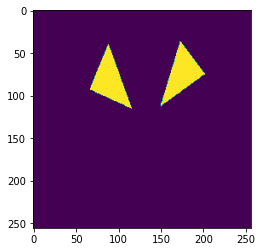

In [ ]:
img = tr[2031]
x = np.load(r'/gdrive/My Drive/anno/train_poly/{}_{}.npy'.format(img['file_name'], 3), allow_pickle=True)
plt.imshow(x)

In [ ]:
def linear_search(s, start, end, check, store):
    i = np.linspace(start, end, 20)
    for r in i:
        approx = cv2.approxPolyDP(s, r, True)
        edge = len(approx)
        idx = e2i(edge)
        if idx == -1:
            continue
        if check[idx] == -1:
            # print(r, edge, idx)
            check[idx] = r
            store[idx].append(approx)
    return check, store

def dichotomy_init(s, start, end, s_init, check, store, ct):
    mid = (start + end) * 0.5
    approx = cv2.approxPolyDP(s, mid, True)
    ct += 1
    if ct >= 900:
        if s_init:
            if check[0] == -1:
                check[0] = mid
                store[0].append(approx)
                #print('stuck in start 2')
        else:
            if check[7] == -1:
                check[7] = mid
                store[7].append(approx)
                #print('stuck in end 2')

        return start, check, store
    edge = len(approx)
    if s_init:
        if edge == 3:
            if check[0] == -1:
                check[0] = mid
                store[0].append(approx)
            return mid, check, store
        elif edge < 3:
            return dichotomy_init(s, mid, end, 1, check, store, ct)
        else:
            if edge <= 10:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = mid
                    store[idx].append(approx)
            return dichotomy_init(s, start, mid, 1, check, store, ct)
    else:
        if edge == 10:
            if check[7] == -1:
                check[7] = mid
                store[7].append(approx)
            return mid, check, store
        elif edge > 10:
            return dichotomy_init(s, start, mid, 0, check, store, ct)
        else:
            if edge >= 3:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = mid
                    store[idx].append(approx)
            return dichotomy_init(s, mid, end, 0, check, store, ct)

def start_init(s, start, check, store, ct):
    approx = cv2.approxPolyDP(s, start, True)
    edge = len(approx)
    if edge == 3:
        if check[0] == -1:
            check[0] = start
            store[0].append(approx)
        return start, check, store
    else: 
        ct += 1
        if ct >= 900:
            check[0] = start
            store[0].append(approx)
            #print('stuck in start 1')
            return start, check, store
        if edge < 3:
            return start_init(s, 0.1*start, check, store, ct)
        else:
            if edge <= 10:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = start
                    store[idx].append(approx)
            return dichotomy_init(s, start * 10, start, 1, check, store, ct)

def end_init(s, end, check, store, ct):
    approx = cv2.approxPolyDP(s, end, True)
    edge = len(approx)
    if edge == 10:
        if check[7] == -1:
            check[7] = end
            store[7].append(approx)
        return end, check, store
    else: 
        ct += 1
        if ct >= 900:
            check[7] = end
            store[7].append(approx)
            #print('stuck in end 1')
            return end, check, store
        if edge > 10:
            return end_init(s, 10*end, check, store, ct)
        else:
            if edge >= 3:
                idx = e2i(edge)
                if check[idx] == -1:
                    check[idx] = end
                    store[idx].append(approx)
            return dichotomy_init(s, end, end*0.1, 0, check, store, ct)

# def end_init(s, end):
#     approx = cv2.approxPolyDP(s, end, True)
#     edge = len(approx)
#     if edge > 10:
#         return end_init(s, 4*end)
#     else:
#         return end * 0.25

def dichotomy(s, start, end, check, store, ct):
    ct += 1
    if ct >= 900:
        check, store = fill_hole(check, store)
        #print('stuck in hole')
        return check, store, 0
    mid = (start + end) * 0.5
    approx = cv2.approxPolyDP(s, mid, True)
    edge = len(approx)
    # print('-----------')
    # print(edge)
    # print(check)
    # print(mid)
    if edge >= 3 and edge <= 10:
        idx = e2i(edge)
        if check[idx] == -1:
            check[idx] = mid
            store[idx].append(approx)
        if -1 in check[idx:]:
            check, store, ct = dichotomy(s, mid, end, check, store, ct)
        if -1 in check[:idx]:
            check, store, ct = dichotomy(s, start, mid, check, store, ct)
    elif edge < 3:
        check, store, ct = dichotomy(s, mid, end, check, store, ct)
    else:
        check, store, ct = dichotomy(s, start, mid, check, store, ct)
        
    return check, store, ct

def fill_hole(check, store):
    if check[0] != -1:
        for i in range(8):
            if check[i] == -1:
                check[i] = check[i-1]
                store[i].append(store[i-1][-1])
    elif check[7] != -1:
        for i in range(8):
            if check[7-i] == -1:
                check[7-i] = check[8-i]
                store[7-1].append(store[8-i][-1])
    else:
        print('cannt fill hole')
    return check, store

def fix_line(check, store):
    if len(store[7][-1]) == 2:
        print('fail sh')
    for i in range(7):
        if len(store[6-i][-1]) == 2:
            check[6-i] = check[7-i]
            store[6-i][-1] = store[7-1][-1]
        
    return check, store
        
def e2i(x):
  if x in [3, 4, 5, 6, 7, 8, 9, 10]:
      return x-3
  else:
      print('xx')
      return -1

def draw_poly(mask, pts):
    cv2 .fillPoly(mask,[pts],(255,255,255))
    return mask

In [ ]:
tr = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
ct = 0
img = tr[1]
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
mask = create_poly_1(coco_train, anns, img['height'], img['width'], 0.03)

# masks = np.zeros((img['height'], img['width'])) 
num = 0   
store = [[0], [0], [0], [0], [0], [0], [0], [0]]
edge = [3, 4, 5, 6, 7, 8, 9, 10]

for i in range(len(anns)):
    # print('1')
    mask = coco_train.annToMask(anns[i])
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    for s in ct:
        # print('2')
        check = np.ones(8) * -1
        if len(s) < 3:
            continue
        if len(s) < 10: 
            for j in range(len(s), 11):
                idx = e2i(j)
                check[idx] = -2
                store[idx].append(s)
        # print(store[1])
        start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store, 0)
        # print(store[1])
        # print(store)
        if len(s) > 10:
            # print('m')
            end, check, store = end_init(s, 1e-10 * cv2.arcLength(s, True), check, store, 0)
        else:
            # print('mm')
            end = 1e-10 * cv2.arcLength(s, True)
        # print(start, end)
        
        num += 1
        if -1 in check:
            check, store,_ = dichotomy(s, start, end, check, store, 0)
        check, store = fix_line(check, store)                  
for i in range(8):
    store[i][0] = num




stuck in hole
stuck in start 2


In [ ]:
np.save(r'/gdrive/My Drive/anno//poly/polys_{}.npy'.format(img['file_name'][:-4]), store)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


In [ ]:
print(img['file_name'][:-4])

000000262175


In [ ]:
tr = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
ct = 0
pic = 0
for img in tr:
    I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    mask = create_poly_1(coco_train, anns, img['height'], img['width'], 0.03)

    # masks = np.zeros((img['height'], img['width'])) 
    num = 0   
    store = [[0], [0], [0], [0], [0], [0], [0], [0]]
    edge = [3, 4, 5, 6, 7, 8, 9, 10]

    for i in range(len(anns)):
        # print('1')
        mask = coco_train.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            # print('2')
            check = np.ones(8) * -1
            if (len(s) < 3):
                continue
            if len(s) < 10: 
                for j in range(len(s), 11):
                    idx = e2i(j)
                    check[idx] = -2
                    store[idx].append(s)
            # print(store[1])
            start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store, 0)
            # print(store[1])
            # print(store)
            if len(s) > 10:
                # print('m')
                end, check, store = end_init(s, 1e-10 * cv2.arcLength(s, True), check, store, 0)
            else:
                # print('mm')
                end = 1e-10 * cv2.arcLength(s, True)
            # print(start, end)
            
            num += 1
            if -1 in check:
                check, store,_ = dichotomy(s, start, end, check, store, 0)
            check, store = fix_line(check, store)                  
    for i in range(8):
        store[i][0] = num
    np.save(r'/gdrive/My Drive/anno//poly/polys_{}.npy'.format(img['file_name'][:-4]), store)
    np.save(r'/gdrive/My Drive/anno//poly/ck_{}.npy'.format(img['file_name'][:-4]), check)
    pic += 1
    if pic % 20 == 0:
        print(pic,'-----------------------------------------------------')





/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


20 -----------------------------------------------------
40 -----------------------------------------------------
60 -----------------------------------------------------
80 -----------------------------------------------------
100 -----------------------------------------------------
120 -----------------------------------------------------
140 -----------------------------------------------------
160 -----------------------------------------------------
180 -----------------------------------------------------
200 -----------------------------------------------------
220 -----------------------------------------------------
240 -----------------------------------------------------
260 -----------------------------------------------------
280 -----------------------------------------------------
300 -----------------------------------------------------
320 -----------------------------------------------------
340 -----------------------------------------------------
360 --------------

In [ ]:
print(check)
print(store)

[-2. -2. -2. -2. -2. -2. -2. -2.]
[[1, array([[[221, 245]],

       [[222, 244]],

       [[223, 245]],

       [[222, 246]]], dtype=int32)], [1, array([[[221, 245]],

       [[222, 244]],

       [[223, 245]],

       [[222, 246]]], dtype=int32)], [1, array([[[221, 245]],

       [[222, 244]],

       [[223, 245]],

       [[222, 246]]], dtype=int32)], [1, array([[[221, 245]],

       [[222, 244]],

       [[223, 245]],

       [[222, 246]]], dtype=int32)], [1, array([[[221, 245]],

       [[222, 244]],

       [[223, 245]],

       [[222, 246]]], dtype=int32)], [1, array([[[221, 245]],

       [[222, 244]],

       [[223, 245]],

       [[222, 246]]], dtype=int32)], [1, array([[[221, 245]],

       [[222, 244]],

       [[223, 245]],

       [[222, 246]]], dtype=int32)], [1, array([[[221, 245]],

       [[222, 244]],

       [[223, 245]],

       [[222, 246]]], dtype=int32)]]


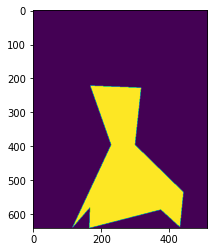

In [ ]:
masks = np.zeros((img['height'], img['width']))
plt.imshow(draw_poly(masks, store[7][1]))

In [ ]:
for i in range(8):
  print(len(store[i]), len(store[i][1]), len(store[i][2]))

3 3 4
3 4 4
3 5 4
3 6 4
3 6 4
3 8 4
3 9 4
3 10 4


In [ ]:
for i in range(8):
  if len(store[i]) == 1:
      print('x')
  else:
      print(len(store[i][1]))

3
4
5
x
x
x
9
x


In [ ]:
print((store[1]))

[1, array([[[221, 245]],

       [[222, 244]],

       [[223, 245]],

       [[222, 246]]], dtype=int32)]


In [ ]:
print(store[7][-1])
print(len(store[7][-1]))

[[[221 245]]

 [[222 244]]

 [[223 245]]

 [[222 246]]]
4


In [ ]:
start = 139
end = 13
mid = (start+end)*0.5
approx = cv2.approxPolyDP(s, mid, True)
edge = len(approx)
print(mid, edge)

76.0 5


In [ ]:
print(approx_1.shape)
print(len(approx_1))
print(approx_1)

(4, 1, 2)
4
[[[221 245]]

 [[222 244]]

 [[223 245]]

 [[222 246]]]


In [ ]:
c = np.linspace(1,20,20)
print(c)
print( 15 in c[20:])
print(3 in c[: 0])

[ 1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17. 18.
 19. 20.]
False
False


In [ ]:
store = [[0], [0], [0], [0], [0], [0]]
x = list(np.zeros((2,2,2)))
store[0].append(x)
print(store)
print(store[0])

[[0, [array([[0., 0.],
       [0., 0.]]), array([[0., 0.],
       [0., 0.]])]], [0], [0], [0], [0], [0]]
[0, [array([[0., 0.],
       [0., 0.]]), array([[0., 0.],
       [0., 0.]])]]


In [ ]:
tr = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
ct = 0
img = tr[1]
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
mask = create_poly_1(coco_train, anns, img['height'], img['width'], 0.03)

# masks = np.zeros((img['height'], img['width'])) 
num = 0   
store = [[0], [0], [0], [0], [0], [0], [0], [0]]
edge = [3, 4, 5, 6, 7, 8, 9, 10]

for i in range(len(anns)):
    mask = coco_train.annToMask(anns[i])
    x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
    ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    for s in ct:
        start, check, store = start_init(s, 1 * cv2.arcLength(s, True), check, store)
        end, check, store = end_init(s, 1e-10 * cv2.arcLength(s, True), check, store)
        print(start, end)
        break
#         # approx = cv2.approxPolyDP(s, start, True)
#         num += 1
#         check = np.ones(8) * -1
#         assert(len(s) >= 3)
#         if len(s) < 10: 
#             for j in range(len(s), 11):
#                 idx = e2i(j)
#                 check[idx] = -2
#                 store[idx].append(s)
#         # check, store = dichotomy(s, start, end, check, store)
#         print(check)
#         # for k in range(8):
#         #     if check[k] == -1:
#         #         if k == 0:
                    

# for i in range(8):
#     store[i][0] = num
    # s_0 = ct[0]
    # approx_0 = cv2.approxPolyDP(s_0, 0.8, True)
    # mask_0 = mask.copy()
    # cv2 .fillPoly(mask_0,[approx_0],(255,0,0))
    # s_1 = ct[1]
    # approx_1 = cv2.approxPolyDP(s_1, 0.8, True)
    # print(approx_1)
    # mask_1 = mask.copy()
    # cv2 .fillPoly(mask_1,[approx_1],(255,0,0))
# plt.imshow(mask_1)



[[[221 245]]

 [[222 244]]

 [[223 245]]

 [[222 246]]]


In [ ]:
x[0]=10
print(x)

[10, [array([[0., 0.],
       [0., 0.]]), array([[0., 0.],
       [0., 0.]])]]


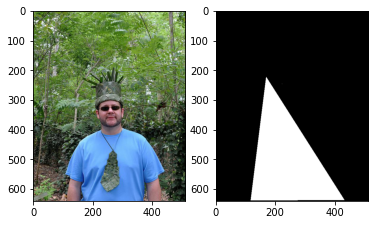

In [ ]:
img = tr[1]
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
plt.subplot(1,2,1)
plt.imshow(I)
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
mask = create_poly_2(coco_train, anns, img['height'], img['width'], 207)
plt.subplot(1,2,2)
plt.imshow(mask)

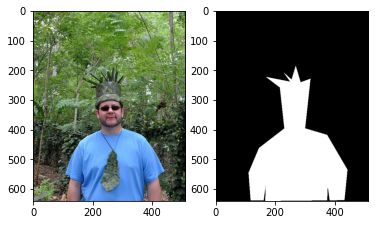

In [ ]:
img = tr[1]
I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
plt.subplot(1,2,1)
plt.imshow(I)
annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
anns = coco_train.loadAnns(annIds)
mask = create_poly_1(coco_train, anns, img['height'], img['width'], 0.01)
plt.subplot(1,2,2)
plt.imshow(mask)

In [ ]:
tr = np.load(r'/gdrive/My Drive/anno/person.npy', allow_pickle=True)
ct = 0
for img in tr:
    I = io.imread(r'/gdrive/My Drive/anno/train/{}'.format(img['file_name']))
    annIds = coco_train.getAnnIds(imgIds=img['id'], catIds=[1], iscrowd=None)
    anns = coco_train.loadAnns(annIds)
    mask = create_poly_1(coco_train, anns, img['height'], img['width'], 0.03)

    masks = np.zeros((height, width)) 
    num = len(anns)   
    print(num)
    for i in range(num):
        mask = coco.annToMask(anns[i])
        x = cv2.cvtColor(mask.astype(np.uint8), cv2.COLOR_RGB2BGR)
        gray = cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)
        ret, bin = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
        ct, h = cv2.findContours(bin, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for s in ct:
            approx = cv2.approxPolyDP(s, 0.8, True)
            print(approx)
    break

NameError: ignored

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

In [ ]:
def qwer(pts):
    a1, b1, a2, b2 = pts[0,0], pts[0,1], pts[1,0], pts[1,1]
    x = np.linspace(a1,a2,1000)
    y = (b1-b2)/(pts[0,0]-a2)*(x-a2)+b2
    plt.plot(x,y)
    i = np.linspace(-(a1+a2)/2, (a1+a2)/2, 1000)
    j = np.sin(i)
    hypo = np.sqrt((a1-a2)**2+(b1-b2)**2)
    cos = (a2-a1)/hypo
    sin = (b2-b1)/hypo
    matrix = np.array([[cos,-sin],[sin,cos]])
    z = np.dot(matrix,np.vstack((i,j)))
    plt.plot(z[0]+(a1+a2)/2,z[1]+(b1+b2)/2)
    return z

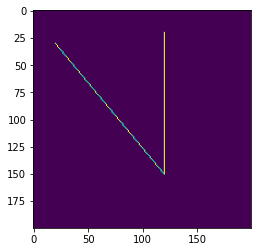

In [ ]:
x = np.zeros((200, 200))
y = np.array([[20,30], [120, 150], [120, 20]])
cv2.polylines(x, [y], 0, 1, 1)
plt.imshow(x)

In [ ]:
def qwer(pts):
    a1, b1, a2, b2 = pts[0,0], pts[0,1], pts[1,0], pts[1,1]
    print(a1,a2,b1,b2)
    x = np.linspace(a1,a2,1000)
    print(x[0],x[-1])
    y = (b1-b2)/(a1-a2)*(x-a2)+b2
    print(y[0],y[-1])
    plt.plot(x,y)
    hypo = np.sqrt((a1-a2)**2+(b1-b2)**2)
    i = np.linspace(-hypo/2, hypo/2, 1000)
    j = 10*np.sin(33/hypo*i)
    plt.plot(i,j)
    
    cos = (a2-a1)/hypo
    sin = (b2-b1)/hypo

    matrix = np.array([[cos,-sin],[sin,cos]])
    z = np.dot(matrix,np.vstack((i,j)))
    plt.plot(z[0]+(a1+a2)/2,z[1]+(b1+b2)/2)
    plt.plot(x,y)
    anno = np.vstack((z[0]+(a1+a2)/2,z[1]+(b1+b2)/2))
    return anno.T.astype(int)

255 359 67 342
255.0 359.0
67.0 342.0
(1000, 2)


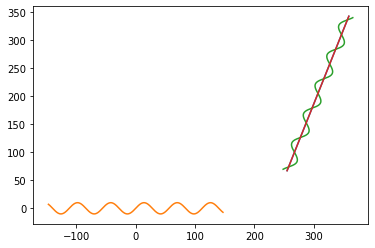

In [ ]:
z = qwer(np.array([[255,67], [359, 342]]))
print(z.shape)

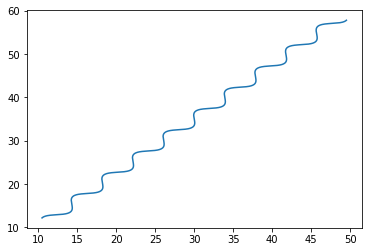

In [ ]:
plt.plot(z)

In [ ]:
x = np.linspace(20, 120, 1000)
y = (30-150)/(20-120)*(x-120)+150

In [ ]:
qqq=np.array([[10,10],[20,20],[10,20]])
print(qqq.shape)

(3, 2)


In [ ]:
print(qqq)
zt = z.T.astype('int')
print(zt.shape)
print(z.T[:3])

[[10 10]
 [20 20]
 [10 20]]
(1000, 2)
[[10.4876255  12.19115418]
 [10.51930593 12.24272424]
 [10.55378963 12.29205169]]


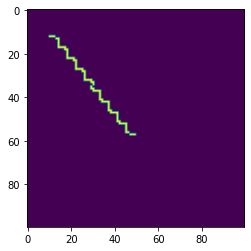

In [ ]:
x = np.zeros((100,100))
cv2.polylines(x, [zt], 0, 1, 1)
plt.imshow(x)

In [ ]:
q=np.ones(5)
qq=q*2
qqq=q*3
print(np.vstack((q,qq,qqq)))

[[1. 1. 1. 1. 1.]
 [2. 2. 2. 2. 2.]
 [3. 3. 3. 3. 3.]]


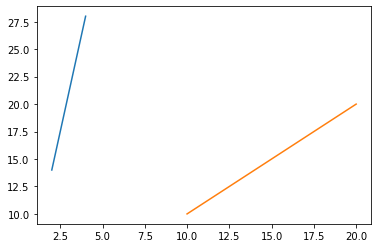

In [ ]:
x = np.linspace(10,20,10)
y = x
z = np.dot(np.array([[0.8,-0.6],[0.6,0.8]]),np.vstack((x,y)))
plt.plot(z[0],z[1])
plt.plot(x,y)

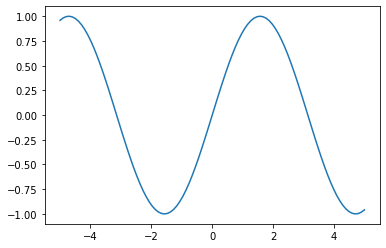

In [ ]:
x=np.linspace(-5,5,100)
y=np.sin(x)
plt.plot(x,y)